In [1]:
from conf import databases, url, data_dir

In [2]:
import wfdb
import numpy
import json
import os
import glob
import random
import time

In [3]:
import lasagne
from matplotlib import pyplot as plt
import matplotlib as mpl

Using cuDNN version 5110 on context None
Mapped name None to device cuda: GeForce GTX 1050 Ti (0000:01:00.0)


In [4]:
def mkdir_p(path):
    try:
        os.makedirs(path)
    except OSError as exc:
        pass

In [ ]:
def normalize(x, lb=0, ub=1):
    mid = ub - (ub - lb) / 2
    min_v = numpy.min(x)
    max_v = numpy.max(x)
    mid_v =  max_v - (max_v - min_v) / 2
    coef = (ub - lb) / (max_v - min_v)
    return x * coef - (mid_v * coef) + mid
    
for db, ids in databases:
    for i in ids:
        f = data_dir + db + '/' + i
        if os.path.isfile(f + '.normalized.dnn.npz'):
            continue
        print(f, end='')
        sig, fields = wfdb.srdsamp(f)
        ann = wfdb.rdann(f, 'atr')
        if not numpy.array_equal(ann.chan, numpy.full(len(ann.chan), ann.chan[0])):
            print(' Not good...')
            continue
        x = normalize(sig[:, ann.chan[0]])
        y = numpy.zeros(len(x))
        for v in ann.annsamp:
            y[v] = 1
        numpy.savez_compressed(f + '.normalized.dnn.npz', numpy.asarray([x, y]))
        print()

In [5]:
# NN params
segment_size = 5000
segment_step = 2500
y_delay = 0

train_perc = 90
test_perc = 100 - train_perc

In [6]:
def load_fnpz(filepath):
    xy = numpy.load(f, mmap_mode='r', allow_pickle=True)['arr_0']
    return xy[0,:], xy[1,:]

# Load data
XY_file = data_dir + 'mitdb/XY_delay{}-{}-{}.normalized.dnn.npz'.format(y_delay, segment_size, segment_step)
if os.path.isfile(XY_file):
    XY = numpy.load(XY_file, mmap_mode='r', allow_pickle=True)['arr_0']
else:
    sigs = []
    for f in glob.glob(data_dir + 'mitdb/*.normalized.dnn.npz'):
        x, y = load_fnpz(f)
        sigs.append((x, y))
    XY = []
    for (x, y) in sigs:
        for i in range(0, len(x)+1-segment_size, segment_step):
            if y_delay == 0:
                XY.append((
                        [[e] for e in x[i:i+segment_size]],
                        [[e] for e in y[i:i+segment_size-y_delay]]))
            else:
                # We pad y labels with *y_delay* zeros (so that RNN has some future context to predict classes)
                XY.append((
                    [[e] for e in x[i:i+segment_size]],
                    numpy.concatenate(([[0] for e in range(y_delay)], [[e] for e in y[i:i+segment_size-y_delay]]))[:segment_size]
                ))
    random.shuffle(XY)
    numpy.savez_compressed(XY_file, XY)
print('Constructed {} examples of length {} with a delay of {} sample(s).'.format(len(XY), segment_size, y_delay))

s = int(len(XY) * train_perc/100)
trainXY, testXY = XY[:s], XY[s:]

print('- {} training examples ({}%)'.format(len(trainXY), train_perc))
print('- {} testing examples ({}%)'.format(len(testXY), test_perc))
trainXY = numpy.asarray(trainXY)
testXY = numpy.asarray(testXY)

Constructed 12432 examples of length 5000 with a delay of 0 sample(s).
- 11188 training examples (90%)
- 1244 testing examples (10%)


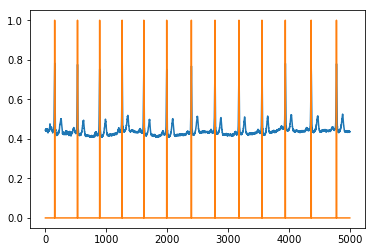

In [7]:
plt.plot(trainXY[1,0])
plt.plot(trainXY[1,1])
plt.show()

In [8]:
# trainXY = numpy.swapaxes(trainXY, 2, 3)
# testXY = numpy.swapaxes(testXY, 2, 3)

print(trainXY.shape[0])
print(testXY.shape)
unique_items, counts = numpy.unique(trainXY[:,1], return_counts=True)
ratio_zero_one = counts[0]/counts[1]
print(ratio_zero_one)

11188
(1244, 2, 5000, 1)
276.043156133


c1: (None, 8, 5000)
c2: (None, 64, 5000)
c3: (None, 64, 5000)
c3: (None, 256, 5000)
cl: (None, 392, 5000)
c2d: (None, 50, 5000)
out: (None, 1, 5000)
Training on 11188 examples, testing on 1244 examples.
Starting training...
Epoch 1/100 running...Done in 4.647s!
  - training loss:		0.467101
  - test loss:			0.627634
  - test accuracy:		99.6389 %


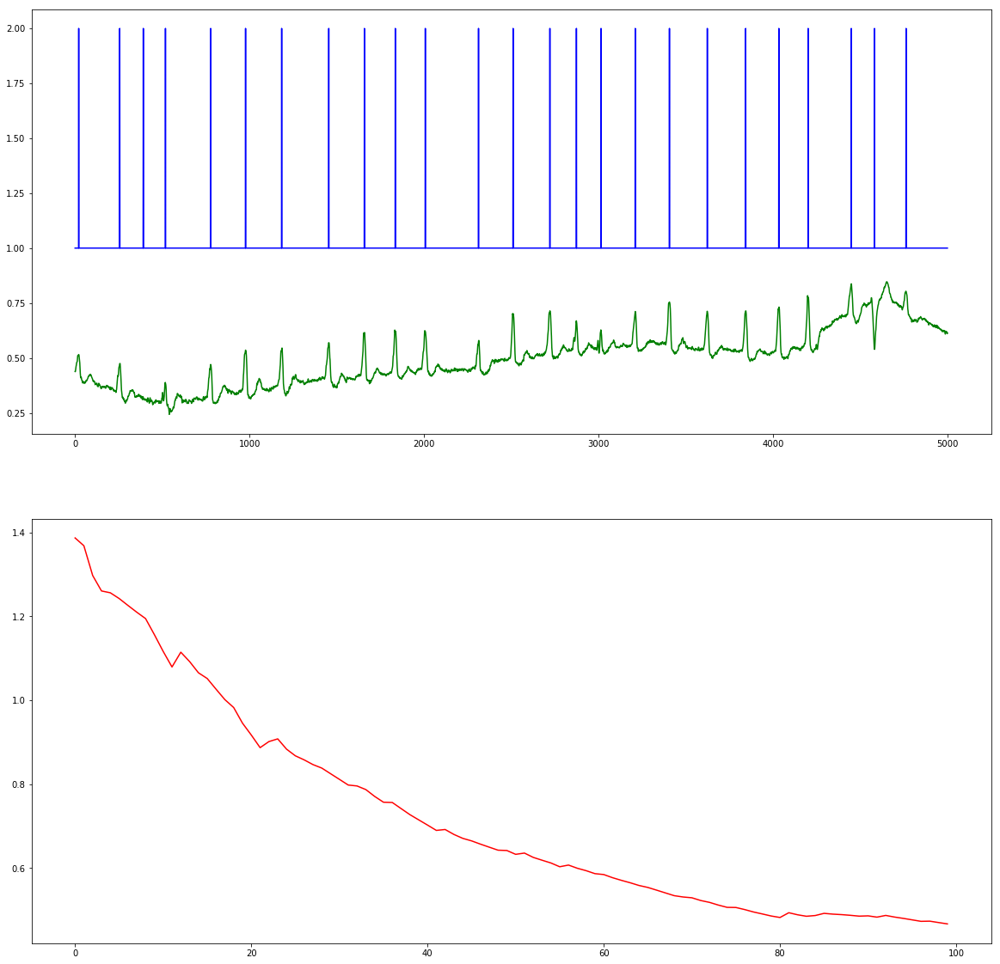

[[[ 0.00604669  0.0121255   0.02498861 ...,  0.51015532  0.33515939
    0.18985164]]]
[[[ 0.001409    0.00321317  0.00767862 ...,  0.43605518  0.26360807
    0.13857518]]]


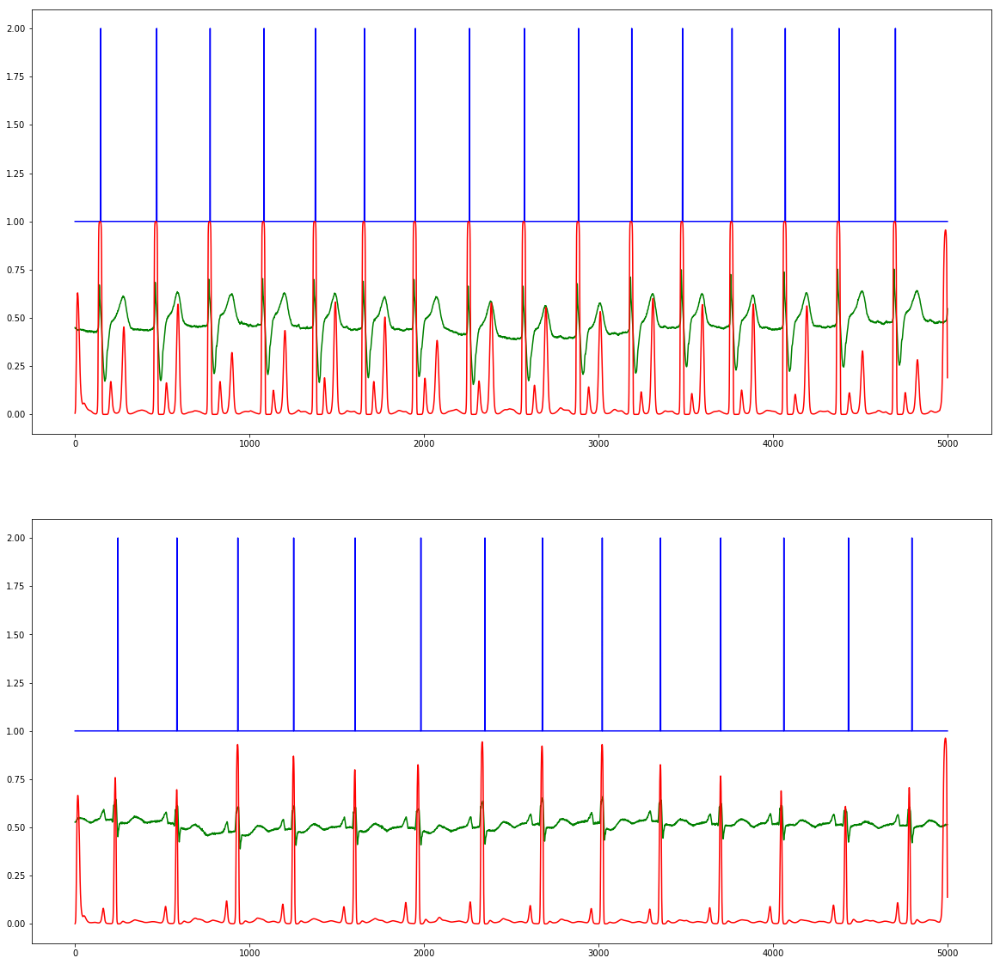

Epoch 2/100 running...Done in 4.596s!
  - training loss:		0.640234
  - test loss:			0.537516
  - test accuracy:		99.6389 %


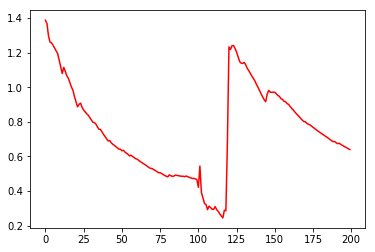

[[[ 0.84706455  0.92638093  0.96407652 ...,  0.23929629  0.15351976
    0.09474651]]]
[[[ 0.09743595  0.13543379  0.18744409 ...,  0.44071043  0.36052832
    0.28733084]]]


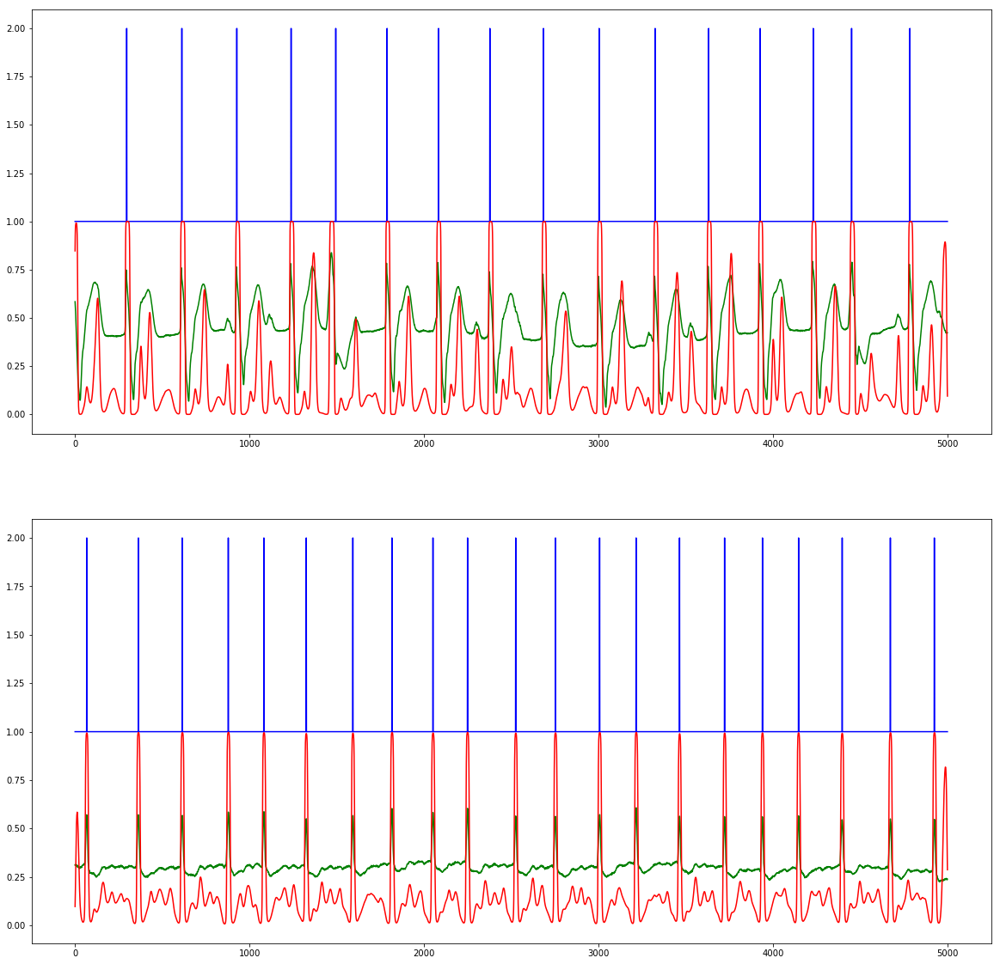

Epoch 3/100 running...Done in 4.607s!
  - training loss:		0.544891
  - test loss:			0.579233
  - test accuracy:		99.6389 %


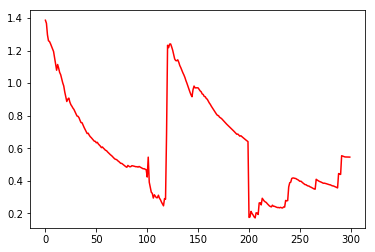

[[[ 0.1090283   0.17060971  0.25959471 ...,  0.58961225  0.47364119
    0.36144409]]]
[[[ 0.06832618  0.10612809  0.16268368 ...,  0.75784123  0.60706329
    0.43311483]]]


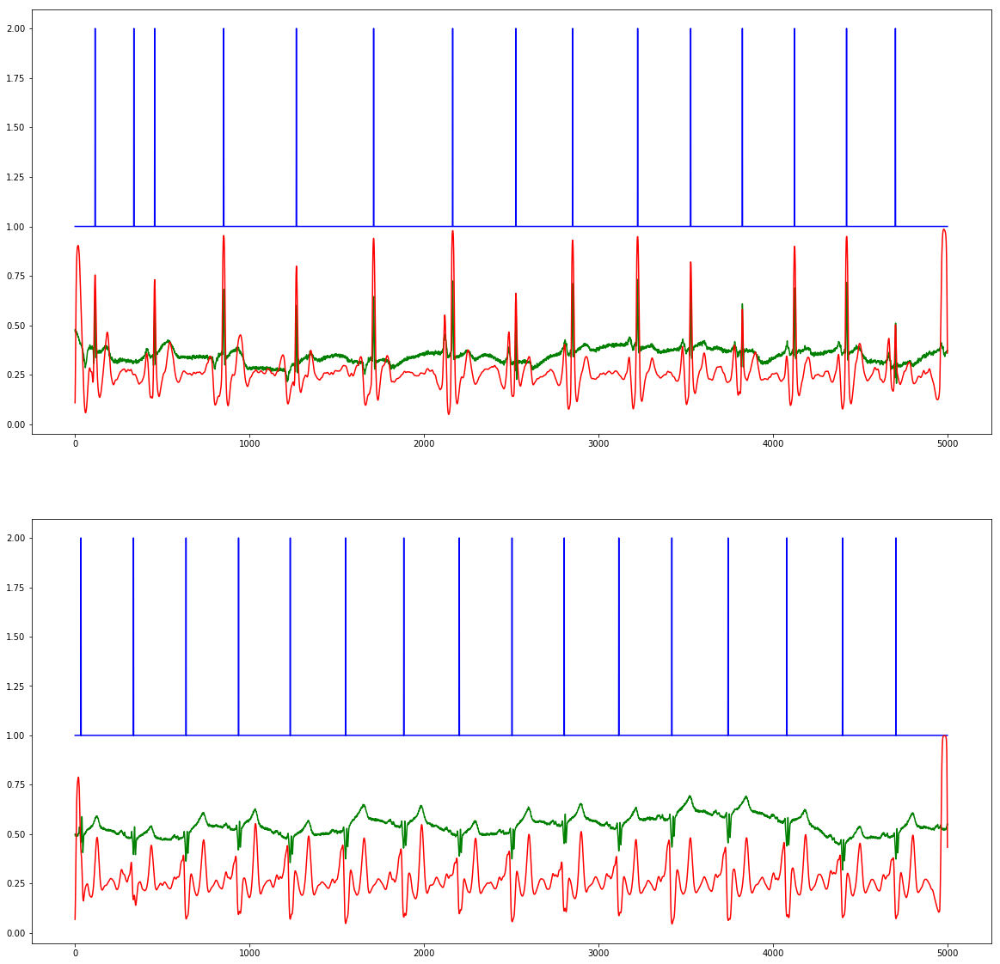

Epoch 4/100 running...Done in 4.555s!
  - training loss:		0.473225
  - test loss:			0.509779
  - test accuracy:		99.6389 %


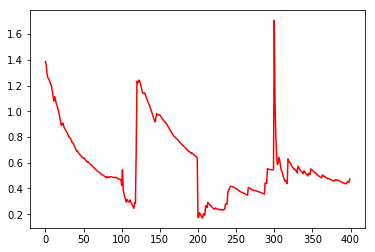

[[[ 0.00503044  0.00976797  0.01983967 ...,  0.53701442  0.34794161
    0.19791158]]]
[[[ 0.01246254  0.02044715  0.03465277 ...,  0.90949547  0.78057849
    0.54985118]]]


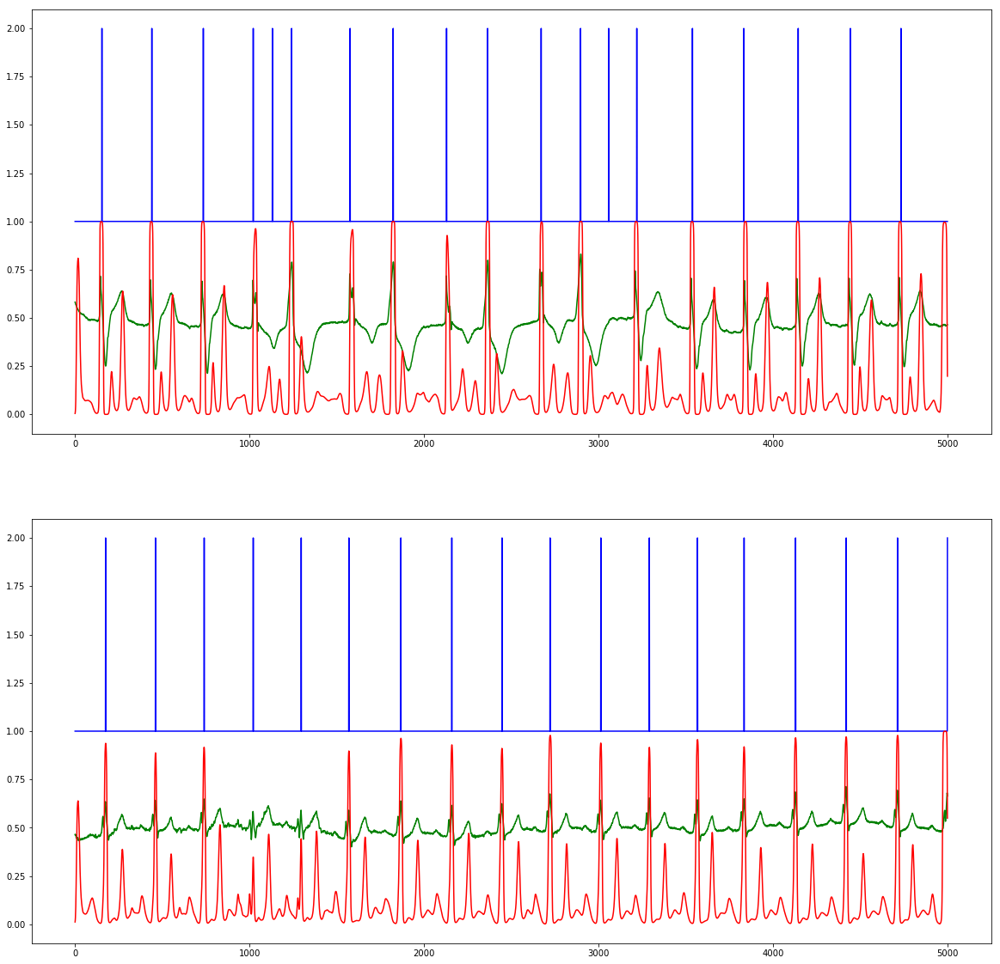

Epoch 5/100 running...Done in 4.607s!
  - training loss:		0.469294
  - test loss:			0.490852
  - test accuracy:		99.6389 %


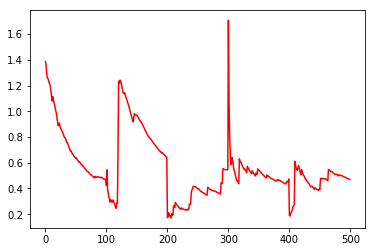

[[[ 0.58647823  0.8071366   0.92198807 ...,  0.162522    0.0910062
    0.04949925]]]
[[[ 0.00530618  0.0096884   0.01876627 ...,  0.41228029  0.2371548
    0.12024524]]]


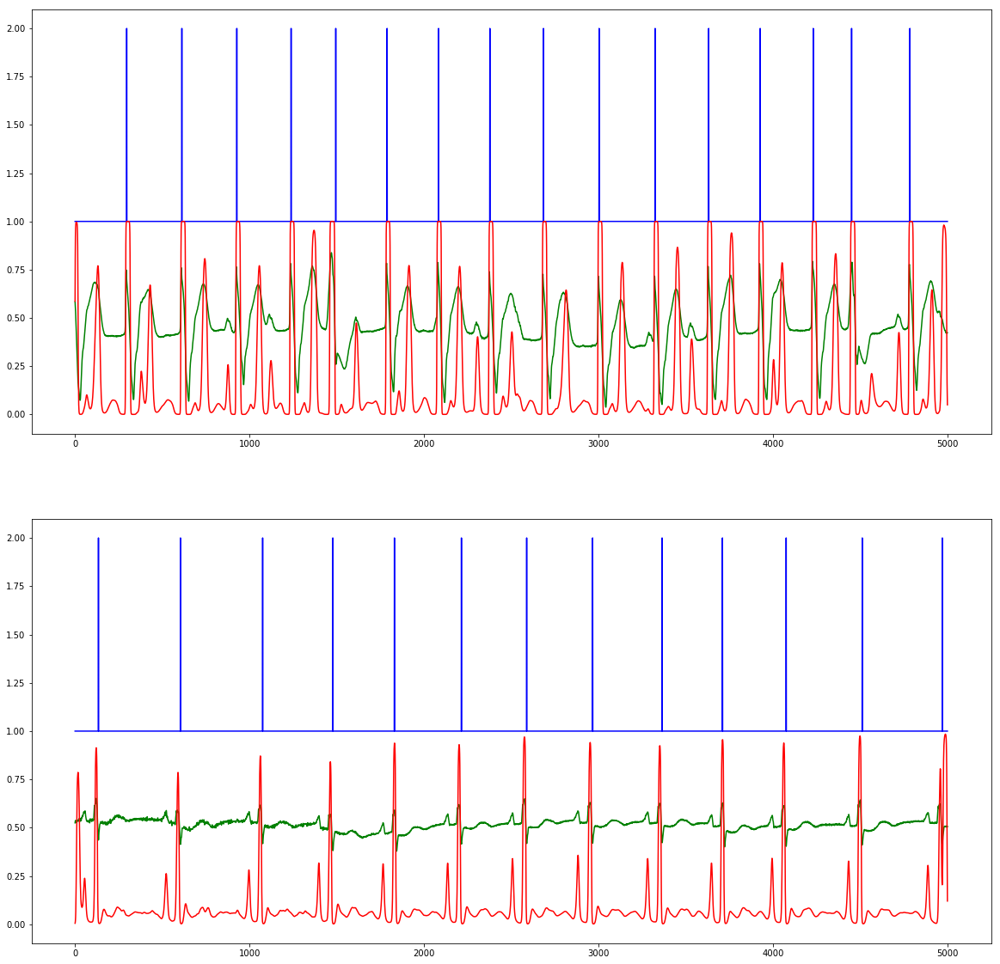

Epoch 6/100 running...Done in 4.613s!
  - training loss:		0.391433
  - test loss:			0.511146
  - test accuracy:		99.6389 %


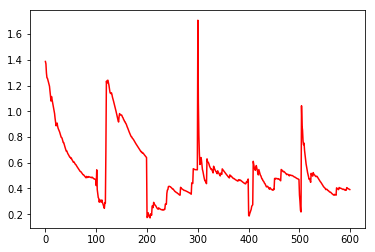

[[[ 0.02499225  0.05169854  0.11004658 ...,  0.10517505  0.0439488
    0.01797608]]]
[[[ 0.01128108  0.02261906  0.04793501 ...,  0.05460109  0.02685052
    0.0132638 ]]]


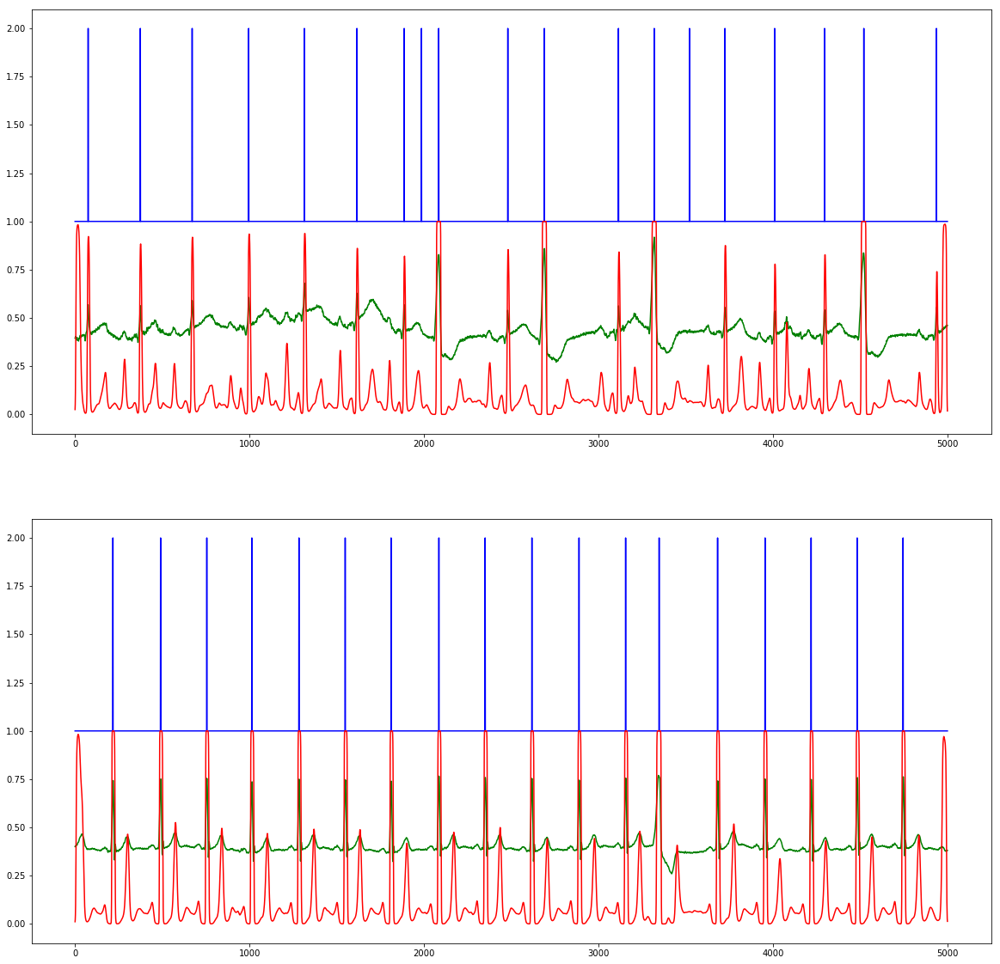

Epoch 7/100 running...Done in 4.683s!
  - training loss:		0.623472
  - test loss:			0.477535
  - test accuracy:		99.6389 %


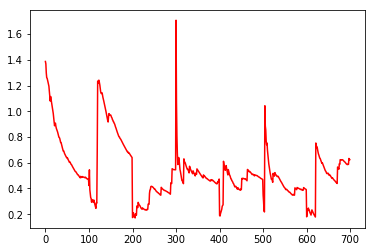

[[[ 0.10831469  0.14114387  0.18579745 ...,  0.44568509  0.33694136
    0.24040337]]]
[[[ 0.05168004  0.07780951  0.1212308  ...,  0.36492068  0.27646473
    0.19909626]]]


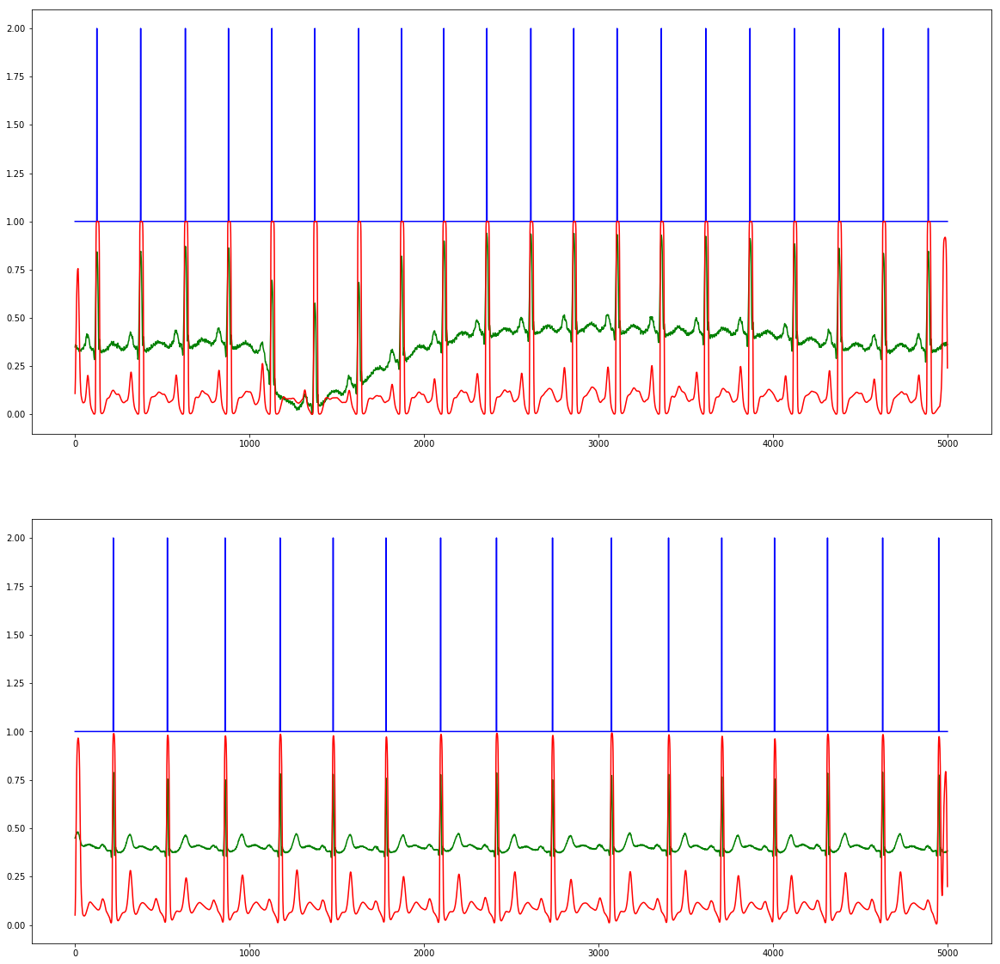

Epoch 8/100 running...Done in 4.599s!
  - training loss:		0.443162
  - test loss:			0.460380
  - test accuracy:		99.6389 %


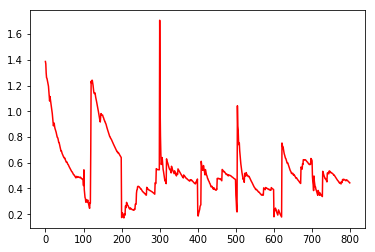

[[[ 0.01290339  0.02372033  0.04725134 ...,  0.44818816  0.24633832
    0.11512477]]]
[[[ 0.05392201  0.07018114  0.09385801 ...,  0.34282941  0.23513547
    0.15196604]]]


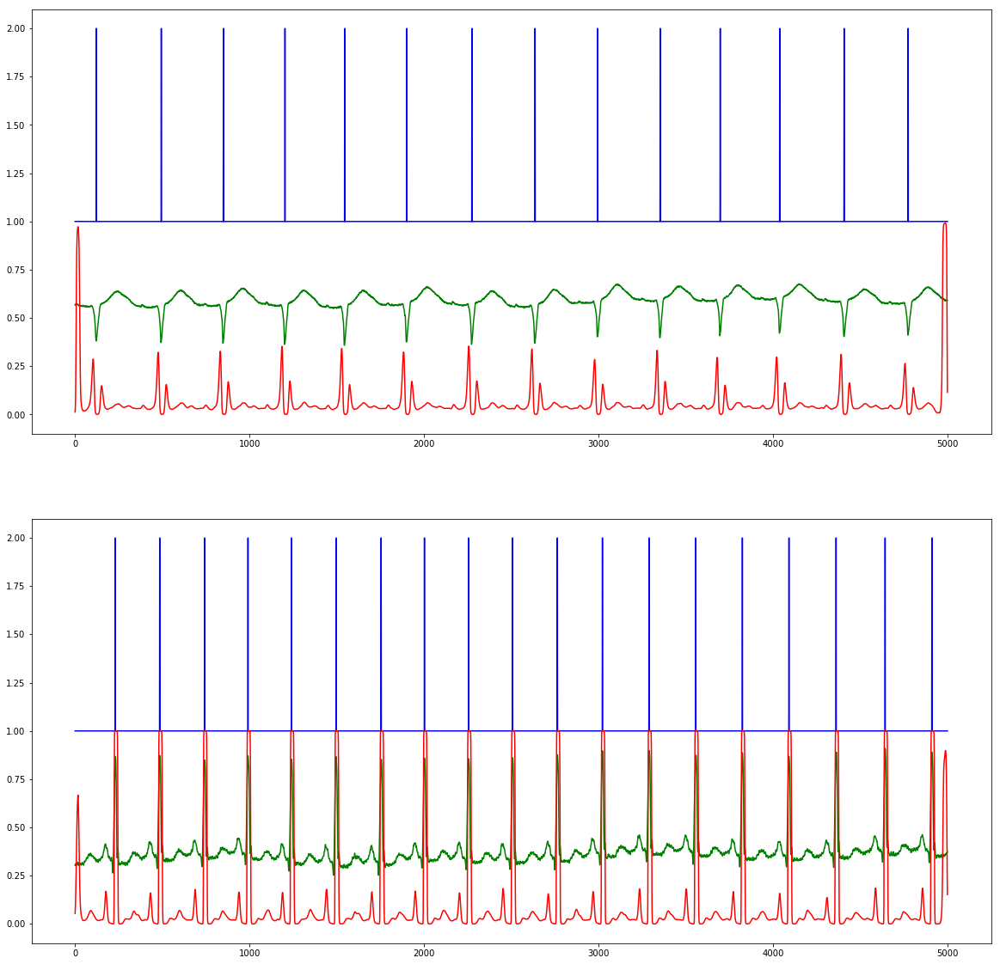

Epoch 9/100 running...Done in 4.645s!
  - training loss:		0.486710
  - test loss:			0.450844
  - test accuracy:		99.6389 %


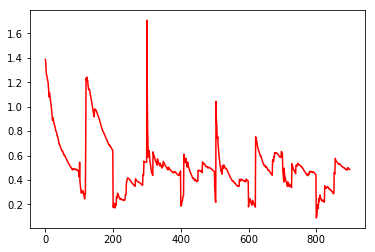

[[[ 0.06686492  0.10008109  0.15584737 ...,  0.66709024  0.49978873
    0.33395705]]]
[[[ 0.07649679  0.10644598  0.15339179 ...,  0.46806768  0.40823936
    0.34356573]]]


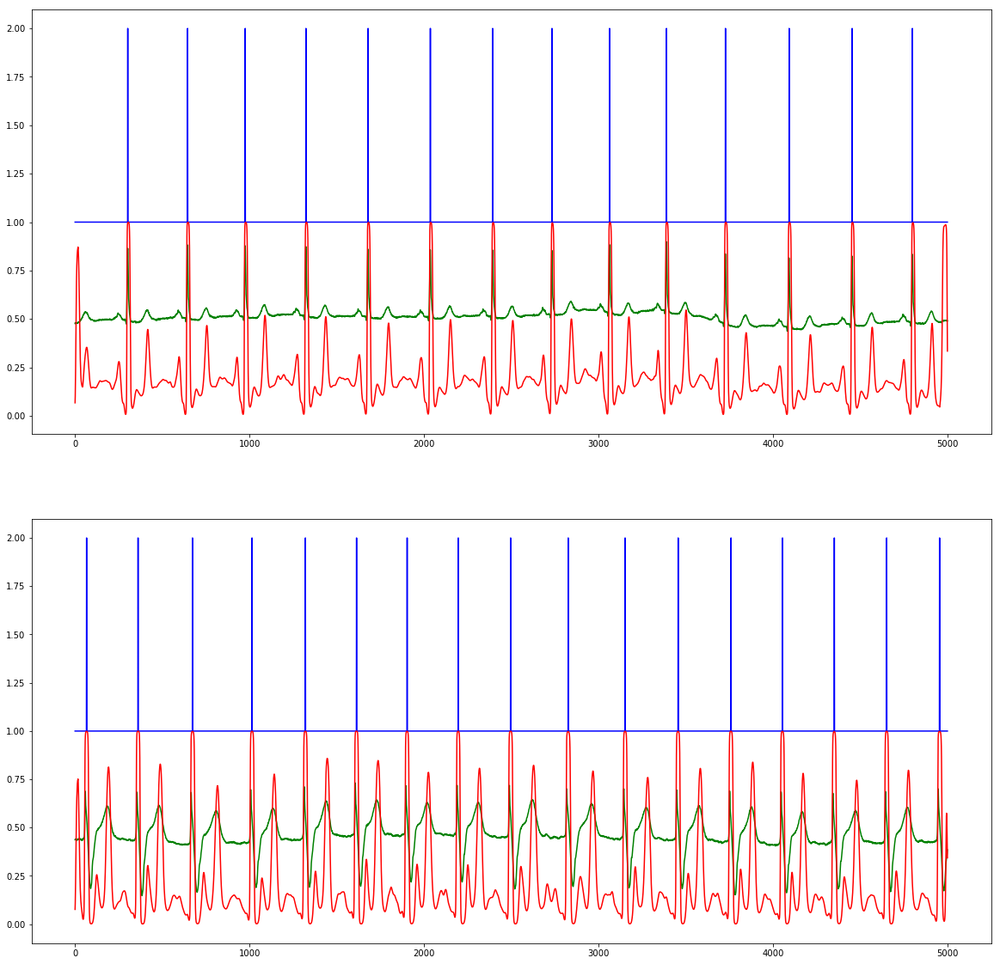

Epoch 10/100 running...Done in 4.621s!
  - training loss:		0.357586
  - test loss:			0.421018
  - test accuracy:		99.6389 %


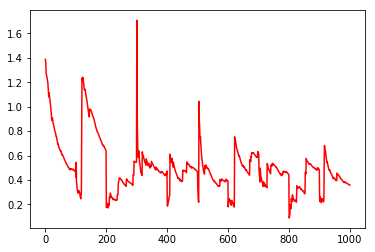

[[[ 0.01733827  0.03715007  0.08741225 ...,  0.88369095  0.68422753
    0.38919073]]]
[[[ 0.03904162  0.0596302   0.09656468 ...,  0.39949498  0.26515564
    0.1662773 ]]]


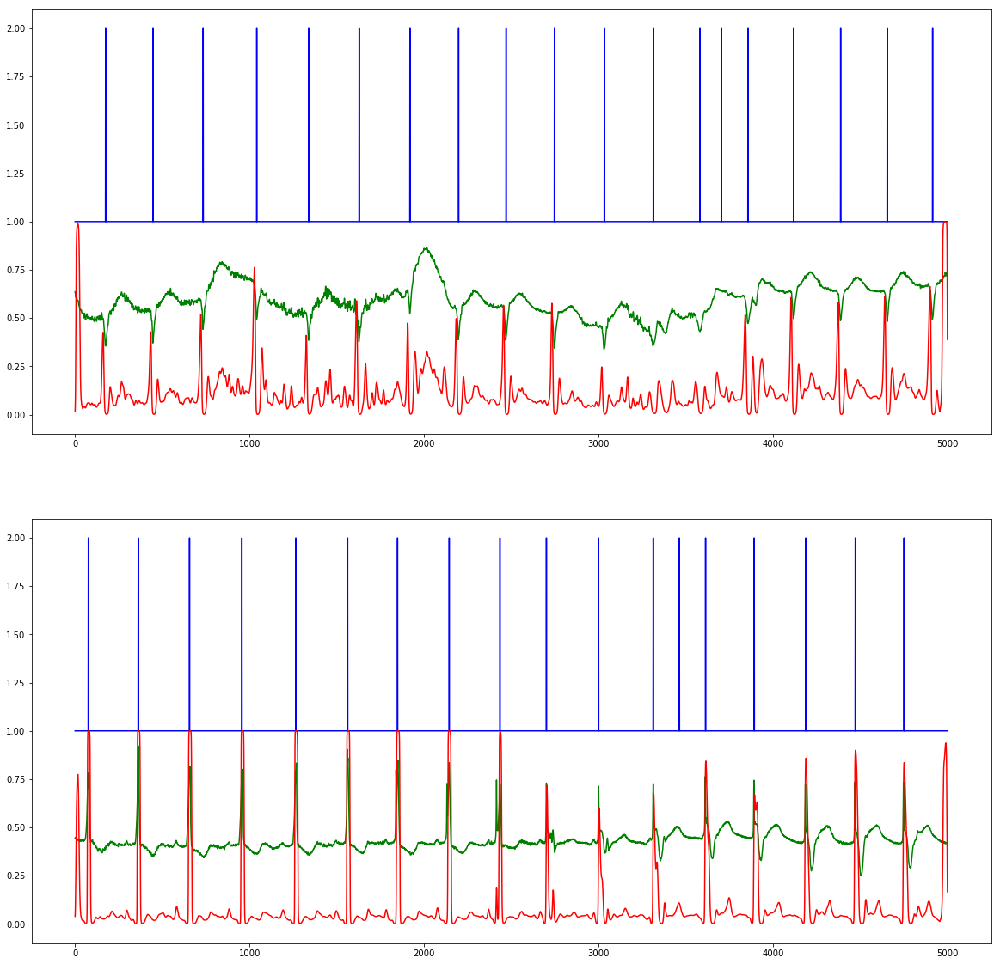

Epoch 11/100 running...Done in 4.606s!
  - training loss:		0.386269
  - test loss:			0.429560
  - test accuracy:		99.6389 %


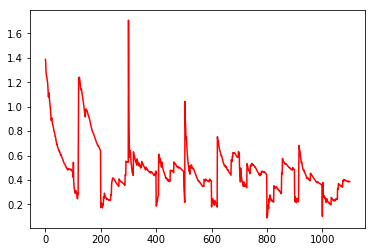

[[[ 0.06210034  0.09549531  0.15546836 ...,  0.29885522  0.15693174
    0.08169639]]]
[[[ 0.01772281  0.07114221  0.30958933 ...,  0.3601675   0.21376057
    0.12260611]]]


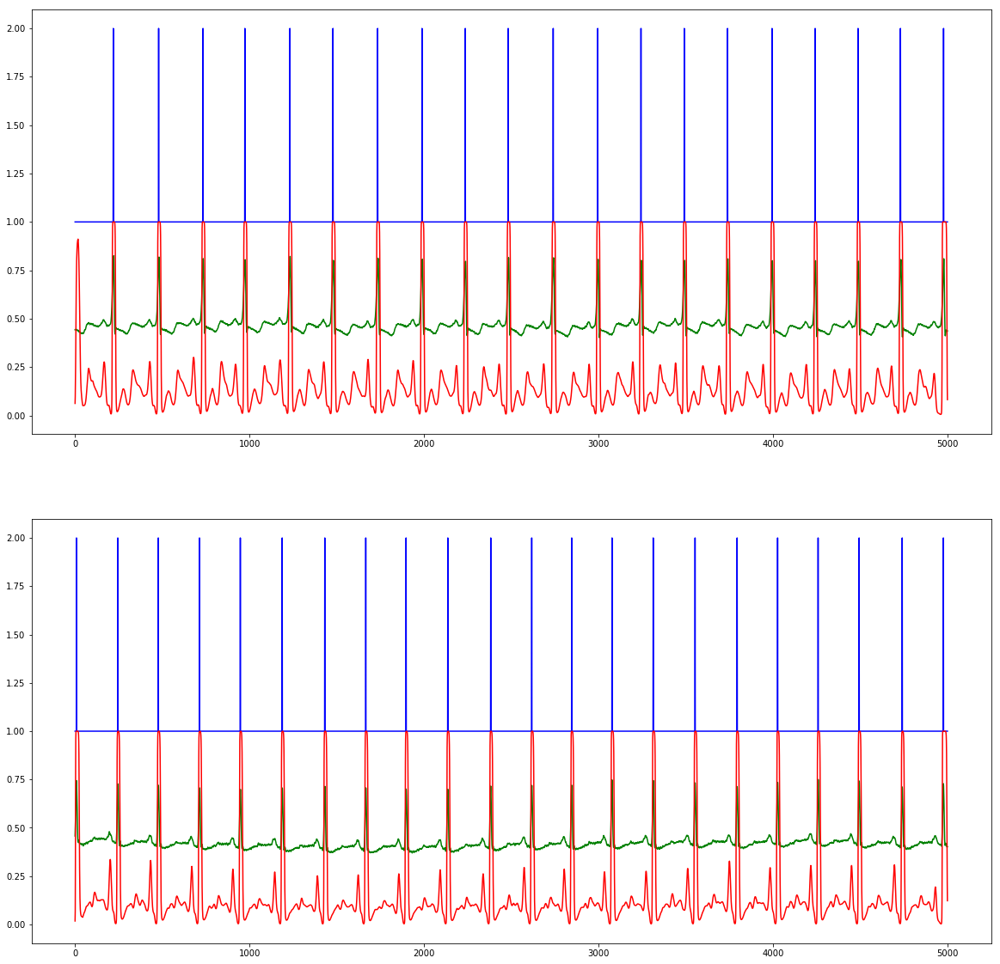

Epoch 12/100 running...Done in 4.617s!
  - training loss:		0.296694
  - test loss:			0.477151
  - test accuracy:		99.6389 %


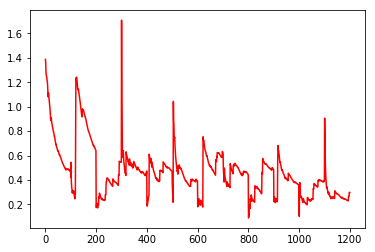

[[[ 0.02516339  0.04257247  0.07808693 ...,  0.828076    0.6465922
    0.42094514]]]
[[[ 0.01873113  0.03841672  0.08749986 ...,  0.8191309   0.60529858
    0.35569012]]]


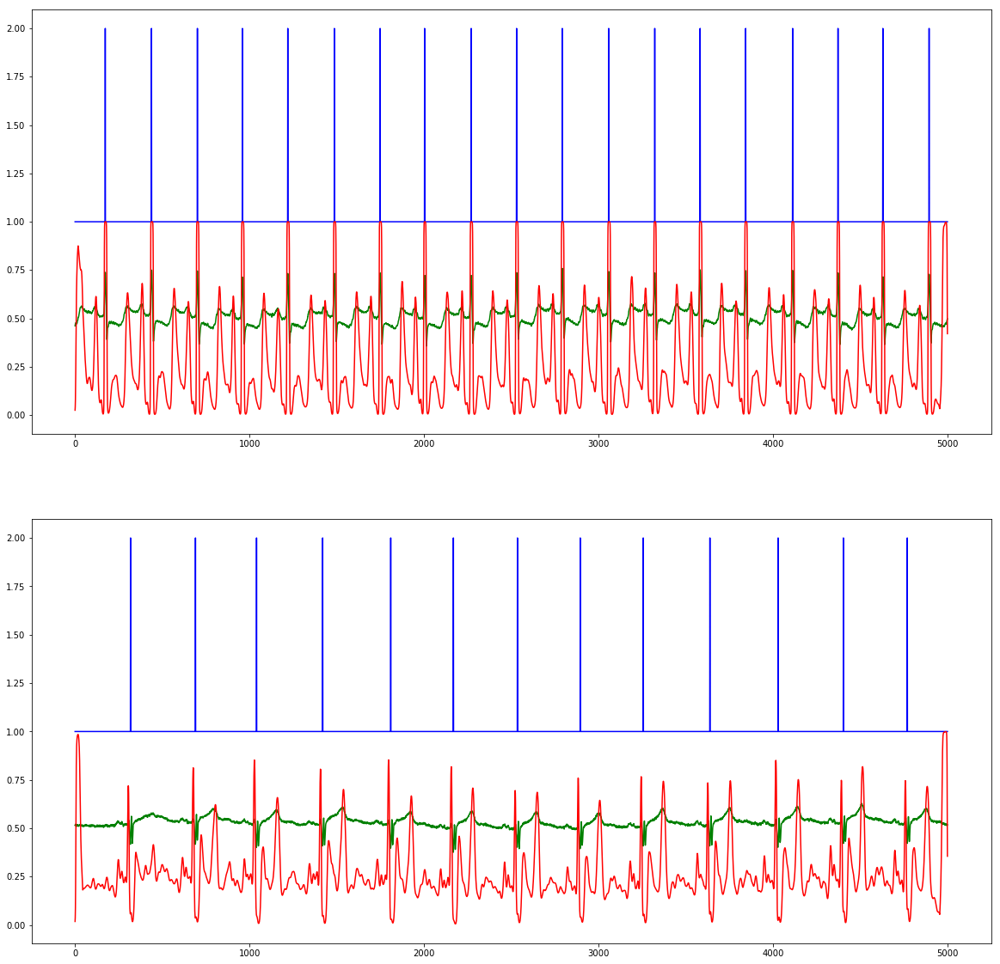

Epoch 13/100 running...Done in 4.566s!
  - training loss:		0.315408
  - test loss:			0.383280
  - test accuracy:		99.6389 %


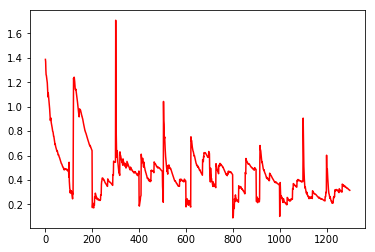

[[[ 0.05667583  0.09228116  0.15730374 ...,  0.74177349  0.60834032
    0.46371469]]]
[[[ 0.03460638  0.05851882  0.10826351 ...,  0.89513338  0.77309614
    0.58706719]]]


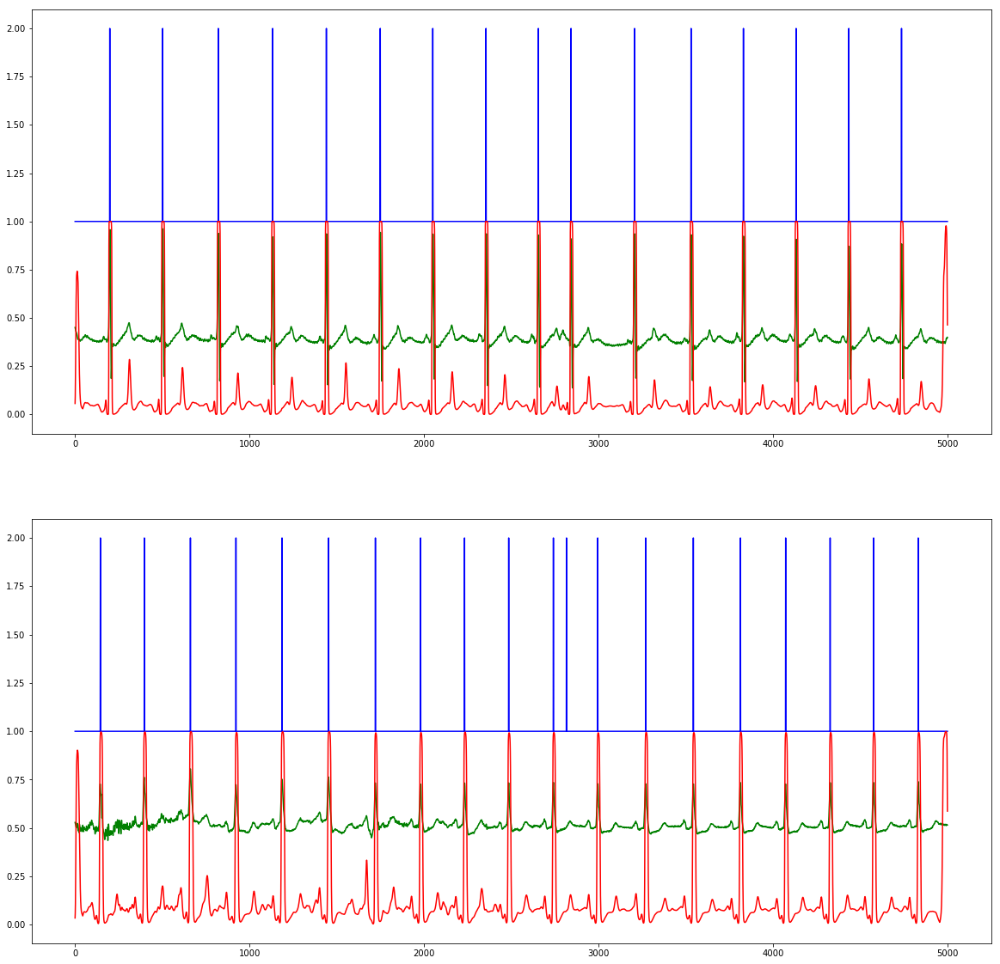

Epoch 14/100 running...Done in 4.590s!
  - training loss:		0.417254
  - test loss:			0.395430
  - test accuracy:		99.6389 %


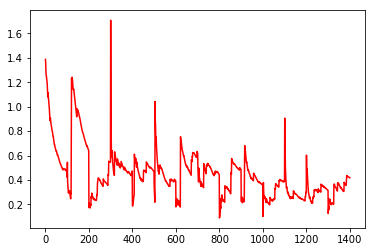

[[[ 0.16912158  0.22748852  0.31457826 ...,  0.90782678  0.8385995
    0.74015194]]]
[[[ 0.45723525  0.73165017  0.89687937 ...,  0.8875826   0.80759221
    0.69913828]]]


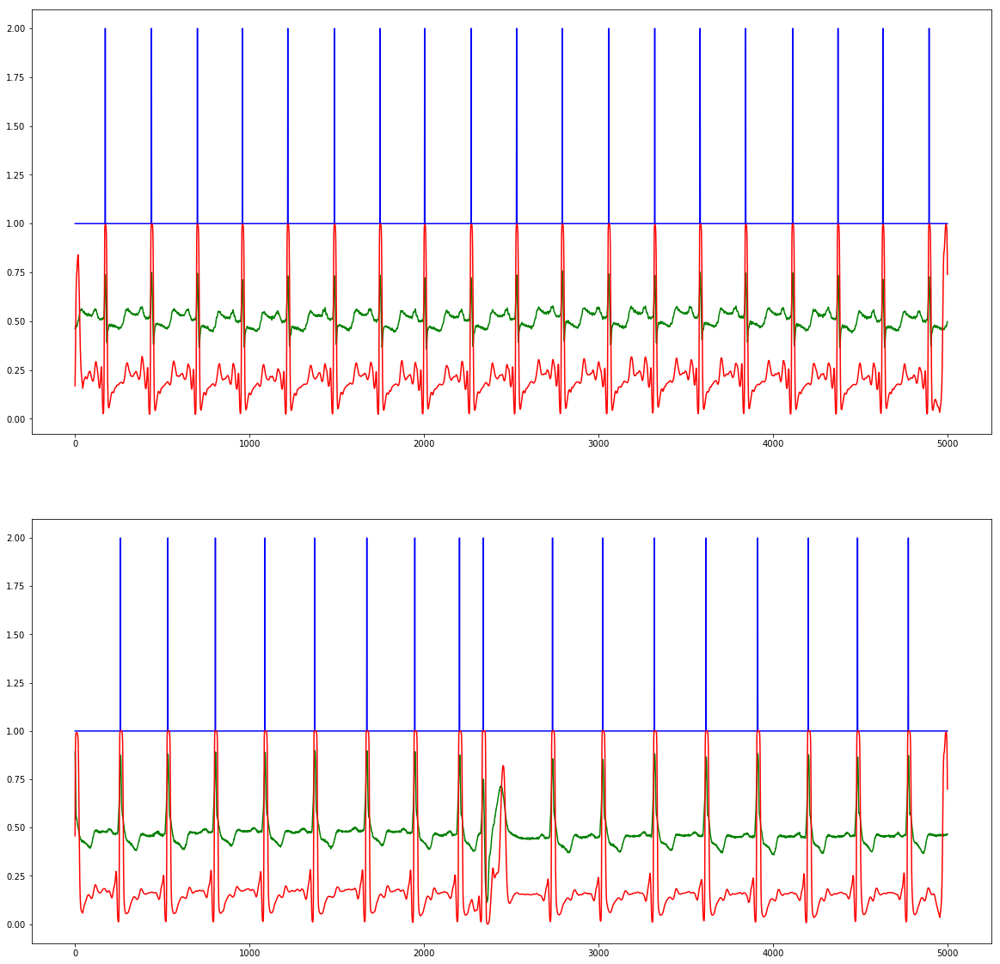

Epoch 15/100 running...Done in 4.631s!
  - training loss:		0.308397
  - test loss:			0.475328
  - test accuracy:		99.6389 %


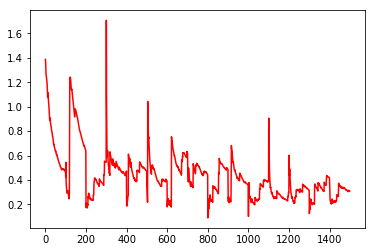

[[[ 0.08422569  0.14952406  0.27572462 ...,  0.71908134  0.5475198
    0.38316268]]]
[[[ 0.08198269  0.12808031  0.20973837 ...,  0.67260236  0.51192814
    0.36539784]]]


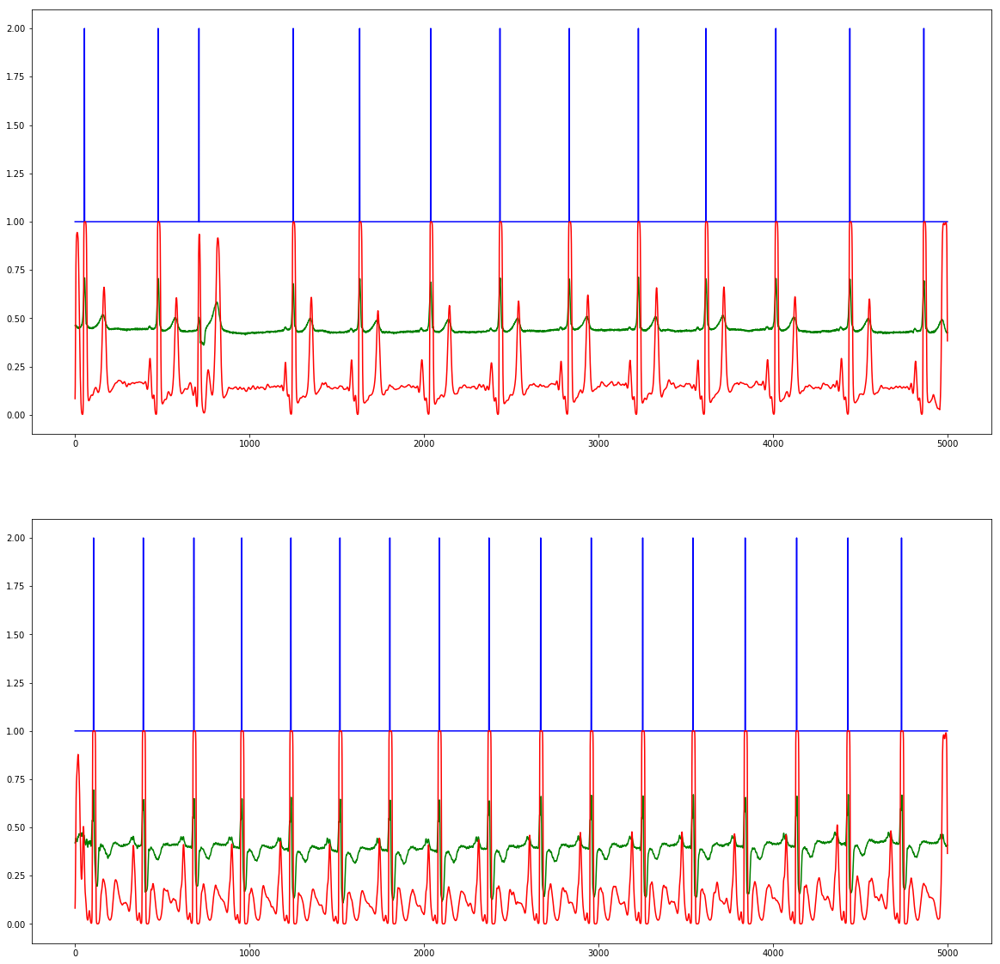

Epoch 16/100 running...Done in 4.610s!
  - training loss:		0.336452
  - test loss:			0.477141
  - test accuracy:		99.6389 %


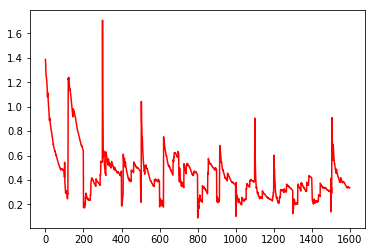

[[[ 0.01546487  0.05119148  0.18503124 ...,  0.98891699  0.94603056
    0.80587125]]]
[[[ 0.08284548  0.1222093   0.1771341  ...,  0.2366219   0.14386855
    0.09115408]]]


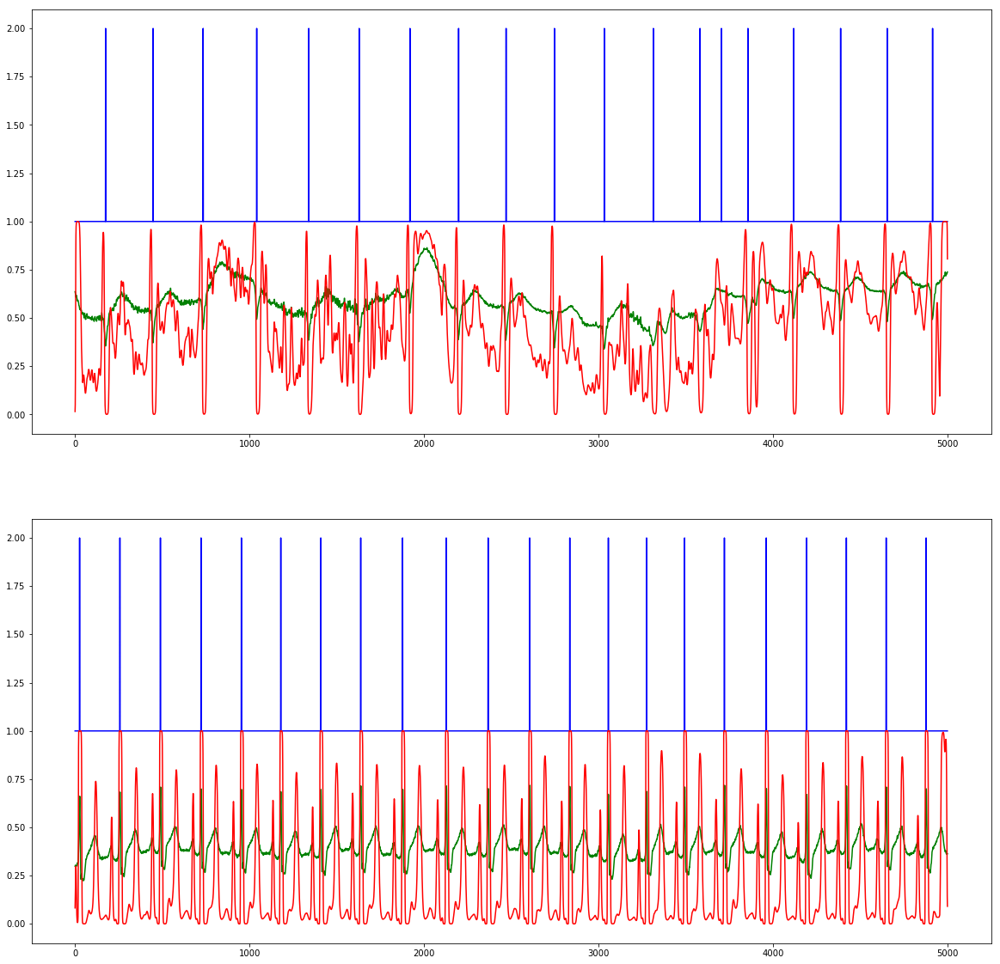

Epoch 17/100 running...Done in 4.607s!
  - training loss:		0.424854
  - test loss:			0.352058
  - test accuracy:		99.6389 %


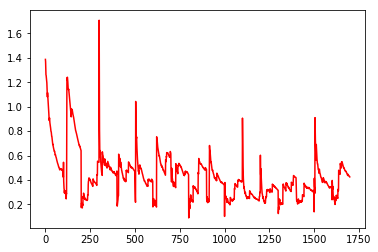

[[[ 0.09278978  0.10608926  0.12444759 ...,  0.33171782  0.277973
    0.23895264]]]
[[[ 0.20184995  0.17421794  0.14344724 ...,  0.55254644  0.45051202
    0.37067097]]]


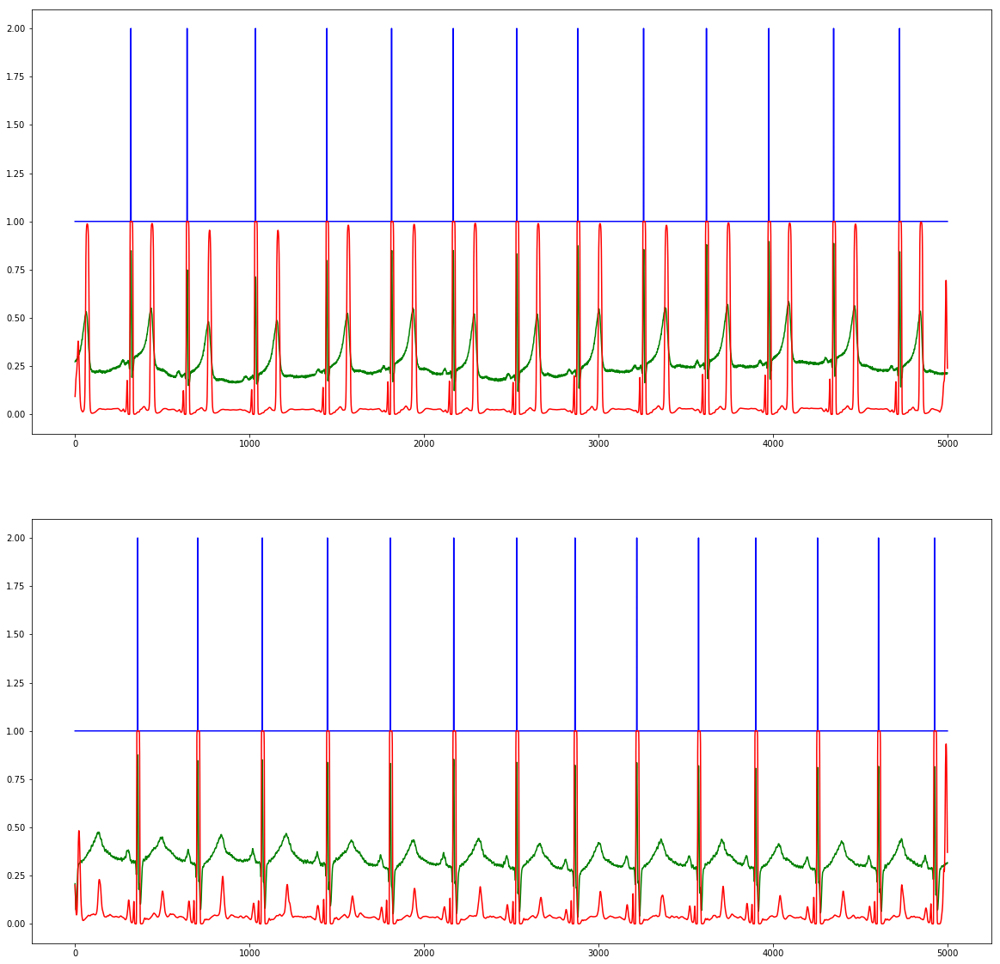

Epoch 18/100 running...Done in 4.575s!
  - training loss:		0.236277
  - test loss:			0.349505
  - test accuracy:		99.6389 %


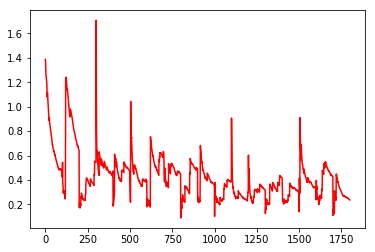

[[[ 0.00253995  0.01457841  0.13217621 ...,  0.43276447  0.31812829
    0.24154031]]]
[[[ 0.05680202  0.09384587  0.16990353 ...,  0.66946423  0.48480308
    0.34178439]]]


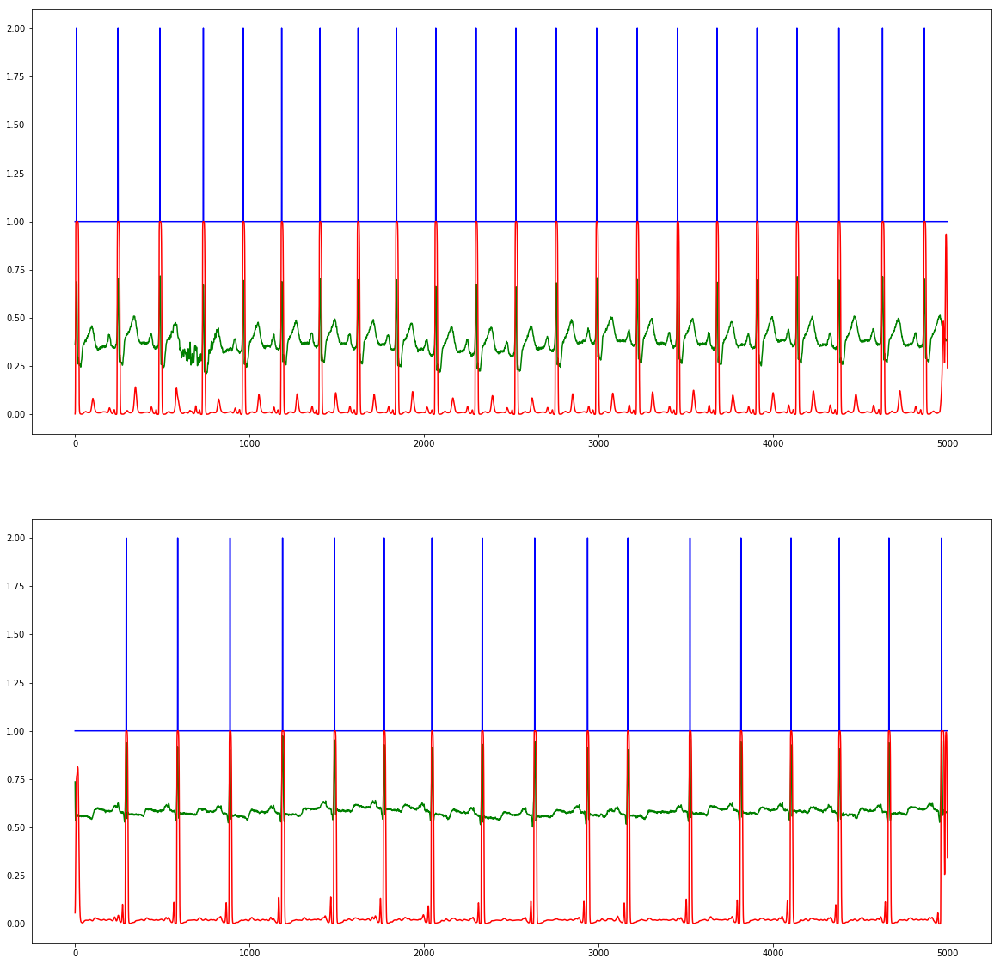

Epoch 19/100 running...Done in 4.581s!
  - training loss:		0.337246
  - test loss:			0.299457
  - test accuracy:		99.6389 %


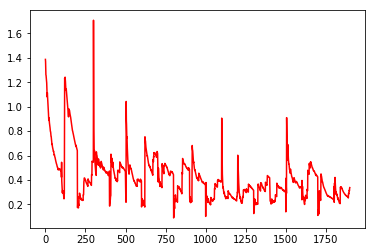

[[[ 0.12308971  0.15443943  0.20645596 ...,  0.98748058  0.97194058
    0.94589102]]]
[[[ 0.11978345  0.16731846  0.25115684 ...,  0.82148743  0.73162872
    0.64902955]]]


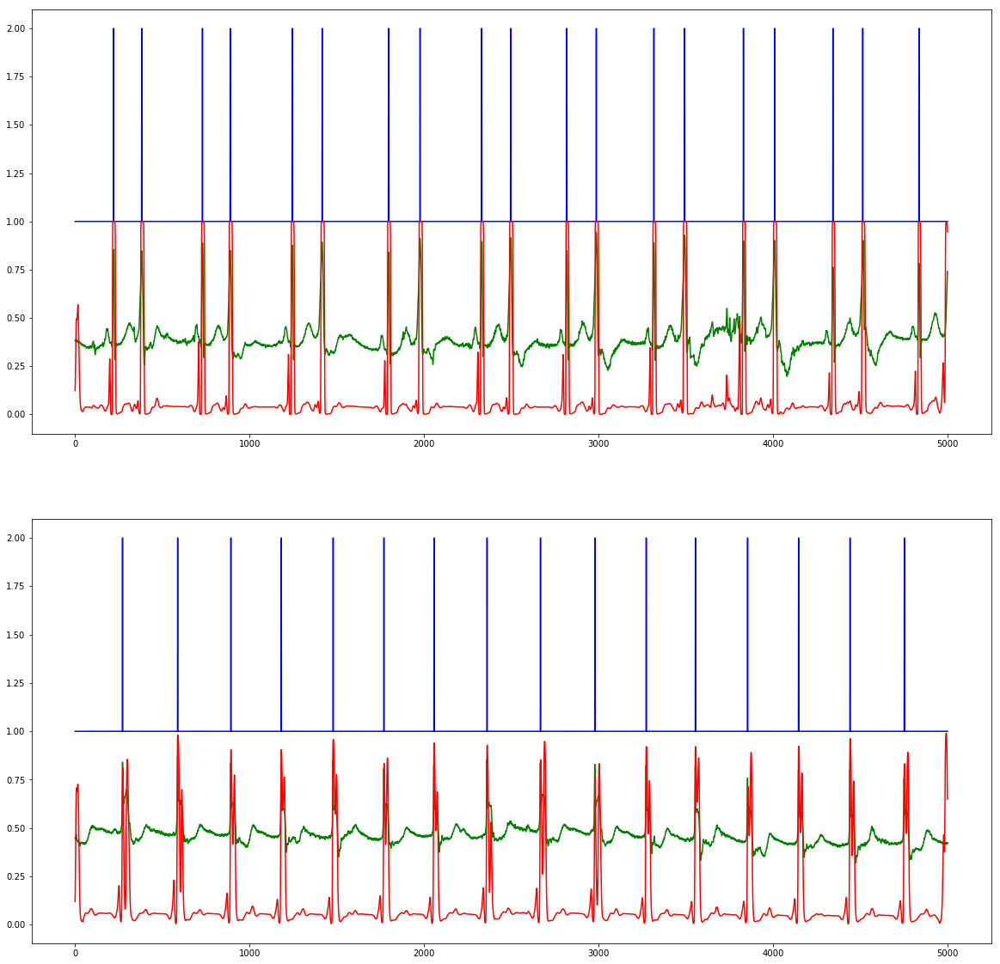

Epoch 20/100 running...Done in 4.597s!
  - training loss:		0.325825
  - test loss:			0.272131
  - test accuracy:		99.6389 %


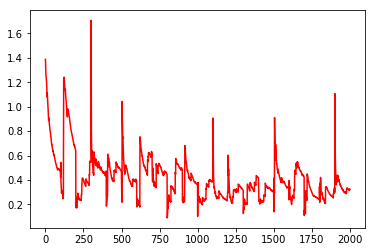

[[[ 0.23639588  0.29482865  0.3969098  ...,  0.98168969  0.96511394
    0.94753051]]]
[[[ 0.19326304  0.23083302  0.29296902 ...,  0.85397792  0.79531866
    0.75061363]]]


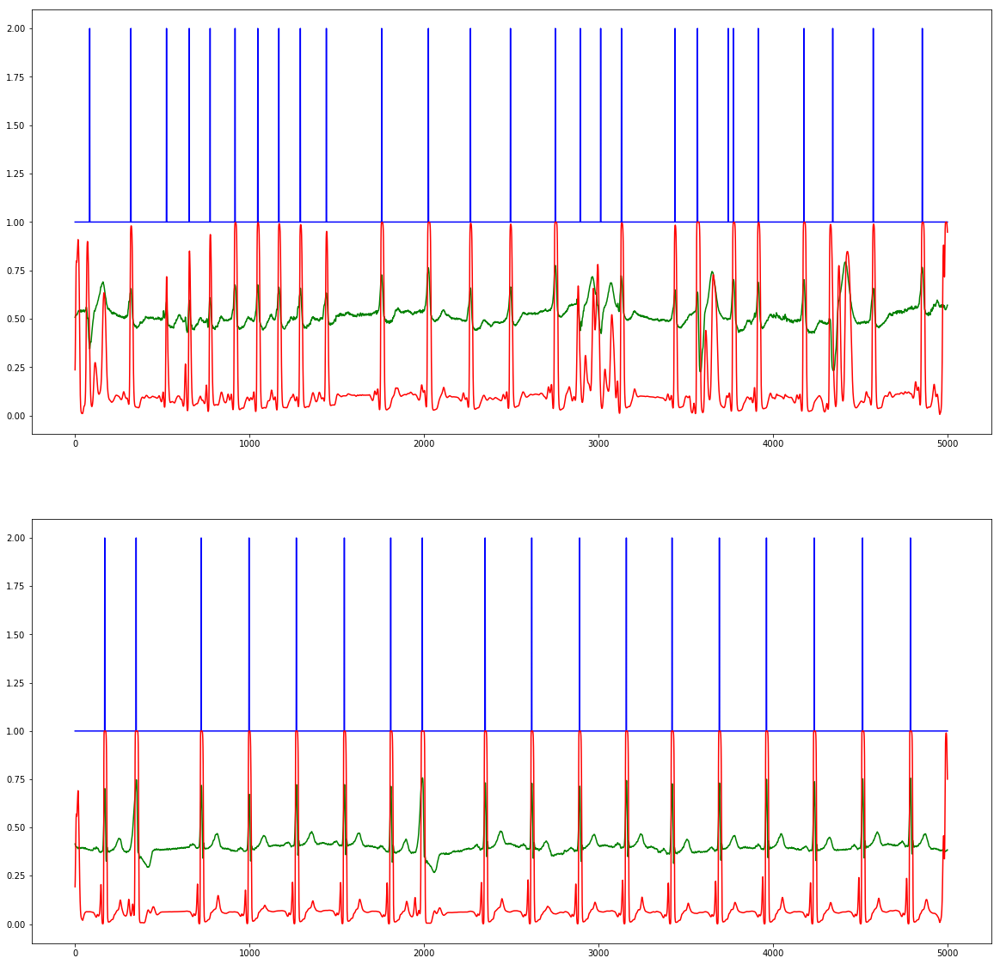

Epoch 21/100 running...Done in 4.597s!
  - training loss:		0.266421
  - test loss:			0.248682
  - test accuracy:		99.6389 %


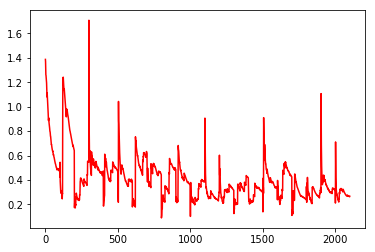

[[[ 0.21815181  0.25611123  0.32176834 ...,  0.98869622  0.97582573
    0.96173227]]]
[[[ 0.14141923  0.17692825  0.23710854 ...,  0.62953424  0.39584664
    0.26735929]]]


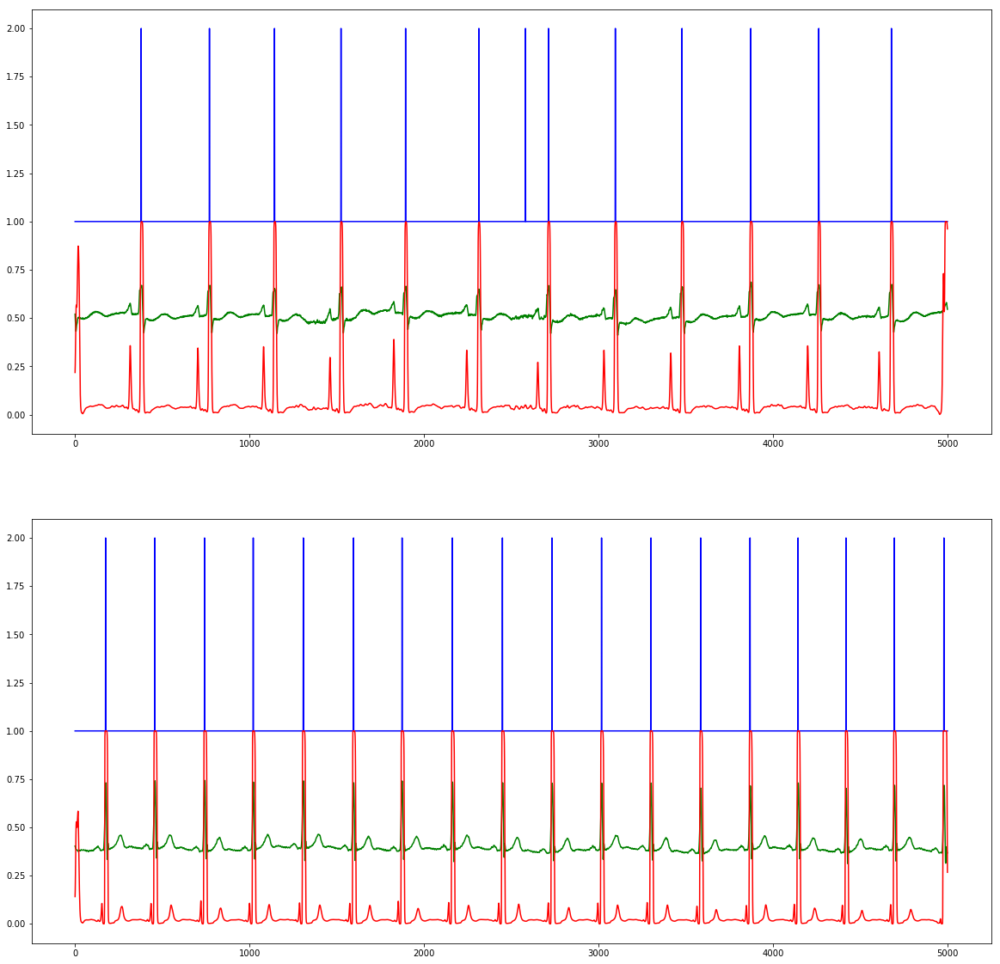

Epoch 22/100 running...Done in 4.569s!
  - training loss:		0.244645
  - test loss:			0.235750
  - test accuracy:		99.6389 %


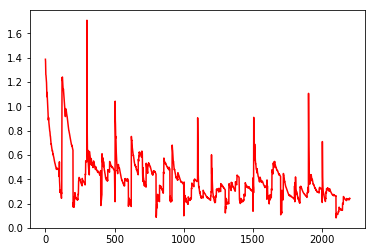

[[[ 0.19615227  0.22186676  0.26953861 ...,  0.57206464  0.51321721
    0.48197916]]]
[[[ 0.16133811  0.18619256  0.2339907  ...,  0.9441371   0.91199189
    0.88955909]]]


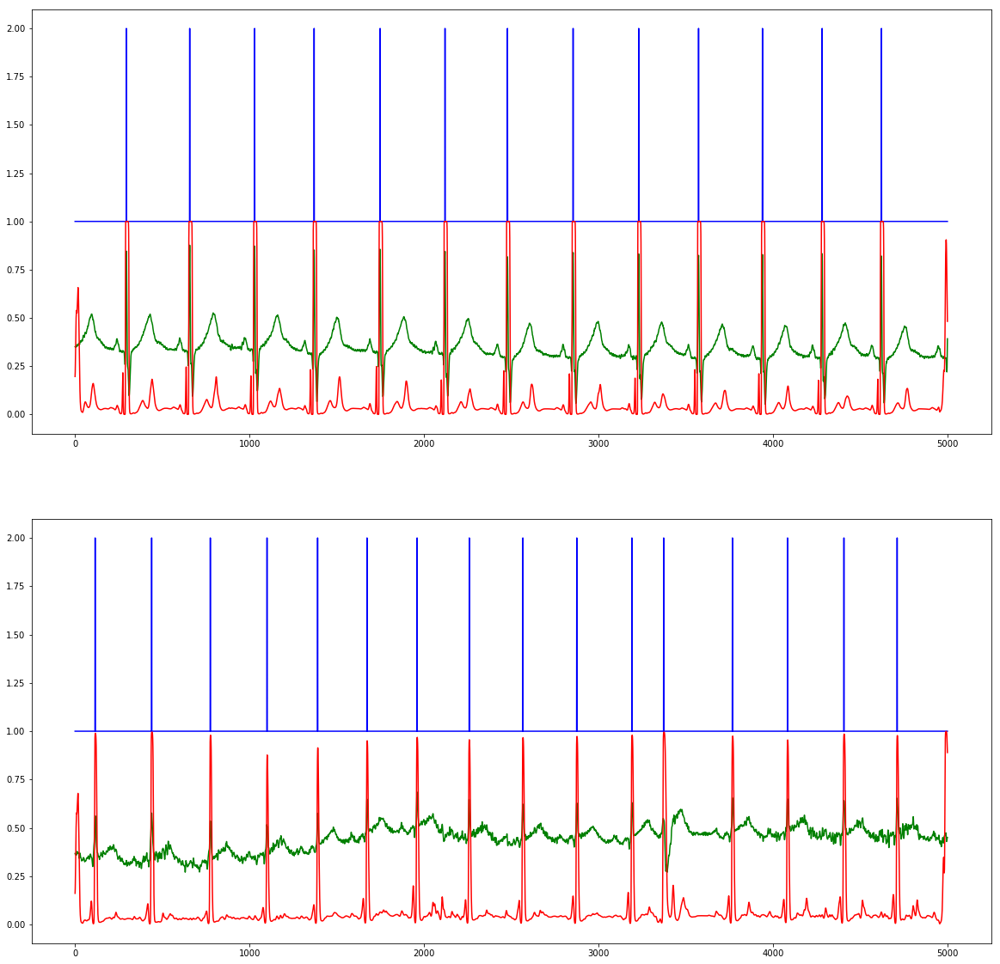

Epoch 23/100 running...Done in 4.625s!
  - training loss:		0.270397
  - test loss:			0.227992
  - test accuracy:		99.6389 %


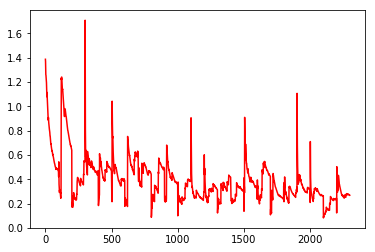

[[[ 0.35196403  0.44852918  0.6059289  ...,  0.9851644   0.97357607
    0.96751976]]]
[[[ 0.24917151  0.2955614   0.37512538 ...,  0.95365644  0.93428886
    0.92890471]]]


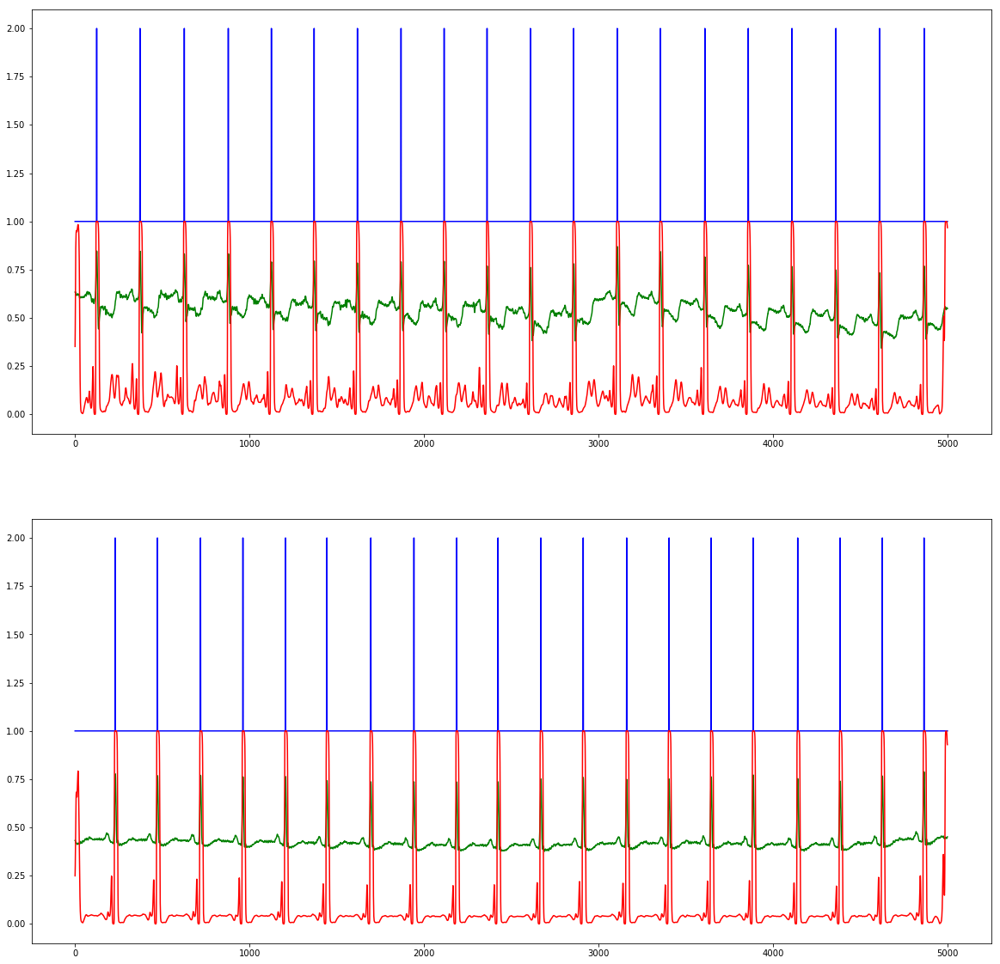

Epoch 24/100 running...Done in 4.670s!
  - training loss:		0.205422
  - test loss:			0.262602
  - test accuracy:		99.6389 %


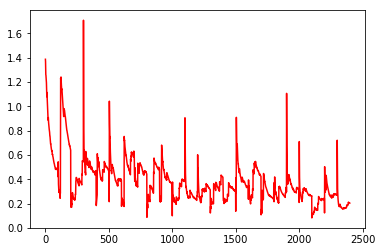

[[[ 0.08500403  0.17294076  0.36803323 ...,  0.90880638  0.85801244
    0.83750975]]]
[[[ 0.12804832  0.1603447   0.21636826 ...,  0.81426573  0.74548292
    0.72207379]]]


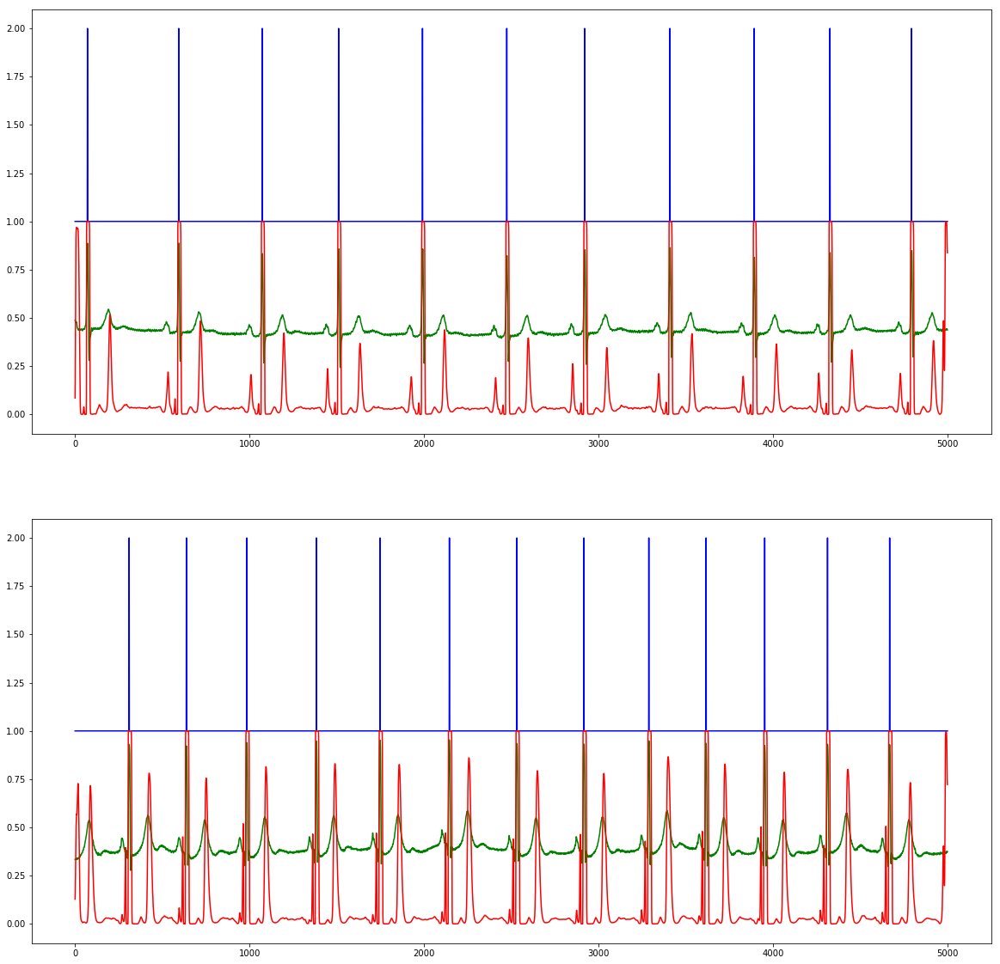

Epoch 25/100 running...Done in 4.607s!
  - training loss:		0.181728
  - test loss:			0.220001
  - test accuracy:		99.6389 %


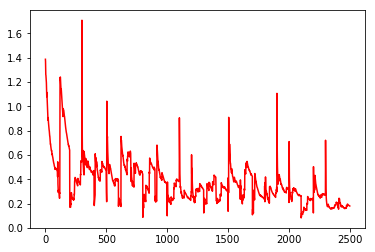

[[[ 0.25298235  0.29332089  0.37366328 ...,  0.7195518   0.67874783
    0.71054476]]]
[[[ 0.15793356  0.16818918  0.19424376 ...,  0.48991323  0.42767137
    0.42333412]]]


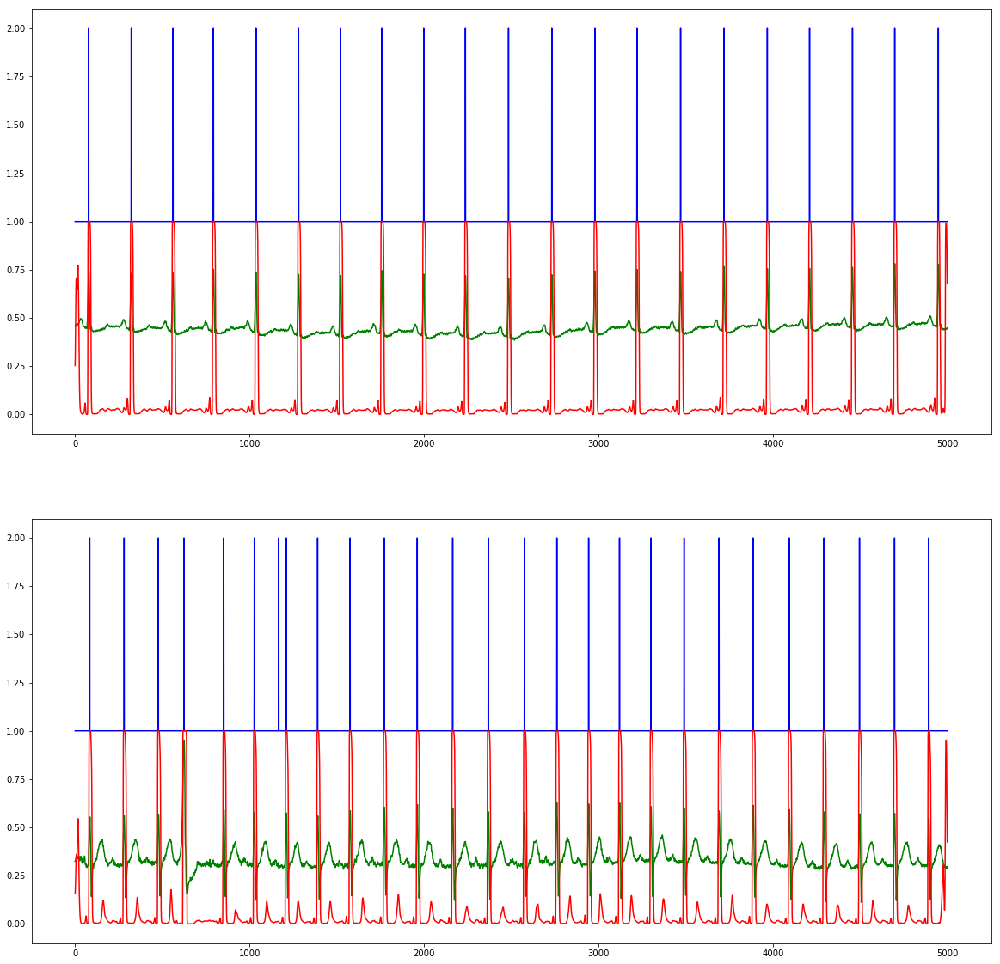

Epoch 26/100 running...Done in 4.592s!
  - training loss:		0.258263
  - test loss:			0.265201
  - test accuracy:		99.6389 %


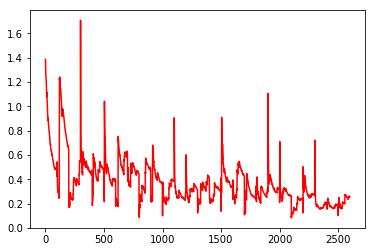

[[[ 0.22074641  0.22025691  0.24222213 ...,  0.62003064  0.56993467
    0.57988518]]]
[[[ 0.60802358  0.68418556  0.80098283 ...,  0.97806394  0.96350169
    0.96211028]]]


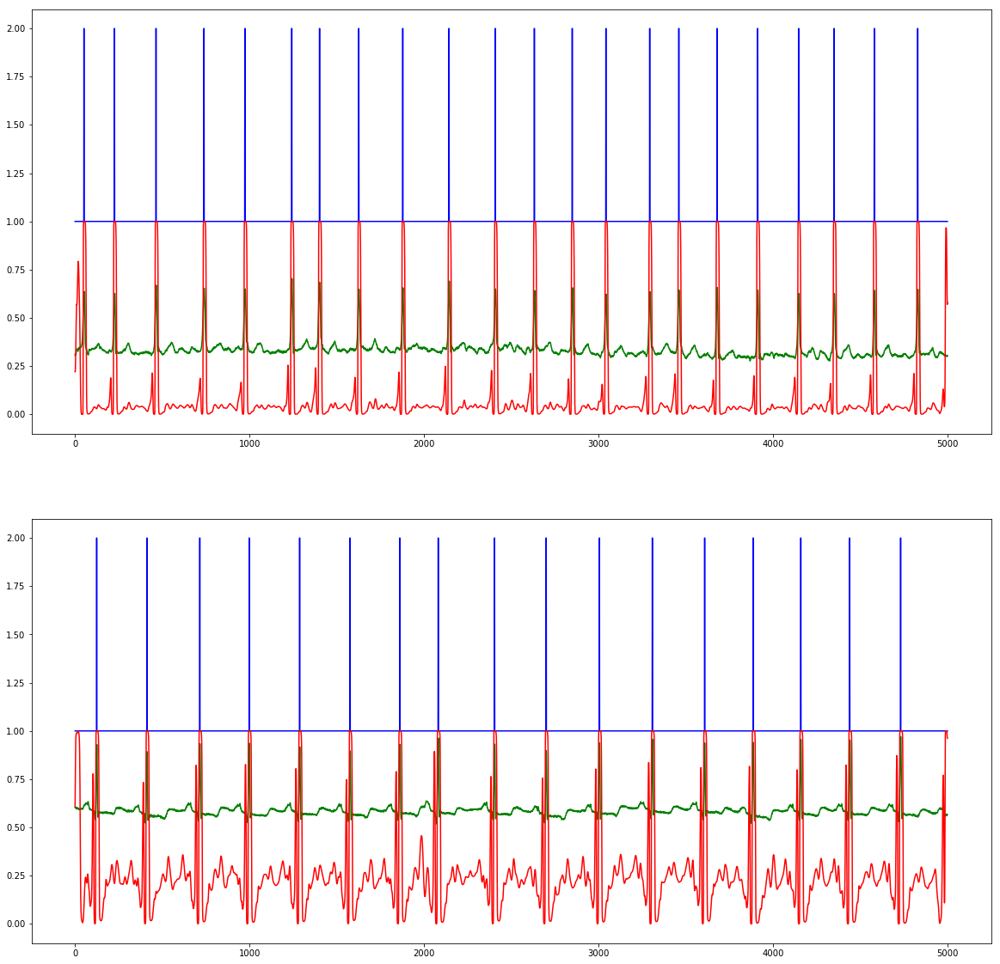

Epoch 27/100 running...Done in 4.663s!
  - training loss:		0.210829
  - test loss:			0.207186
  - test accuracy:		99.6389 %


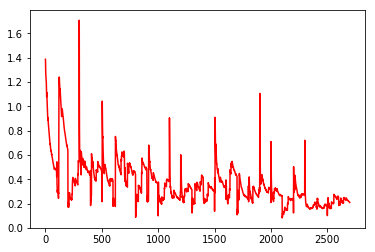

[[[ 0.63368088  0.60291851  0.56419694 ...,  0.8273406   0.77779371
    0.79181343]]]
[[[ 0.21797878  0.25492772  0.3294304  ...,  0.92188847  0.88859767
    0.89338505]]]


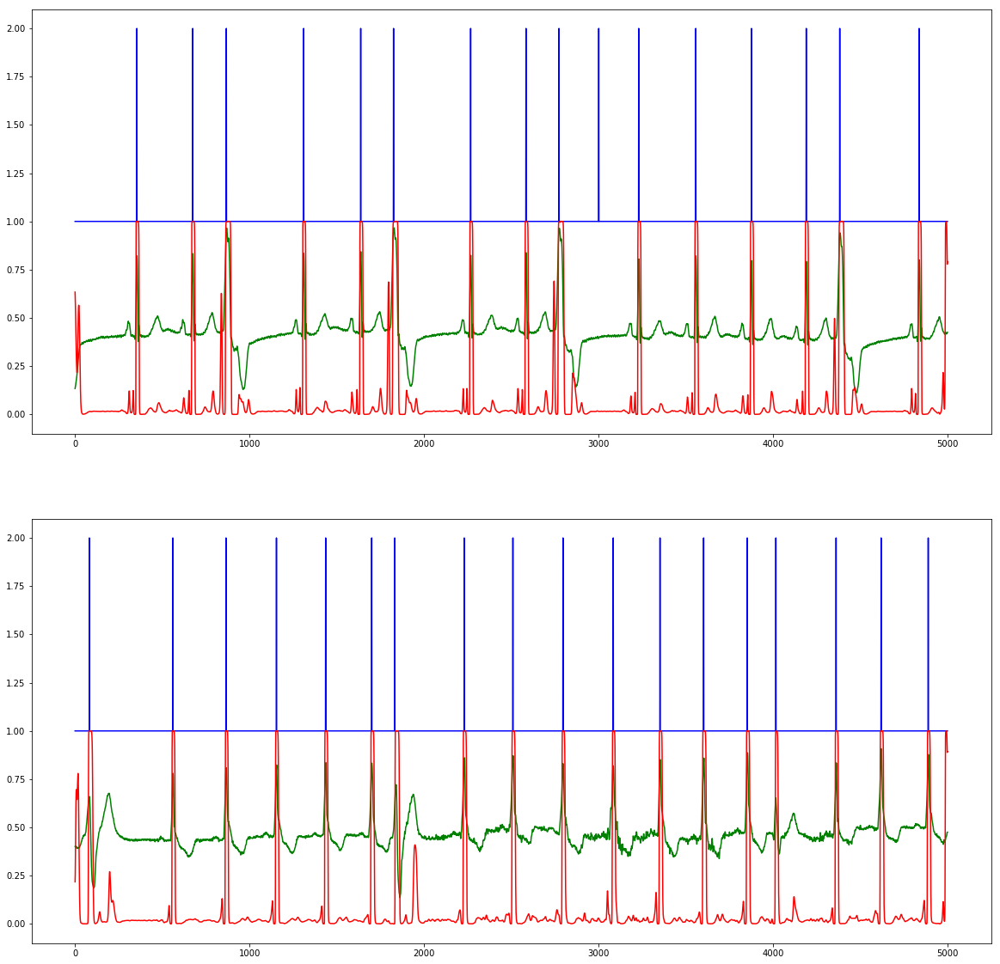

Epoch 28/100 running...Done in 4.597s!
  - training loss:		0.216039
  - test loss:			0.221490
  - test accuracy:		99.6389 %


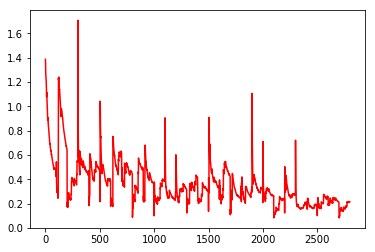

[[[ 0.26854658  0.3308453   0.48587689 ...,  0.97106159  0.95959961
    0.9658789 ]]]
[[[ 0.27043     0.30125797  0.37217173 ...,  0.90165627  0.87740403
    0.8936432 ]]]


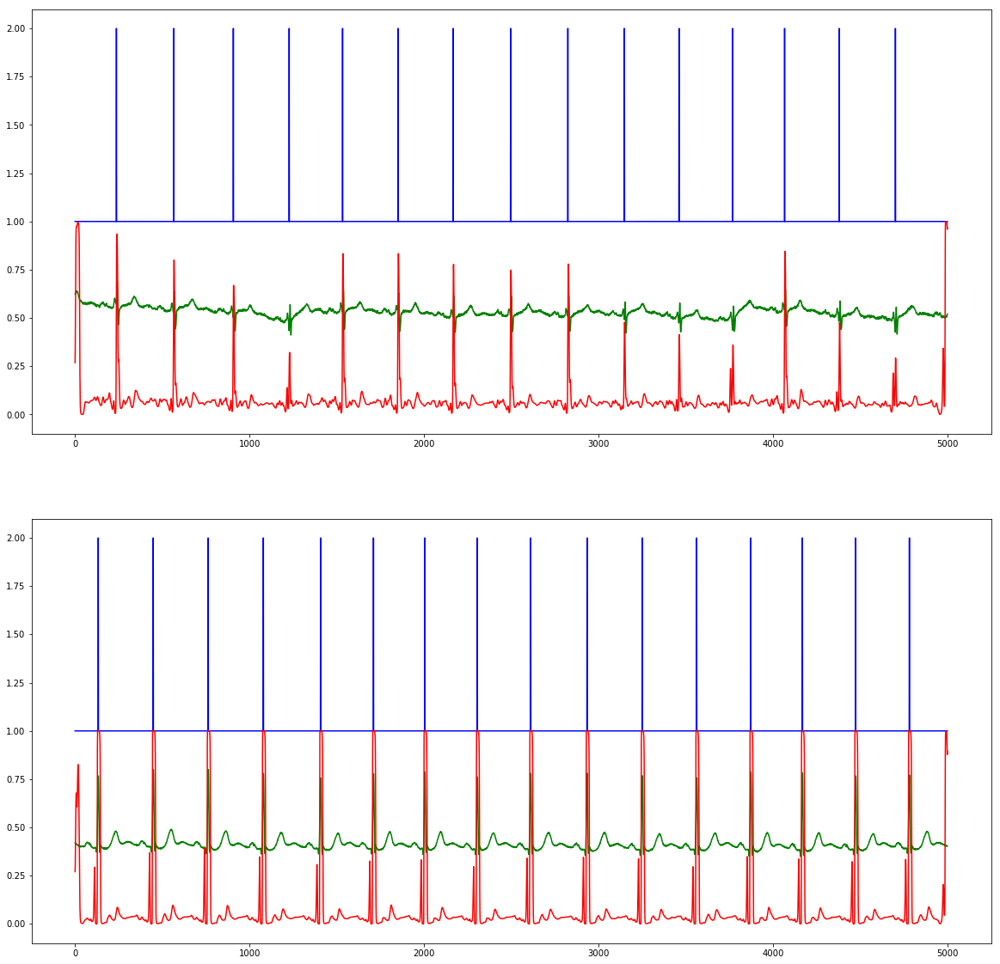

Epoch 29/100 running...Done in 4.593s!
  - training loss:		0.199256
  - test loss:			0.186514
  - test accuracy:		99.6389 %


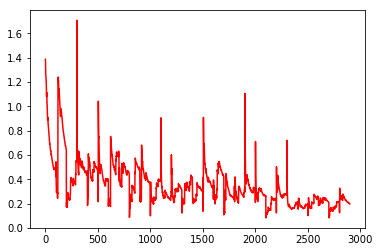

[[[ 0.30041352  0.30409274  0.34891996 ...,  0.84901613  0.81825328
    0.84658659]]]
[[[ 0.42759719  0.48481295  0.62141651 ...,  0.96980929  0.96037215
    0.96943104]]]


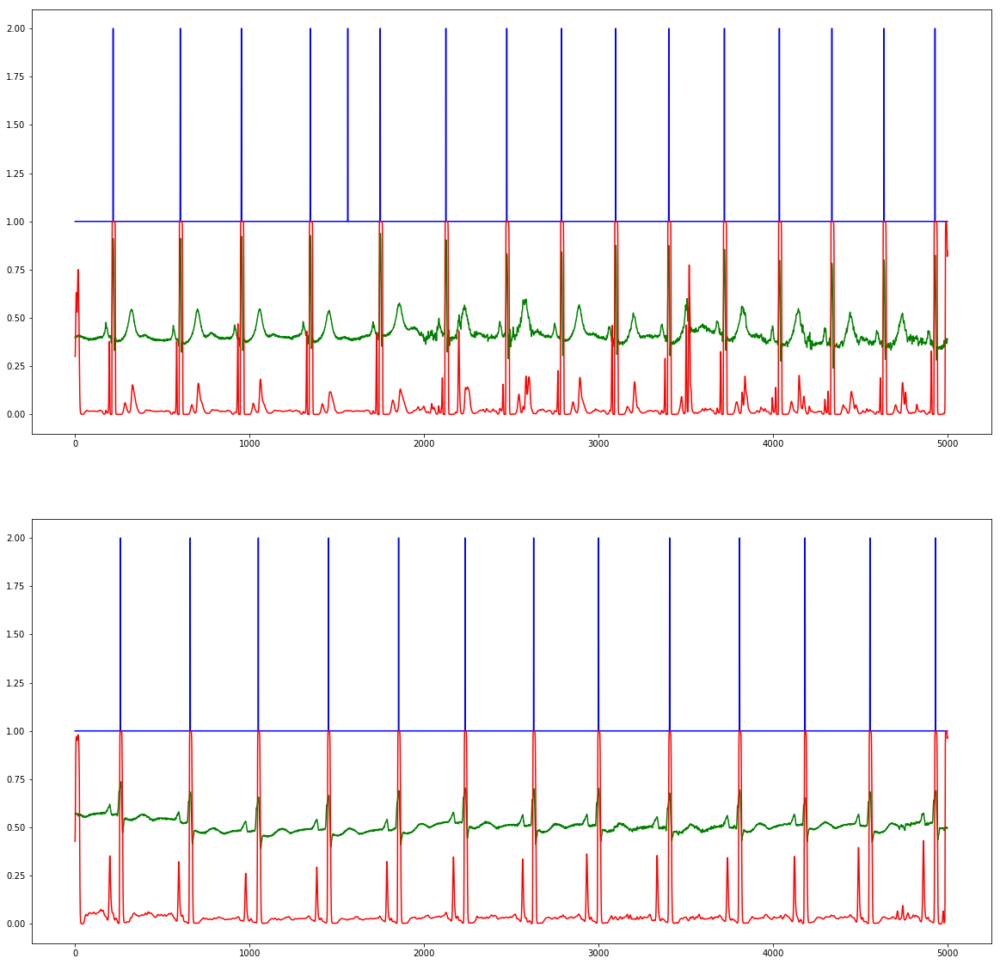

Epoch 30/100 running...Done in 4.590s!
  - training loss:		0.170096
  - test loss:			0.197254
  - test accuracy:		99.6389 %


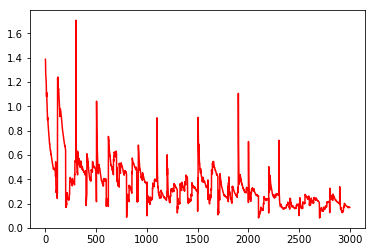

[[[ 0.86608881  0.84207845  0.82254368 ...,  0.02037791  0.01451418
    0.01656803]]]
[[[ 0.15692969  0.15673041  0.164104   ...,  0.73972124  0.70117319
    0.74236   ]]]


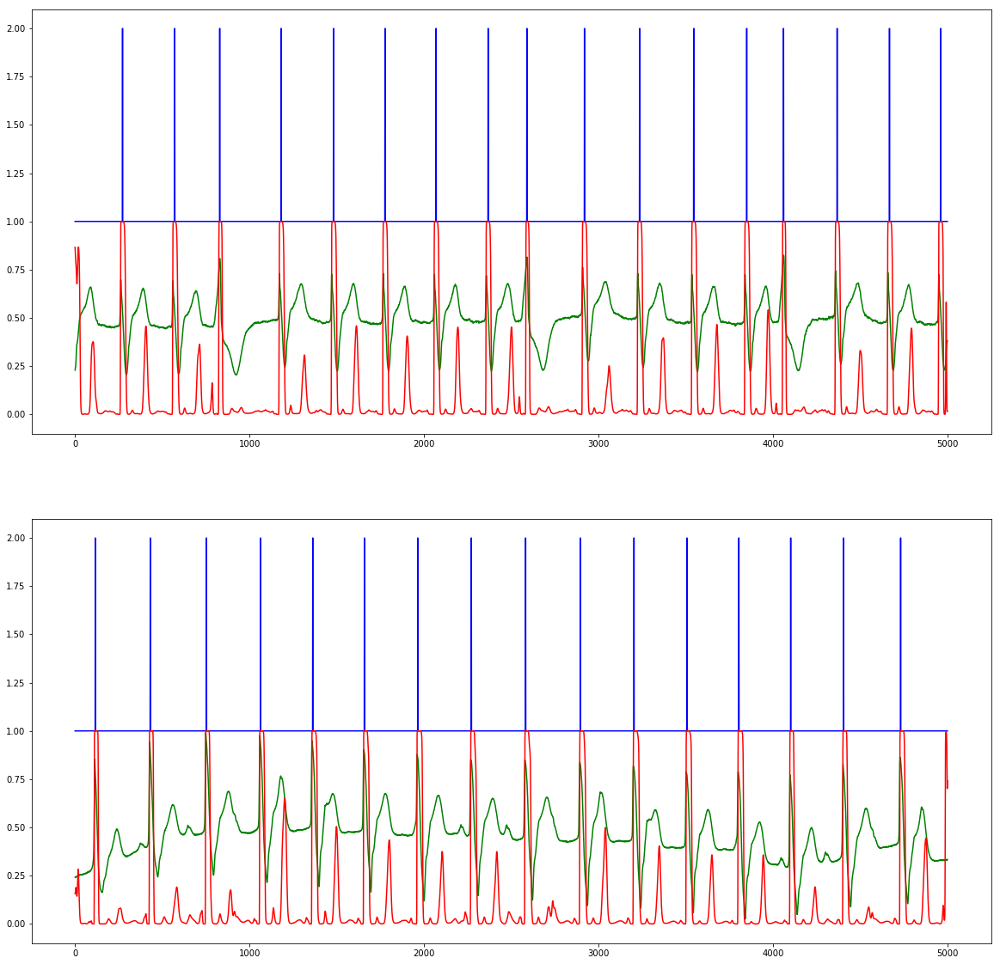

Epoch 31/100 running...Done in 4.596s!
  - training loss:		0.238080
  - test loss:			0.183958
  - test accuracy:		99.6389 %


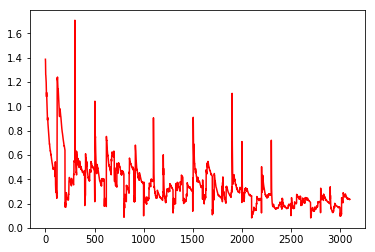

[[[ 0.85720026  0.75848931  0.61797619 ...,  0.36618018  0.33059347
    0.43209919]]]
[[[ 0.49746719  0.4923301   0.55631864 ...,  0.98637635  0.98239571
    0.98801208]]]


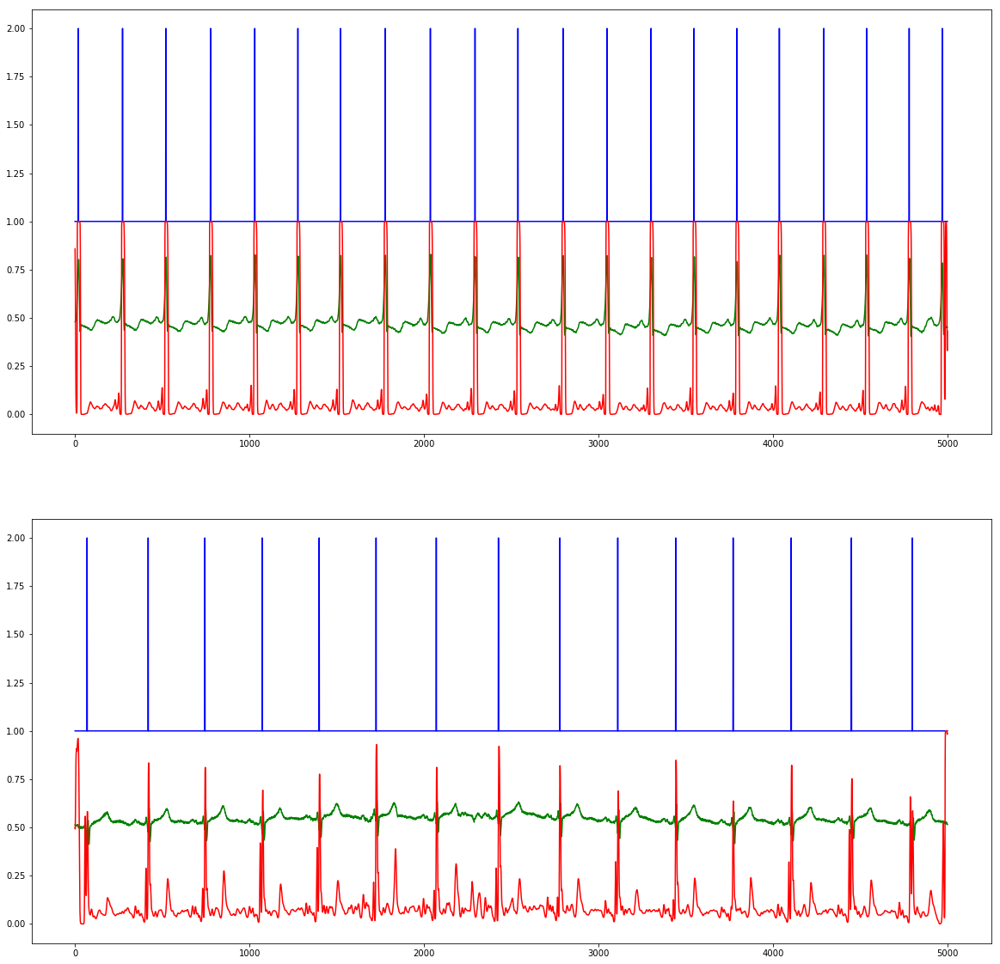

Epoch 32/100 running...Done in 4.587s!
  - training loss:		0.233529
  - test loss:			0.186783
  - test accuracy:		99.6389 %


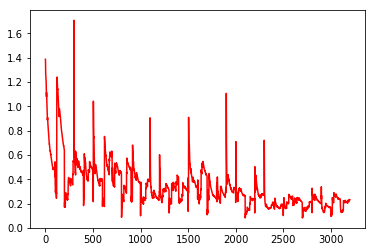

[[[ 0.8820287   0.88333309  0.91571504 ...,  0.99615991  0.99416912
    0.99634027]]]
[[[ 0.74788135  0.7403236   0.78094351 ...,  0.98362494  0.97985131
    0.98746568]]]


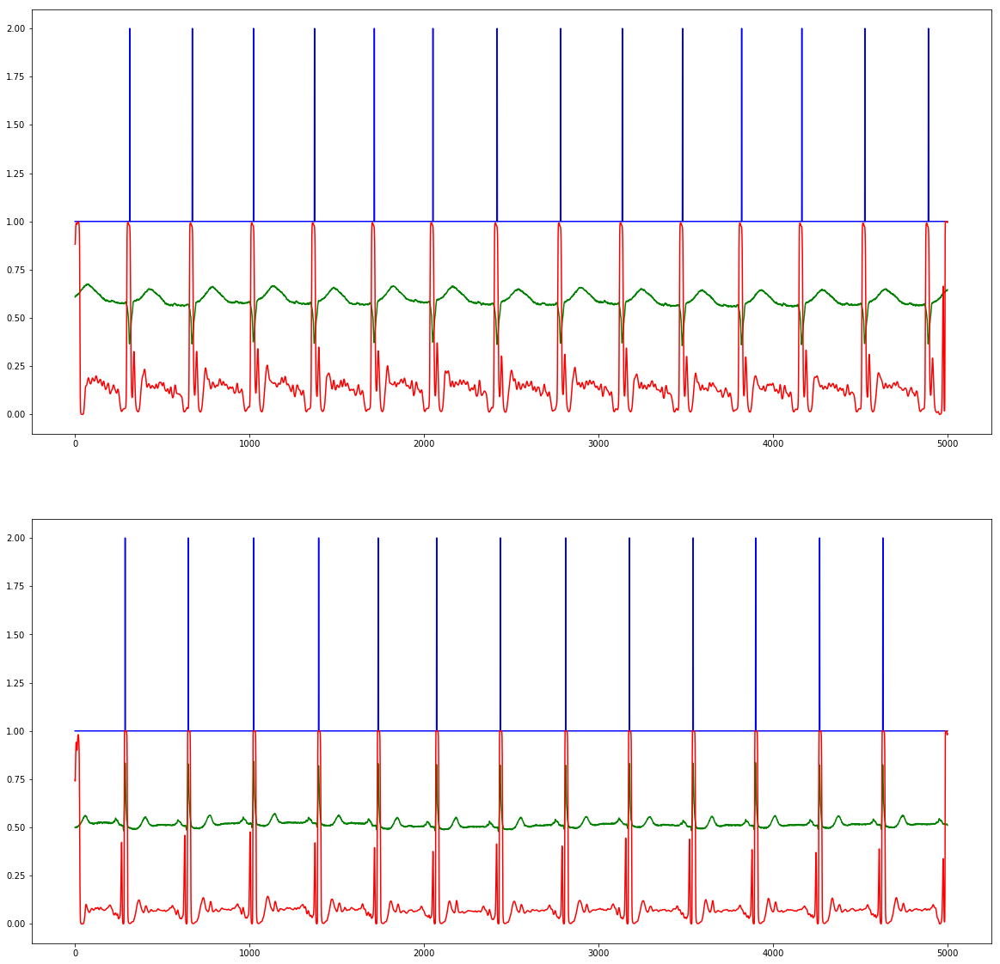

Epoch 33/100 running...Done in 4.592s!
  - training loss:		0.178548
  - test loss:			0.172444
  - test accuracy:		99.6389 %


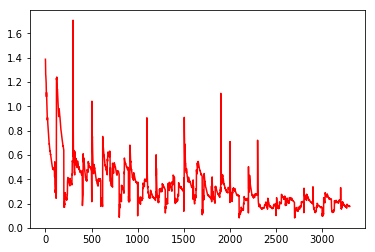

[[[ 0.04441302  0.04305567  0.05751188 ...,  0.74906069  0.7346524
    0.80551535]]]
[[[ 0.77264553  0.76133448  0.80503869 ...,  0.97966939  0.97207505
    0.98222488]]]


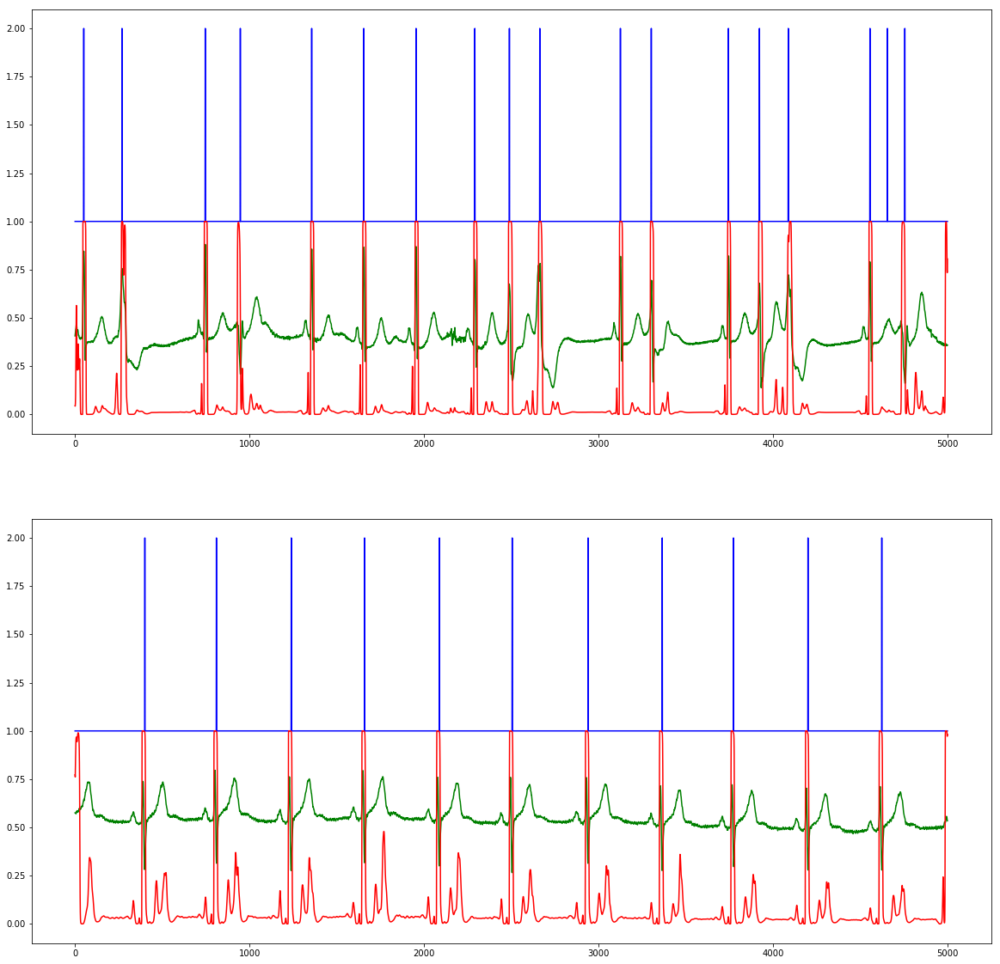

Epoch 34/100 running...Done in 4.596s!
  - training loss:		0.145116
  - test loss:			0.236284
  - test accuracy:		99.6389 %


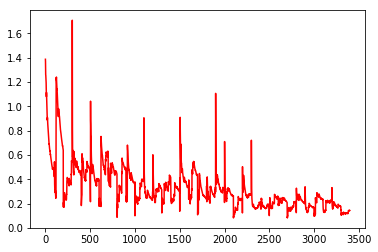

[[[ 0.12933616  0.13049467  0.14922465 ...,  0.01260867  0.01053118
    0.01430198]]]
[[[ 0.04327108  0.05028075  0.08034806 ...,  0.33911842  0.27518925
    0.32416585]]]


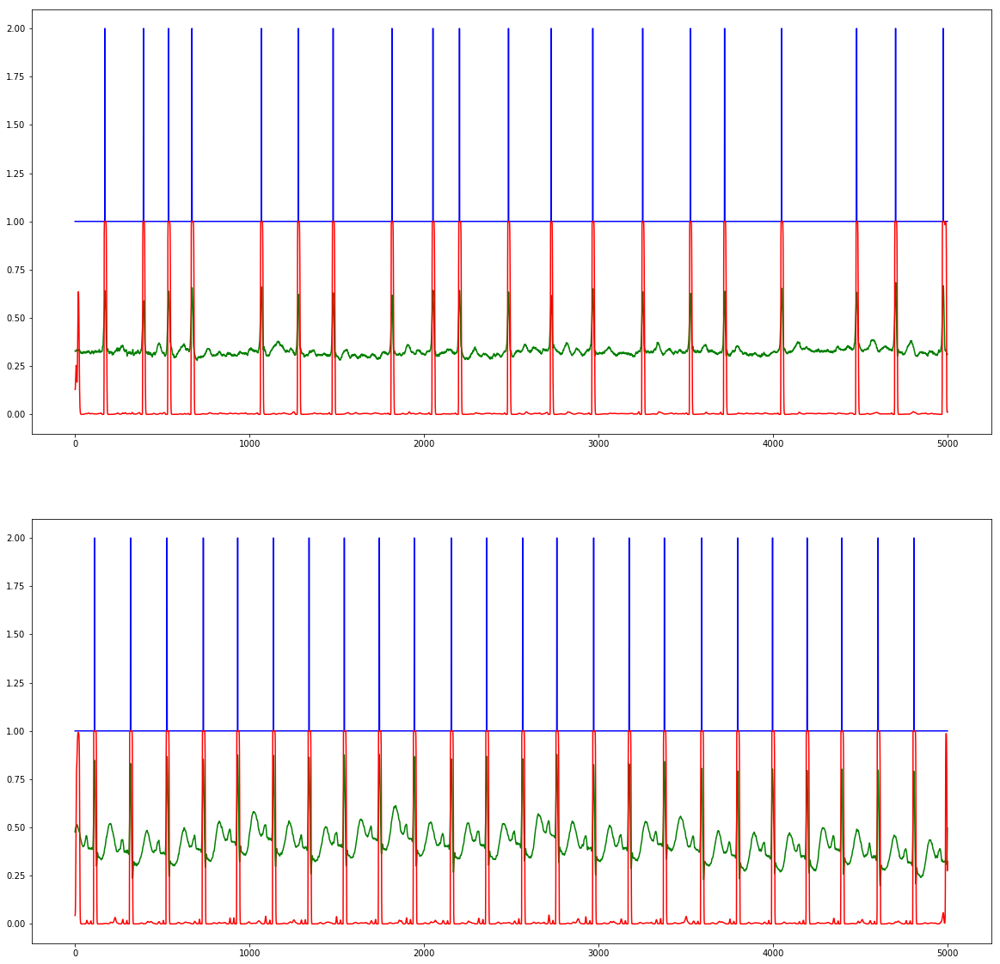

Epoch 35/100 running...Done in 4.580s!
  - training loss:		0.238157
  - test loss:			0.231704
  - test accuracy:		99.6389 %


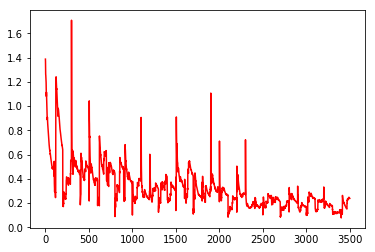

[[[ 0.16914202  0.1707429   0.19466732 ...,  0.72784346  0.702788
    0.78332299]]]
[[[ 0.97761476  0.99879563  0.99992287 ...,  0.66127676  0.63939923
    0.73004889]]]


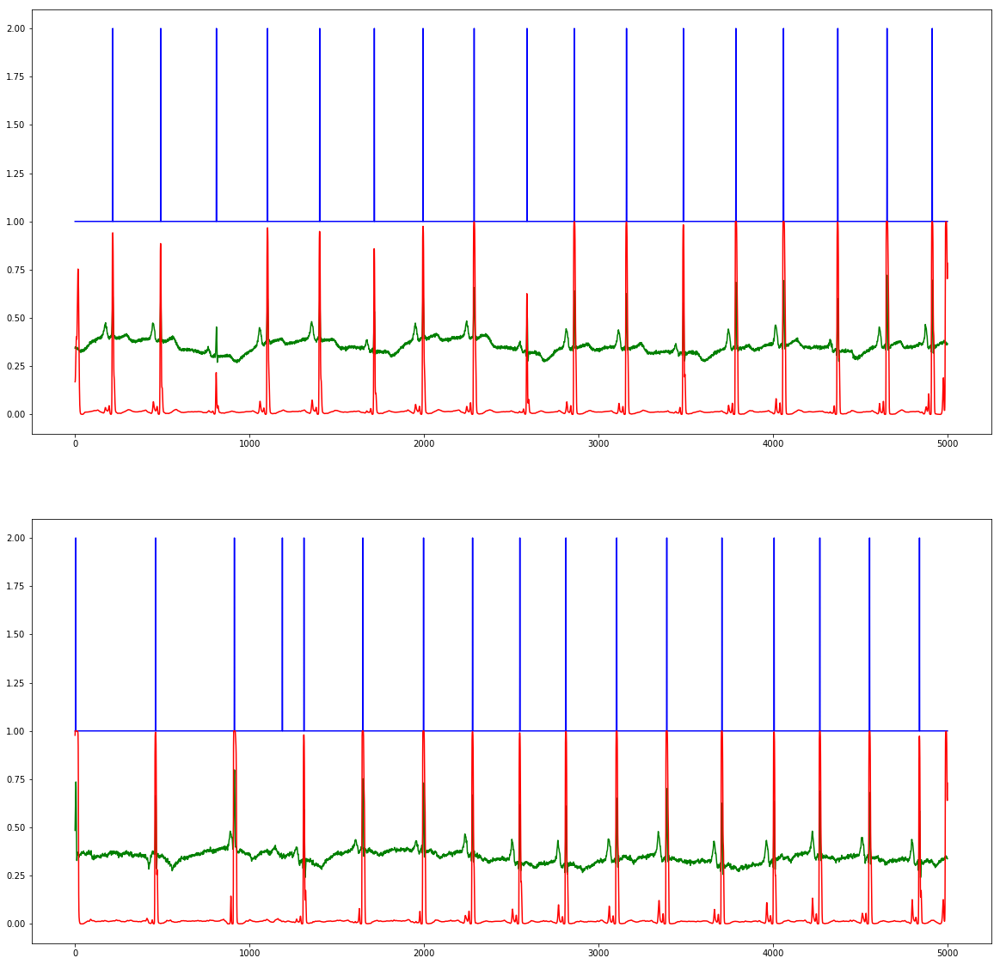

Epoch 36/100 running...Done in 4.648s!
  - training loss:		0.198084
  - test loss:			0.233252
  - test accuracy:		99.6389 %


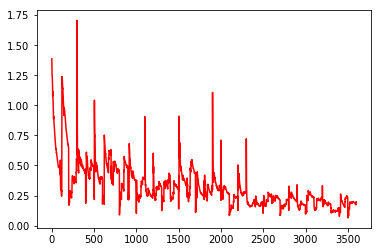

[[[ 0.54129374  0.45219833  0.41184816 ...,  0.01480453  0.00905453
    0.00691599]]]
[[[ 0.22713456  0.19081303  0.17723161 ...,  0.37213656  0.3737849
    0.51365548]]]


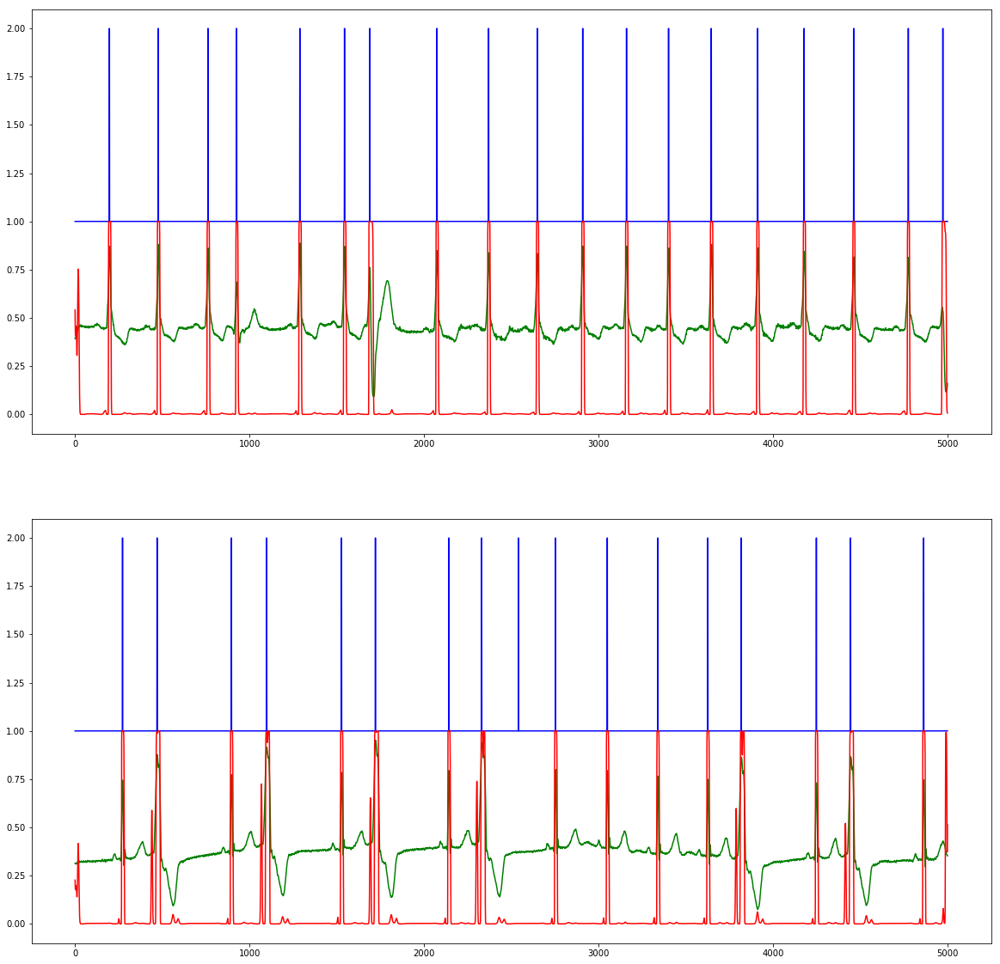

Epoch 37/100 running...Done in 4.593s!
  - training loss:		0.240853
  - test loss:			0.200516
  - test accuracy:		99.6389 %


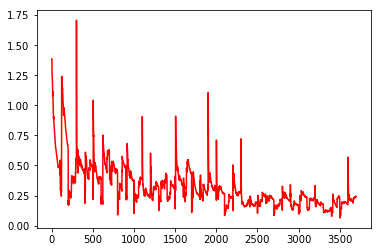

[[[ 0.41099954  0.39256078  0.42194077 ...,  0.0320827   0.02460061
    0.03944539]]]
[[[ 0.94250304  0.98596919  0.99687129 ...,  0.71807915  0.70303822
    0.81864512]]]


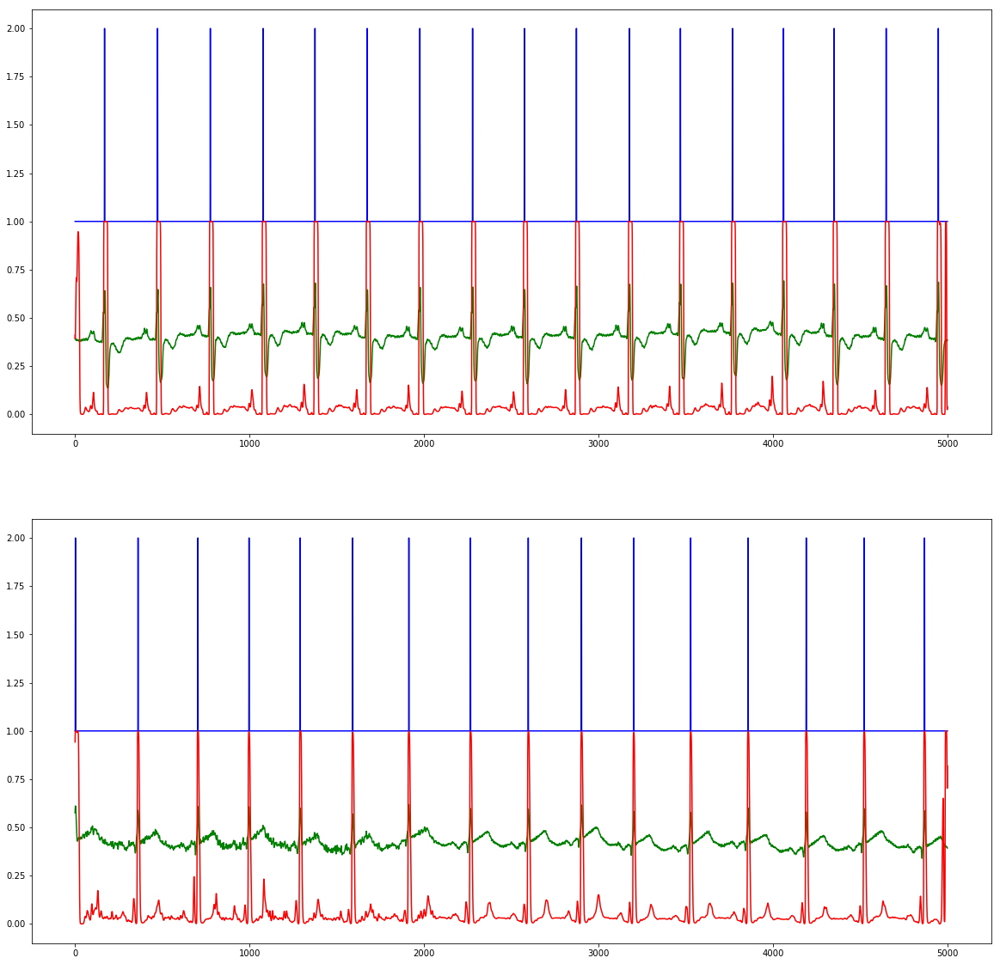

Epoch 38/100 running...Done in 4.634s!
  - training loss:		0.150294
  - test loss:			0.174756
  - test accuracy:		99.6389 %


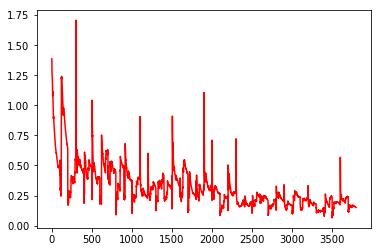

[[[ 0.69669747  0.67583209  0.7339161  ...,  0.85641867  0.84722102
    0.94045907]]]
[[[ 0.34970328  0.31203556  0.30691299 ...,  0.30716485  0.28772348
    0.42625907]]]


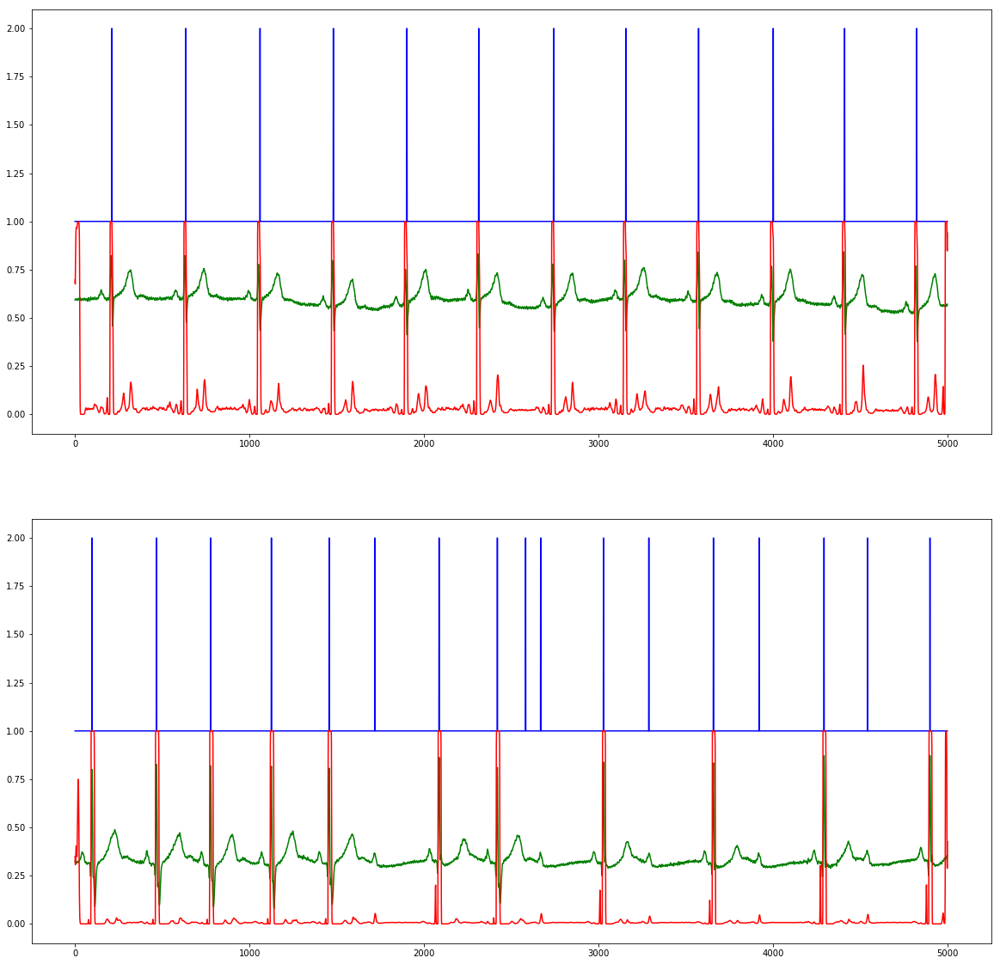

Epoch 39/100 running...Done in 4.661s!
  - training loss:		0.185776
  - test loss:			0.173527
  - test accuracy:		99.6389 %


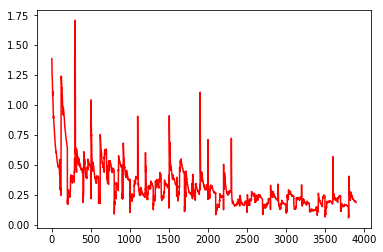

[[[ 0.86926562  0.62488931  0.24782616 ...,  0.66599822  0.66361159
    0.82309186]]]
[[[ 0.31326389  0.27586162  0.27530977 ...,  0.16932701  0.20370743
    0.37432593]]]


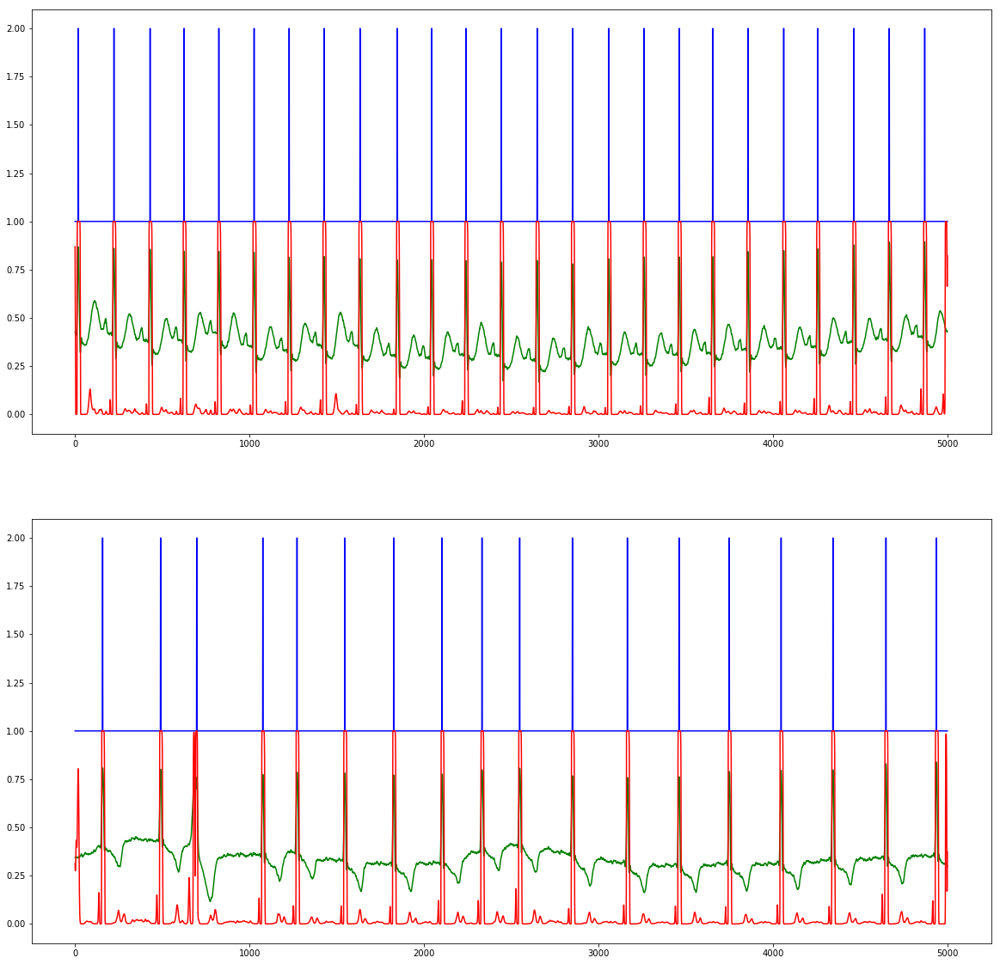

Epoch 40/100 running...Done in 4.630s!
  - training loss:		0.113849
  - test loss:			0.205620
  - test accuracy:		99.6389 %


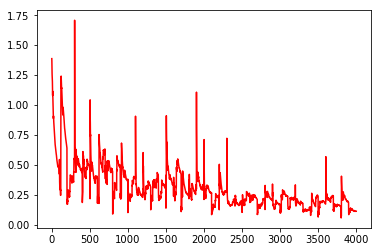

[[[ 0.40296927  0.32256207  0.31751603 ...,  0.36505497  0.37390915
    0.5950563 ]]]
[[[ 0.38180789  0.32604218  0.30414137 ...,  0.00054181  0.00043726
    0.00070355]]]


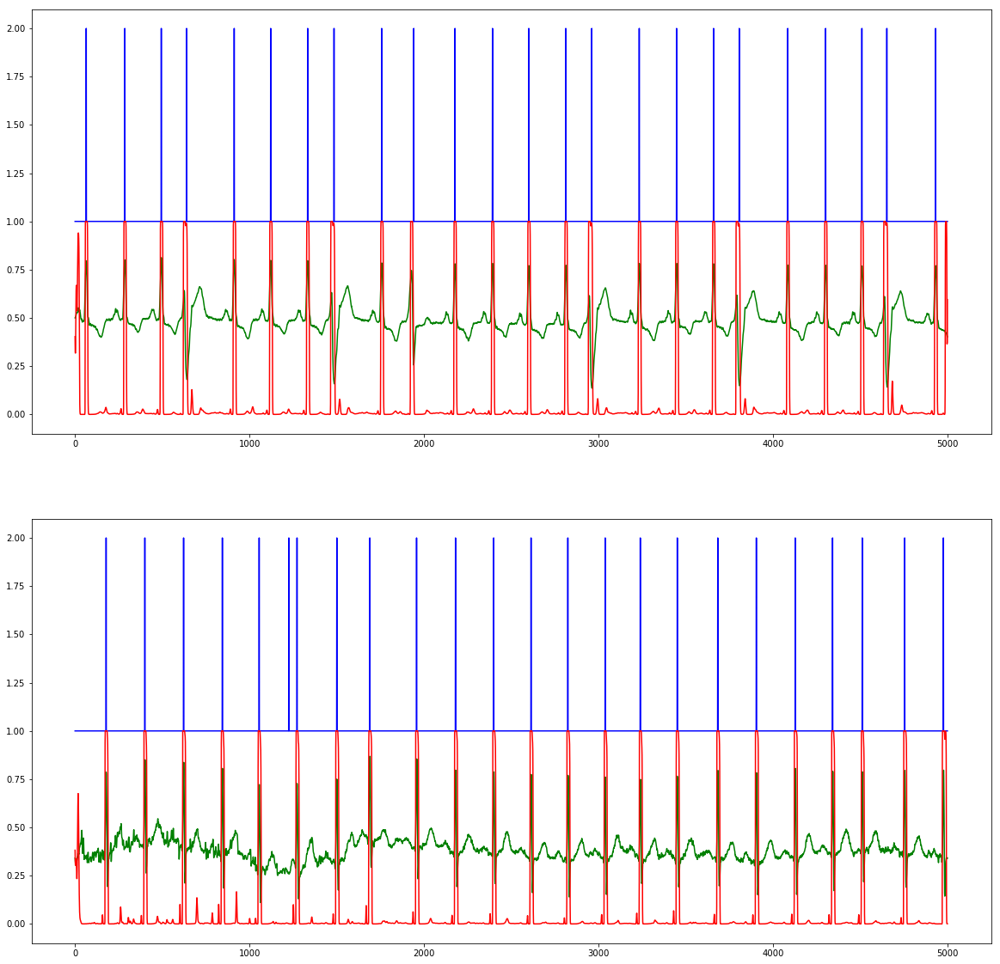

Epoch 41/100 running...Done in 4.638s!
  - training loss:		0.191306
  - test loss:			0.168759
  - test accuracy:		99.6389 %


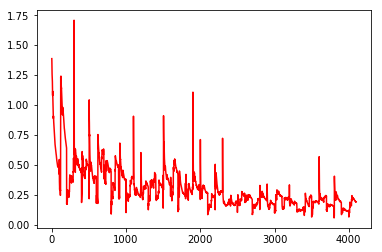

[[[ 0.65604228  0.5695135   0.5355047  ...,  0.45840505  0.46199757
    0.65884113]]]
[[[ 0.60014719  0.52855963  0.53967839 ...,  0.22574708  0.23722532
    0.49171692]]]


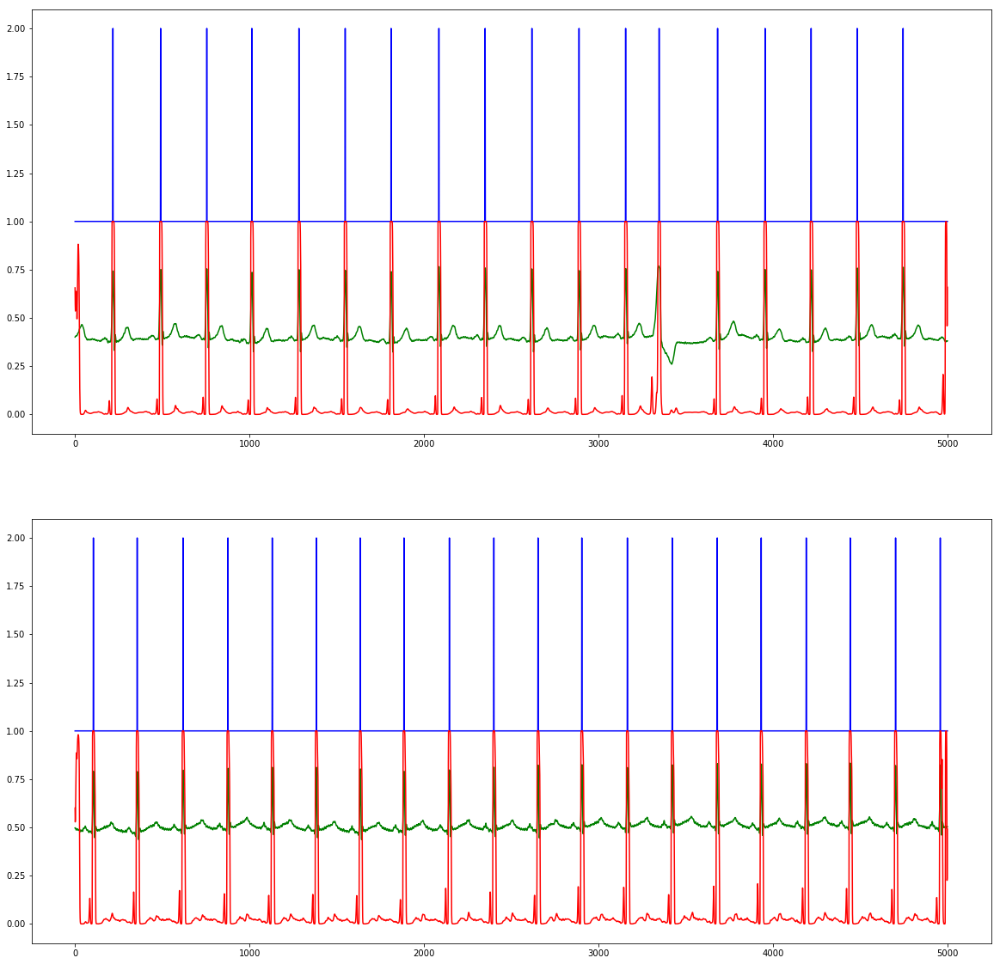

Epoch 42/100 running...Done in 4.643s!
  - training loss:		0.145701
  - test loss:			0.210868
  - test accuracy:		99.6389 %


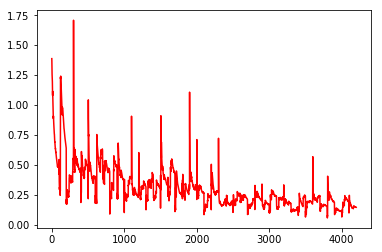

[[[ 0.33411241  0.27905378  0.28674591 ...,  0.00045191  0.00060609
    0.00202594]]]
[[[ 0.18526487  0.2187248   0.33319679 ...,  0.26587835  0.25999606
    0.46474972]]]


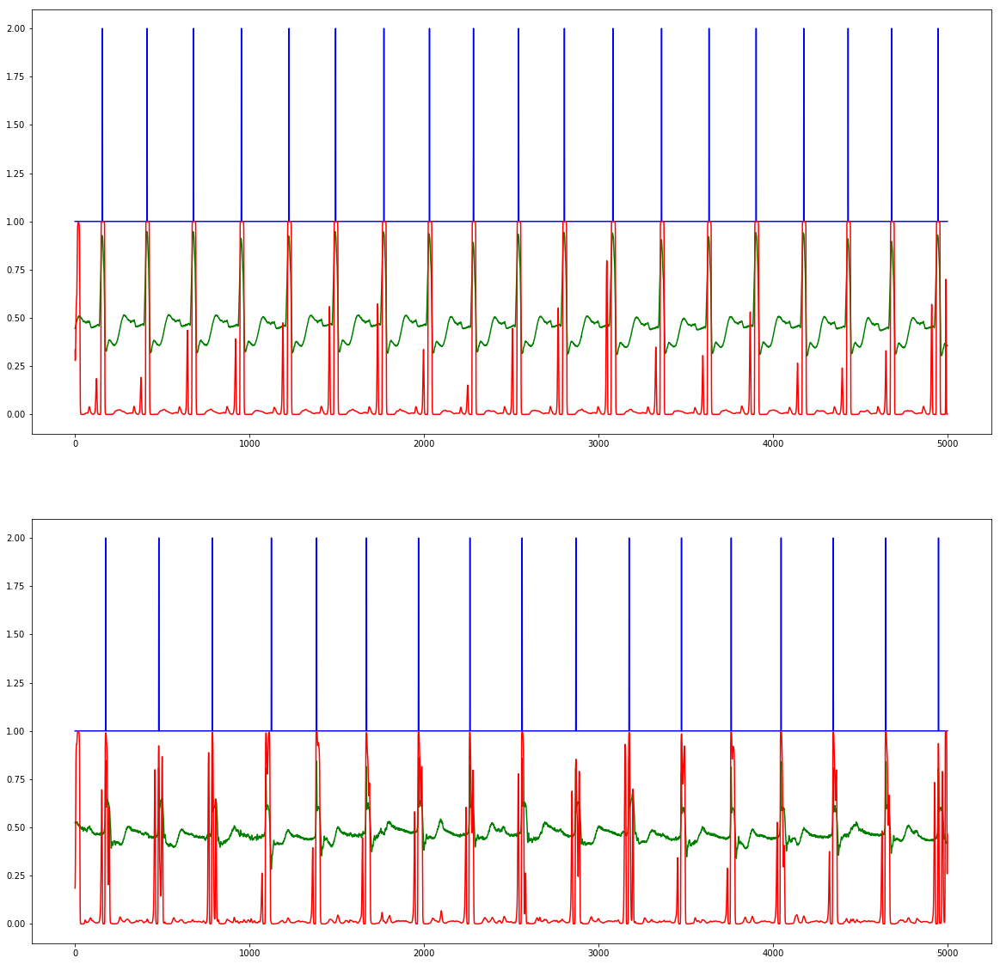

Epoch 43/100 running...Done in 4.623s!
  - training loss:		0.156409
  - test loss:			0.153461
  - test accuracy:		99.6389 %


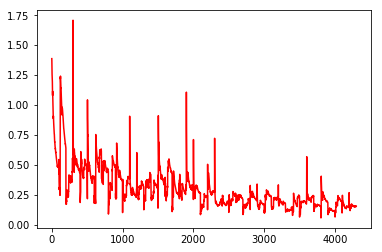

[[[ 0.45325926  0.36697963  0.34953094 ...,  0.61982703  0.65330356
    0.84708983]]]
[[[ 0.91604471  0.85198987  0.79866314 ...,  0.9942292   0.97928476
    0.98347396]]]


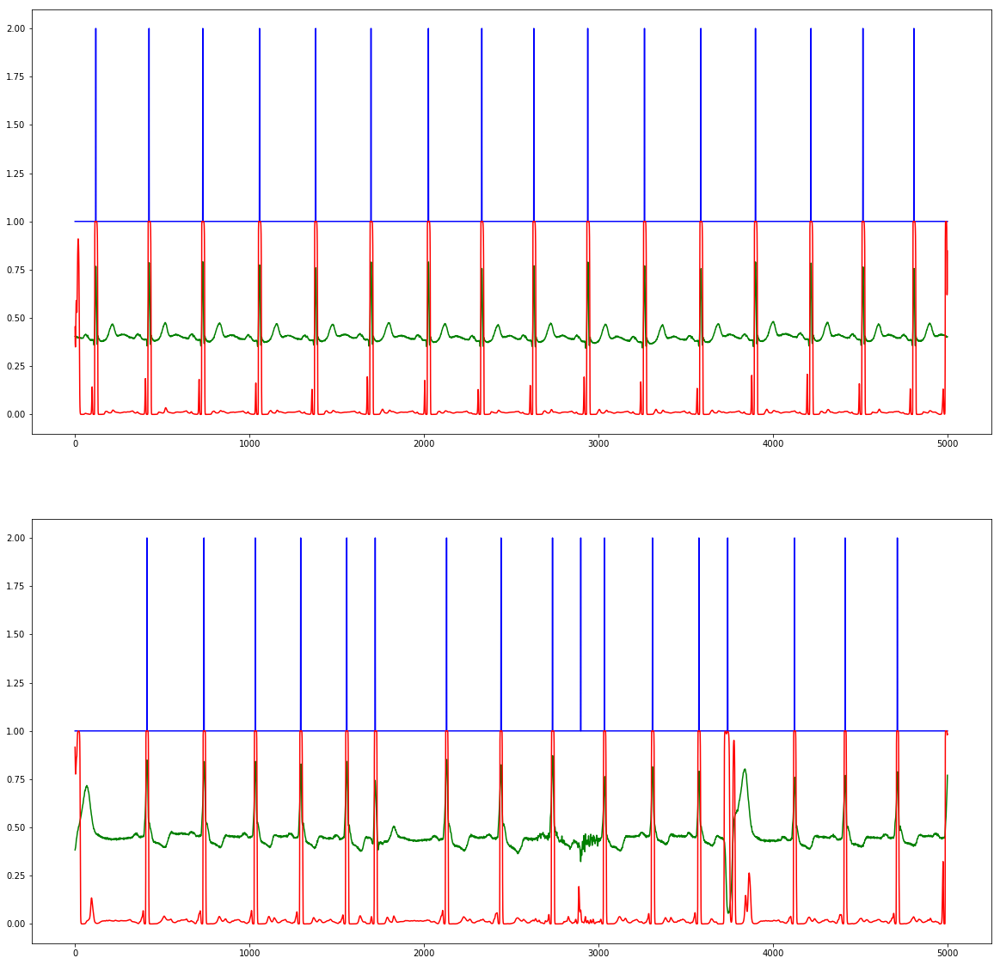

Epoch 44/100 running...Done in 4.597s!
  - training loss:		0.118882
  - test loss:			0.148551
  - test accuracy:		99.6389 %


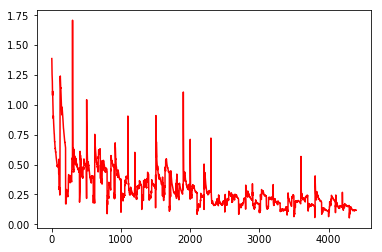

[[[ 0.06317506  0.05207494  0.05103914 ...,  0.42367306  0.44950572
    0.69341034]]]
[[[ 0.3939732   0.29541573  0.23976704 ...,  0.51490843  0.57572603
    0.80480093]]]


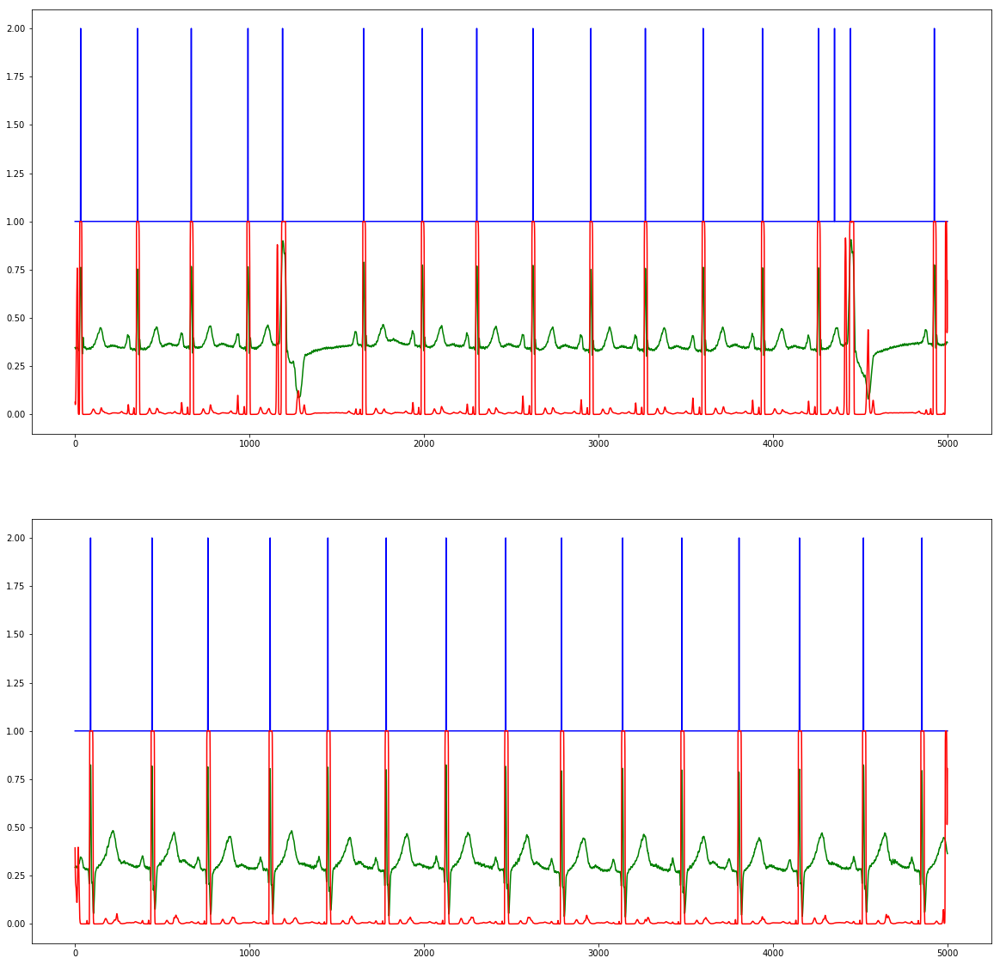

Epoch 45/100 running...Done in 4.613s!
  - training loss:		0.170786
  - test loss:			0.197839
  - test accuracy:		99.6389 %


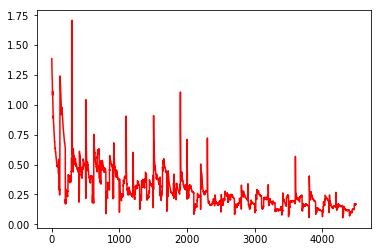

[[[ 0.92045659  0.82323879  0.72314024 ...,  0.97573322  0.95986527
    0.98896873]]]
[[[ 0.58441502  0.45310605  0.38664192 ...,  0.42692217  0.47565091
    0.73949635]]]


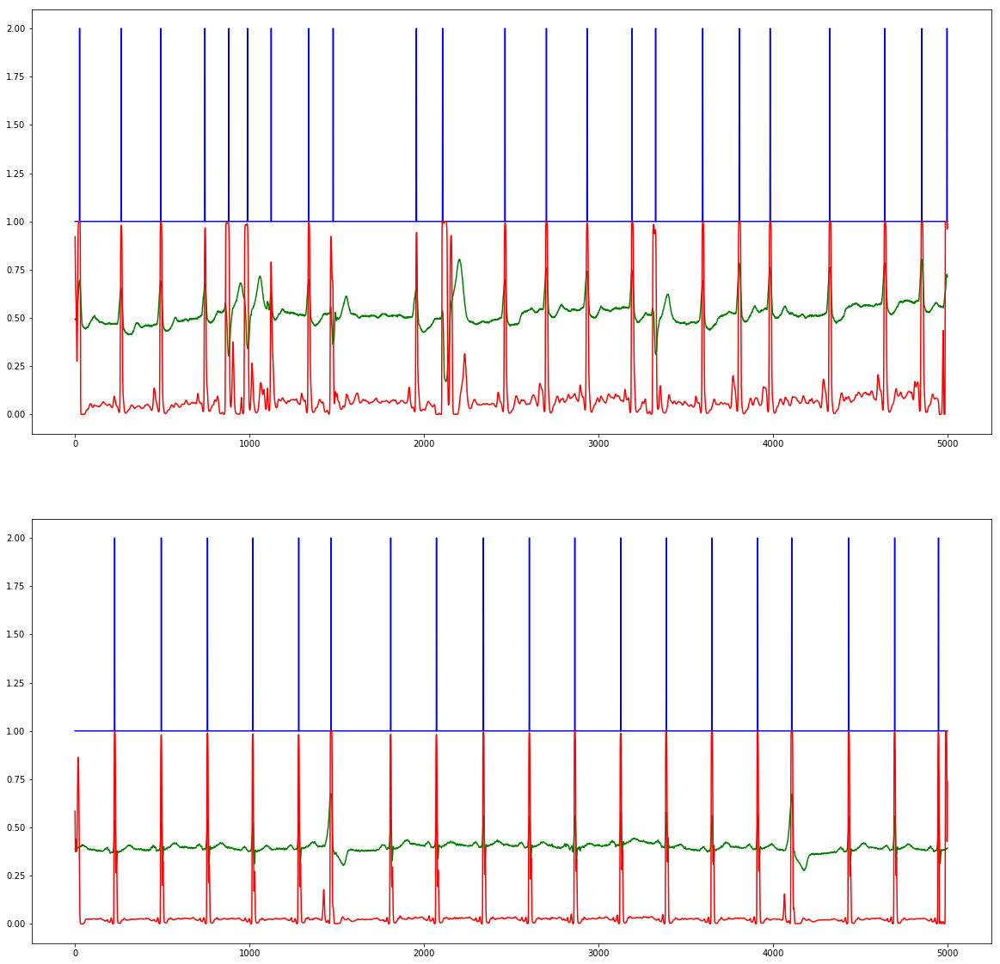

Epoch 46/100 running...Done in 4.577s!
  - training loss:		0.173526
  - test loss:			0.152452
  - test accuracy:		99.6389 %


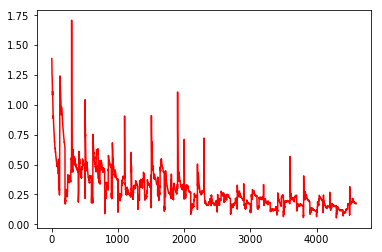

[[[ 0.63400465  0.44869995  0.37166587 ...,  0.9098348   0.9358303
    0.98953164]]]
[[[ 0.31836611  0.20977813  0.16112855 ...,  0.1689667   0.22493799
    0.46224919]]]


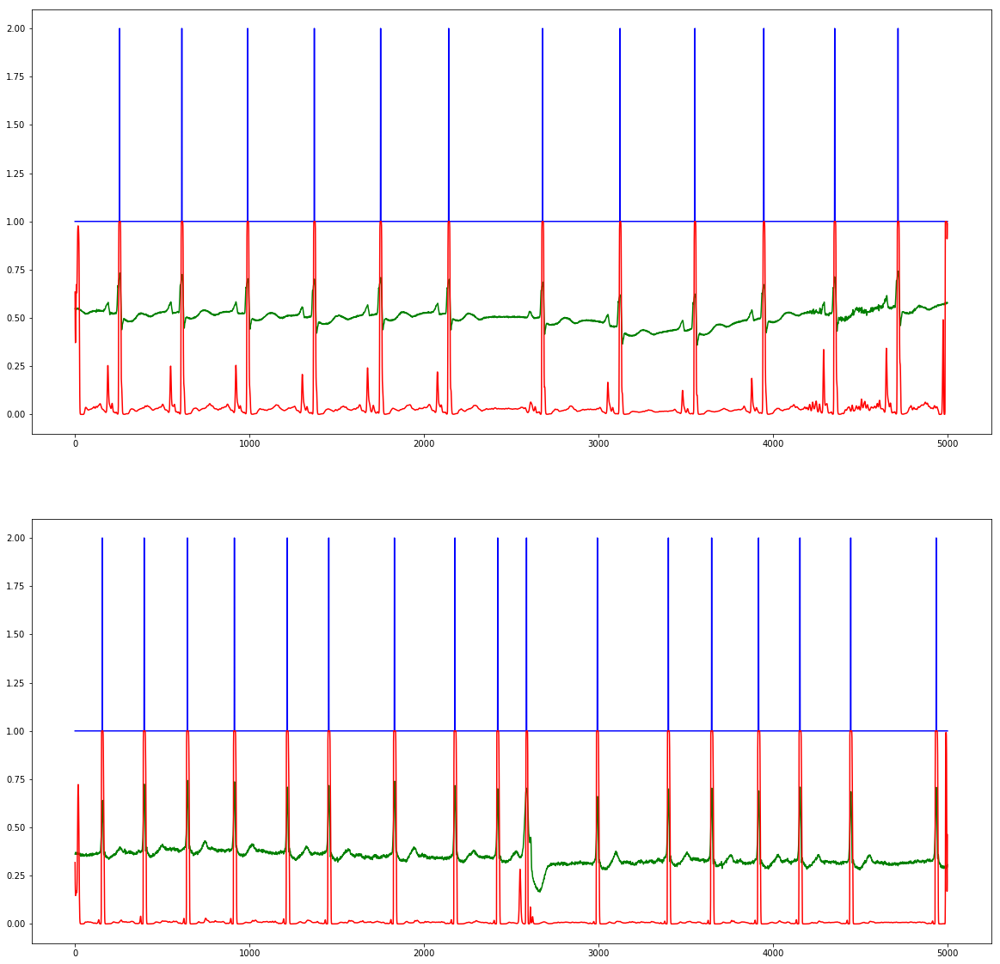

Epoch 47/100 running...Done in 4.584s!
  - training loss:		0.171739
  - test loss:			0.158626
  - test accuracy:		99.6389 %


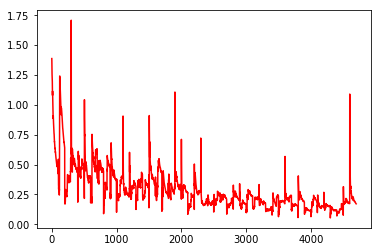

[[[ 0.1802648   0.12966524  0.11259823 ...,  0.25522318  0.28580979
    0.63568807]]]
[[[ 0.71513975  0.52339256  0.44963276 ...,  0.78603661  0.84529501
    0.97662133]]]


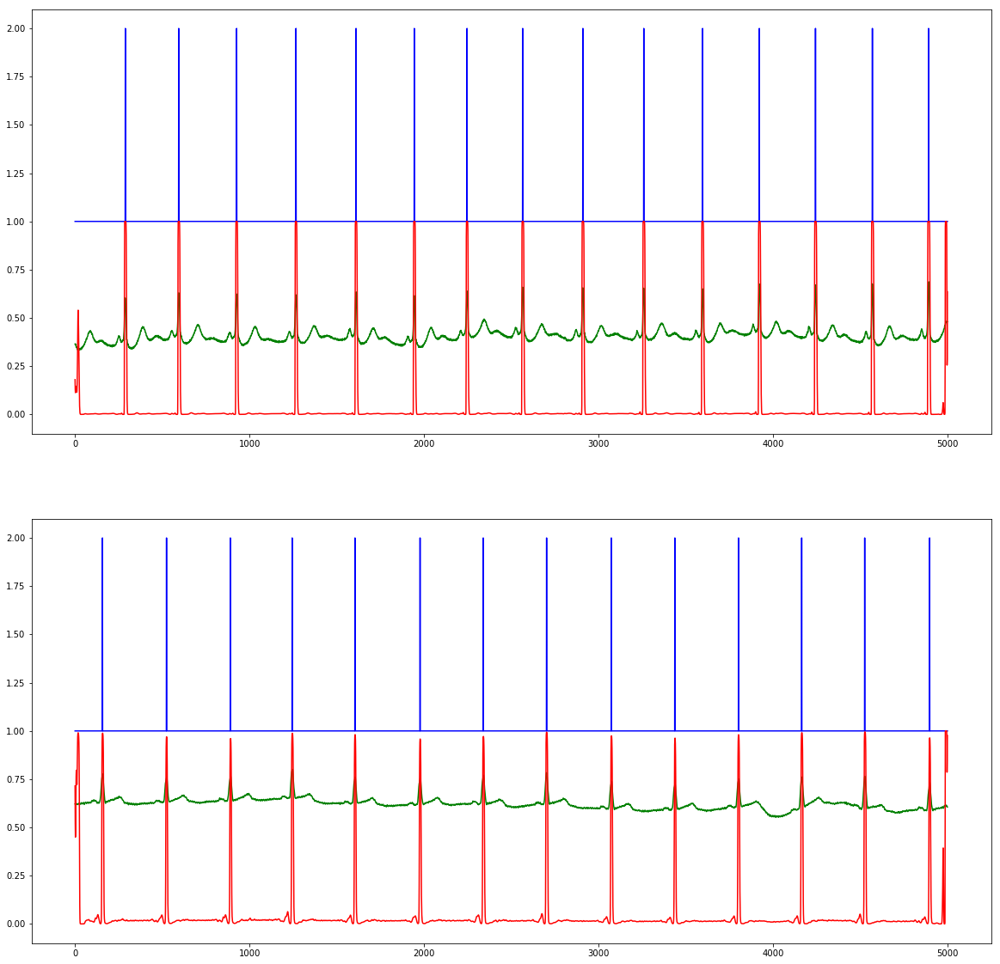

Epoch 48/100 running...Done in 4.597s!
  - training loss:		0.180030
  - test loss:			0.162773
  - test accuracy:		99.6389 %


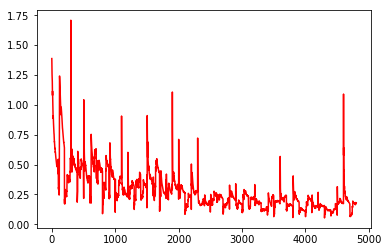

[[[ 0.07612354  0.01494797  0.00406621 ...,  0.81143045  0.86171371
    0.97025853]]]
[[[ 0.92409205  0.79842788  0.69653666 ...,  0.96631104  0.97890466
    0.99784005]]]


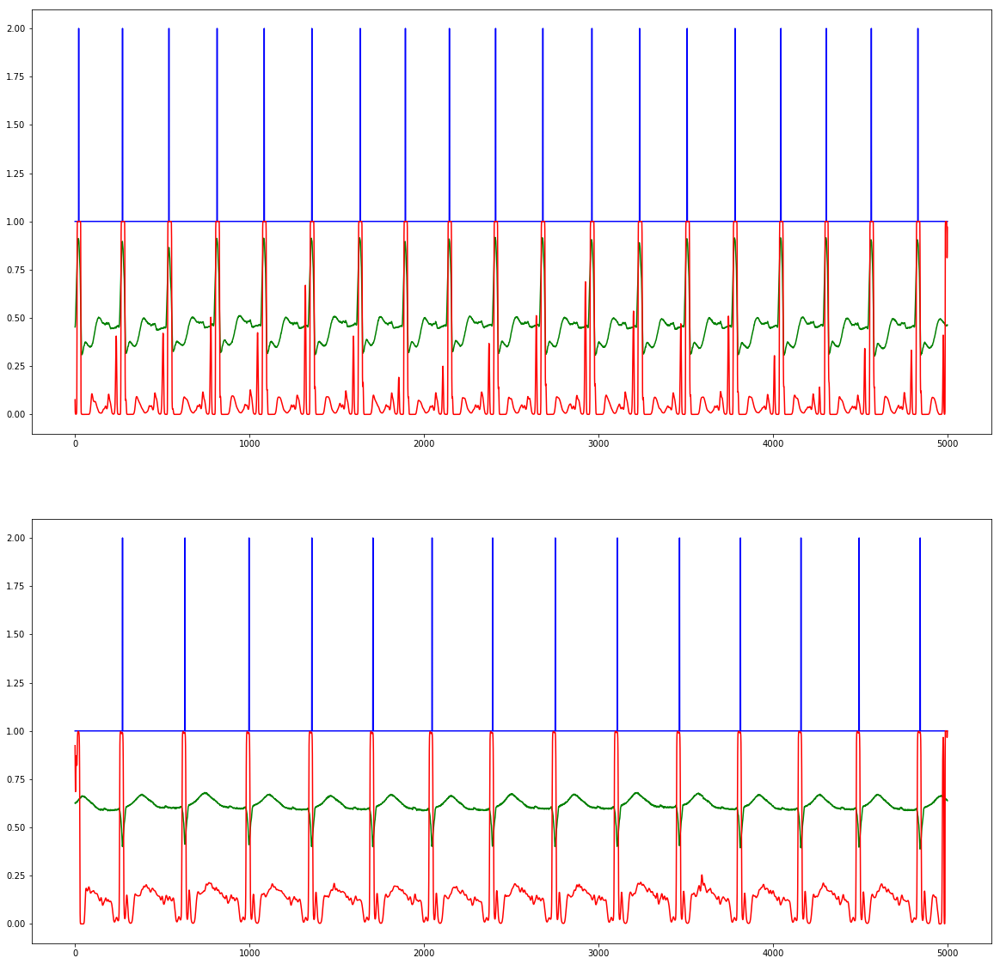

Epoch 49/100 running...Done in 4.596s!
  - training loss:		0.139431
  - test loss:			0.154864
  - test accuracy:		99.6389 %


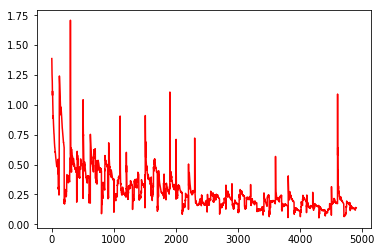

[[[ 0.83669811  0.61475289  0.46423781 ...,  0.71637082  0.78159565
    0.9549827 ]]]
[[[ 0.22947814  0.19193302  0.23497871 ...,  0.0920639   0.05060058
    0.10517398]]]


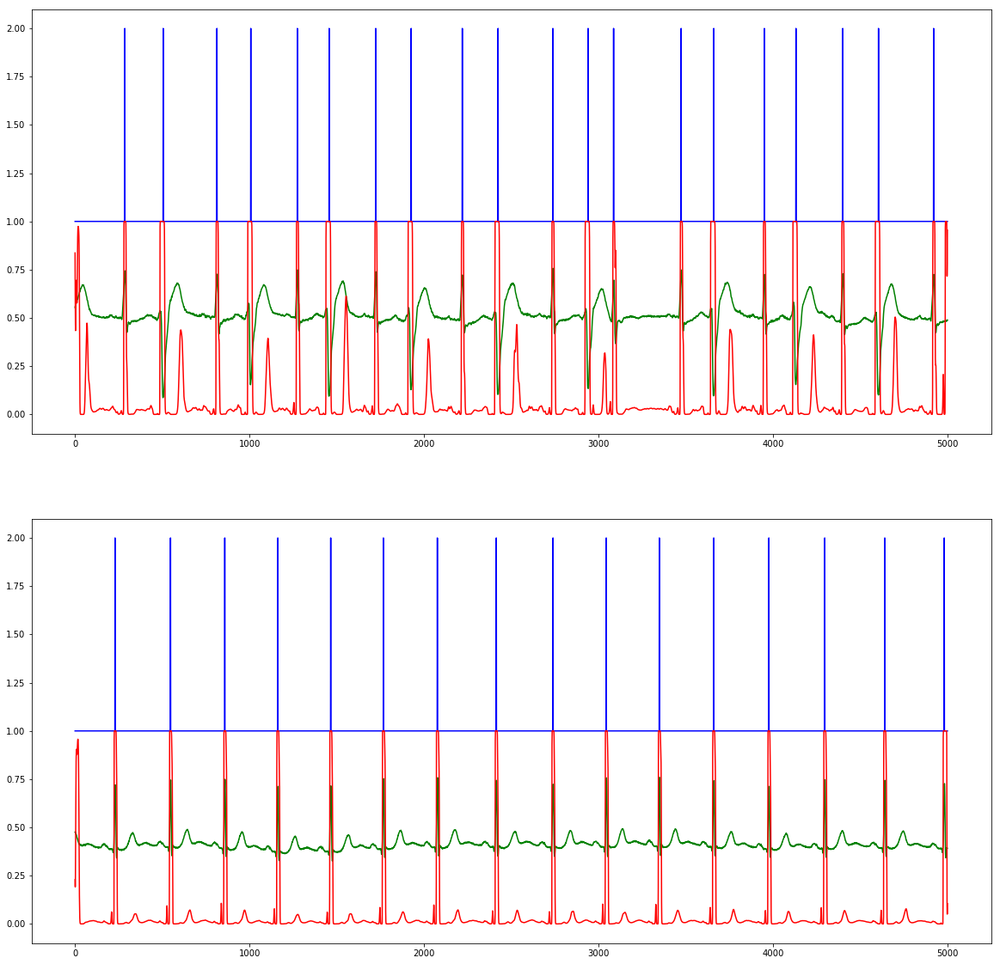

Epoch 50/100 running...Done in 4.585s!
  - training loss:		0.165974
  - test loss:			0.155957
  - test accuracy:		99.6389 %


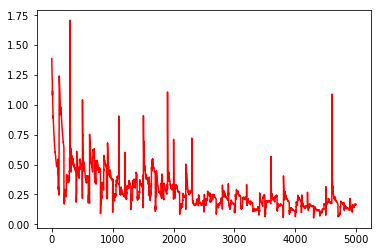

[[[ 0.66824496  0.4583731   0.36244434 ...,  0.88375306  0.9067899
    0.98345125]]]
[[[ 0.95909637  0.87099659  0.78843963 ...,  0.91519105  0.88030088
    0.97128087]]]


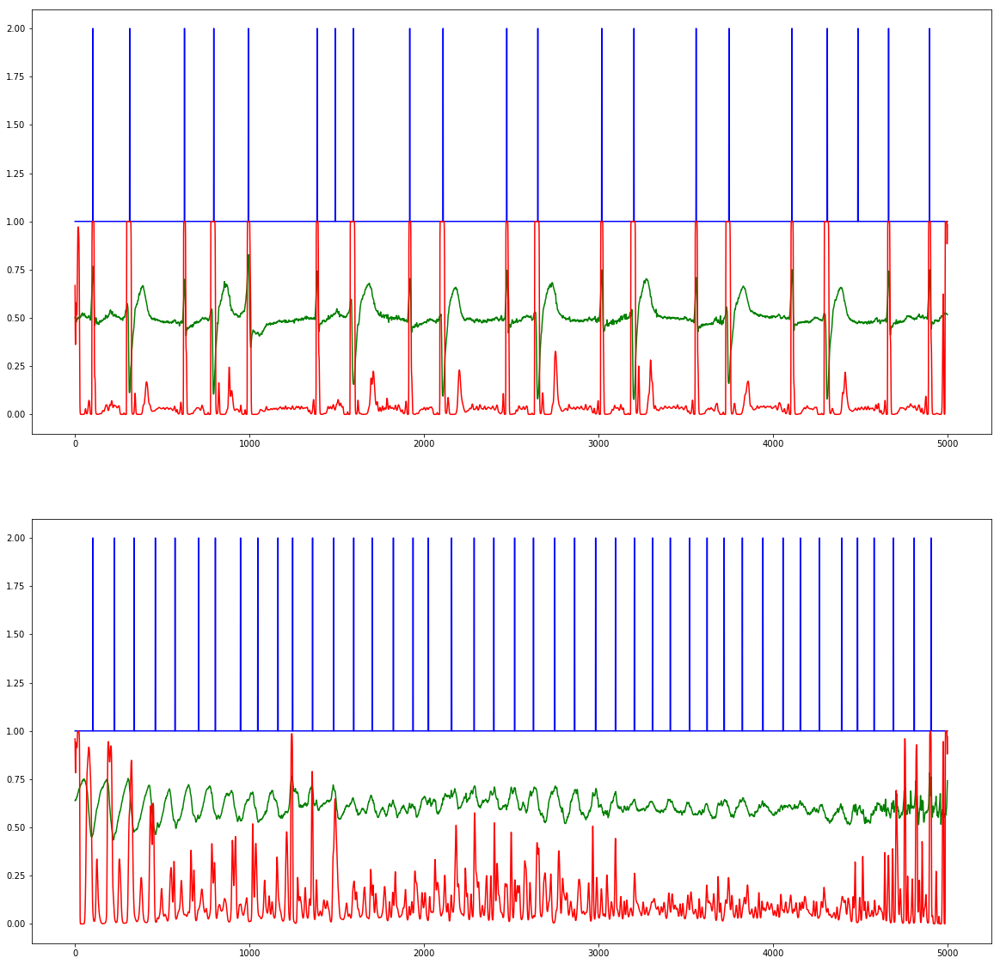

Epoch 51/100 running...Done in 4.638s!
  - training loss:		0.149326
  - test loss:			0.139485
  - test accuracy:		99.6389 %


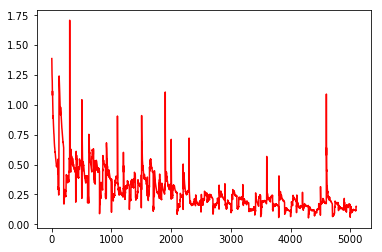

[[[ 0.6679244   0.3890081   0.25201395 ...,  0.84227067  0.87903905
    0.98100841]]]
[[[ 0.39010441  0.20234554  0.12178554 ...,  0.36112112  0.46287951
    0.83274943]]]


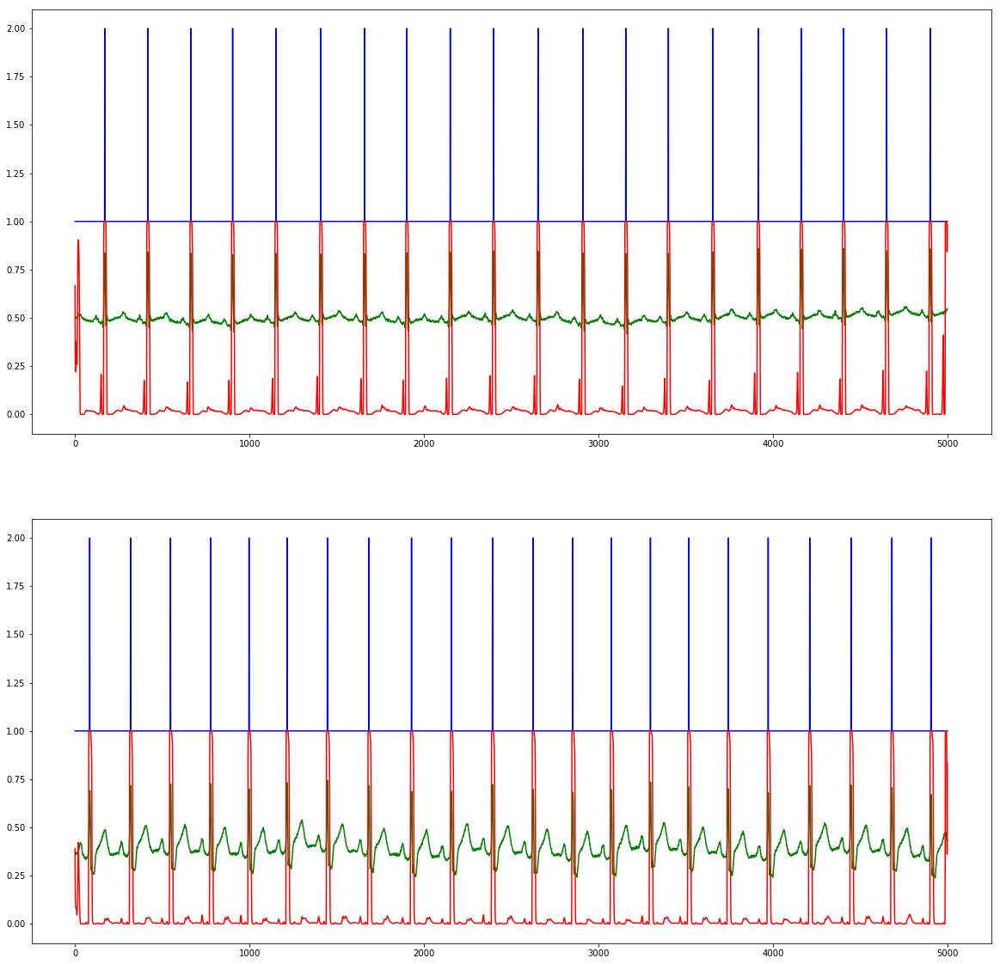

Epoch 52/100 running...Done in 4.660s!
  - training loss:		0.165624
  - test loss:			0.148571
  - test accuracy:		99.6389 %


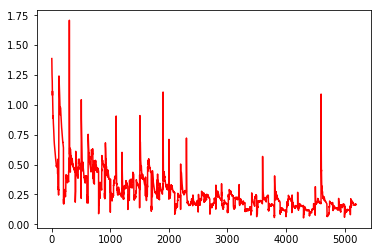

[[[ 0.31237528  0.1338264   0.07959829 ...,  0.03766669  0.04254996
    0.18096818]]]
[[[  2.69372802e-04   3.00598658e-05   7.73127977e-06 ...,   9.95252490e-01
     9.94757533e-01   9.94429767e-01]]]


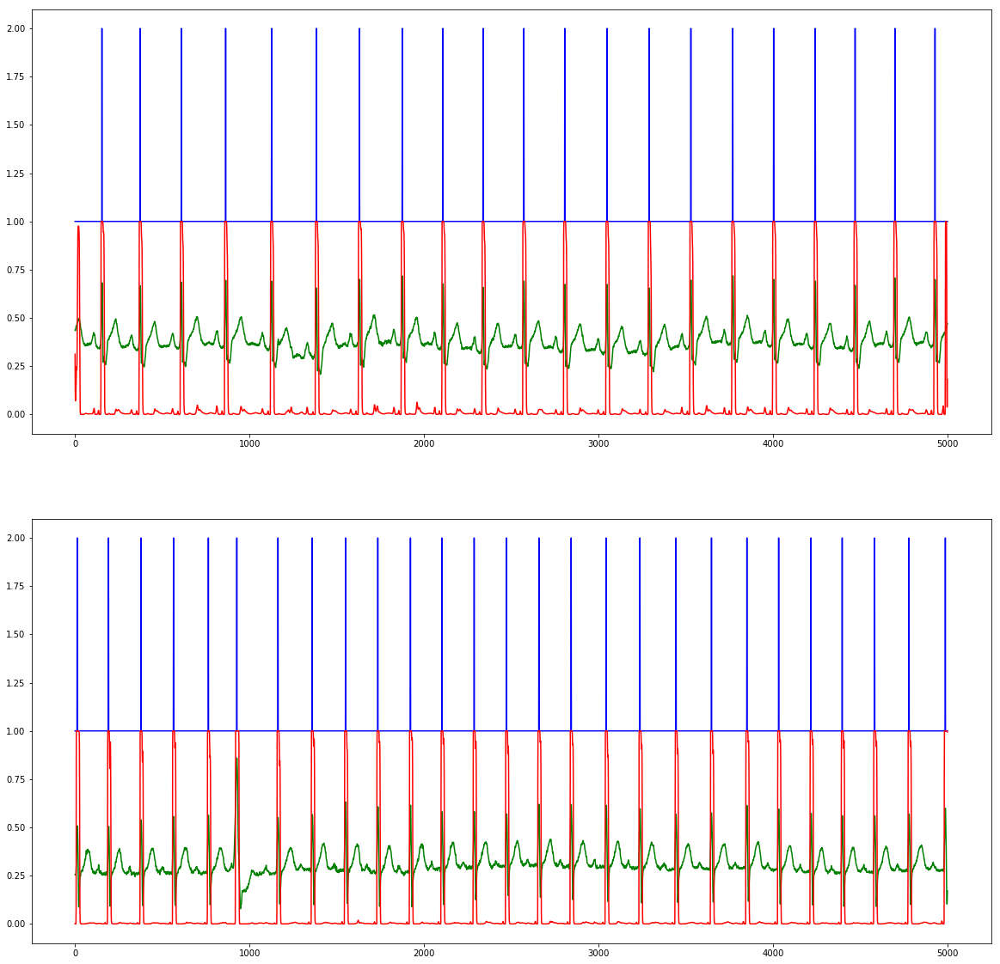

Epoch 53/100 running...Done in 4.653s!
  - training loss:		0.134513
  - test loss:			0.143479
  - test accuracy:		99.6389 %


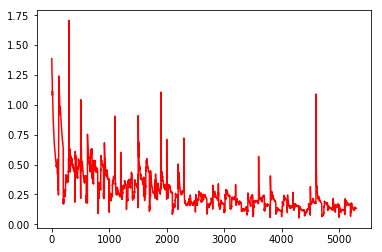

[[[  1.01946816e-02   2.23603216e-03   9.49799723e-04 ...,   9.99576867e-01
     9.98336911e-01   9.99488354e-01]]]
[[[ 0.48832914  0.25032339  0.17818308 ...,  0.6210112   0.69945556
    0.94364744]]]


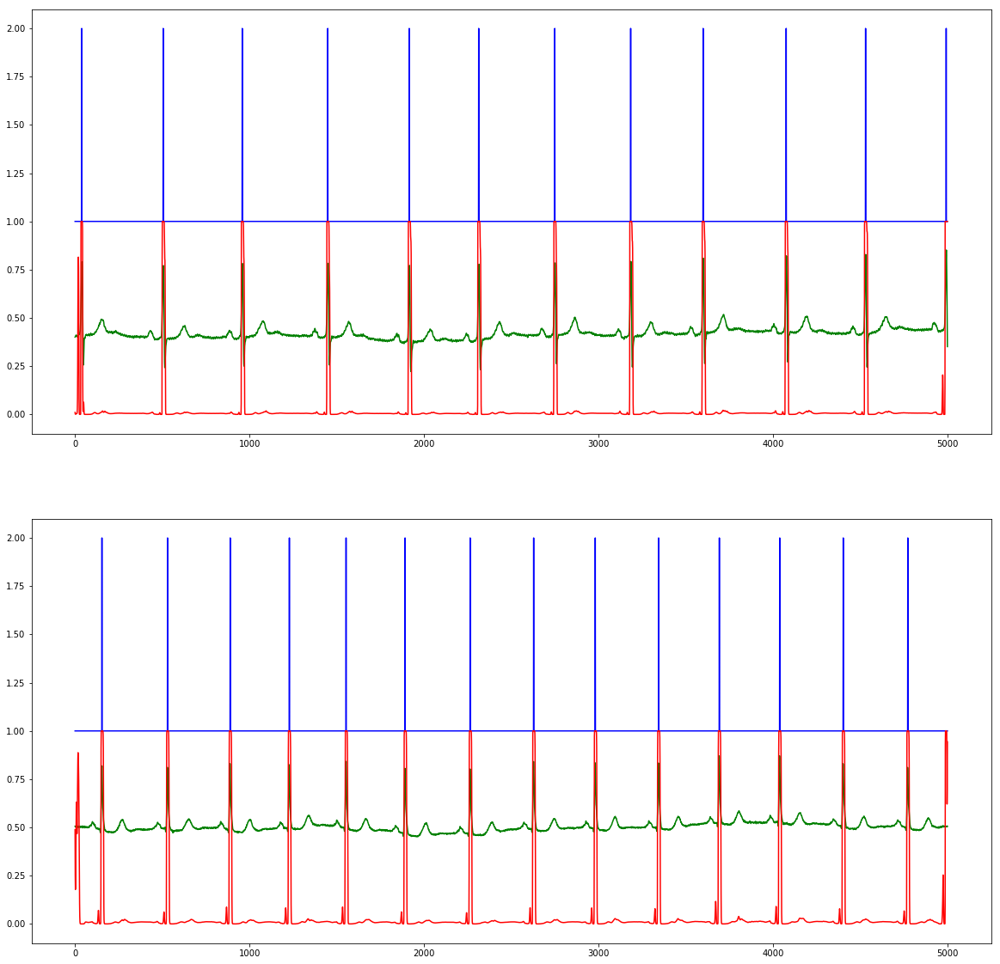

Epoch 54/100 running...Done in 4.602s!
  - training loss:		0.160175
  - test loss:			0.146467
  - test accuracy:		99.6389 %


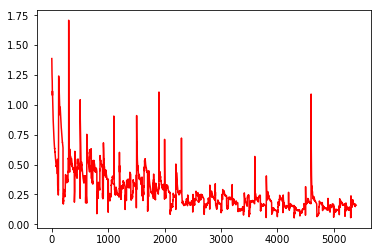

[[[ 0.99986911  0.99999535  1.         ...,  0.63442874  0.71931624
    0.9356941 ]]]
[[[ 0.46356136  0.24959654  0.15852723 ...,  0.33885556  0.40847346
    0.75110793]]]


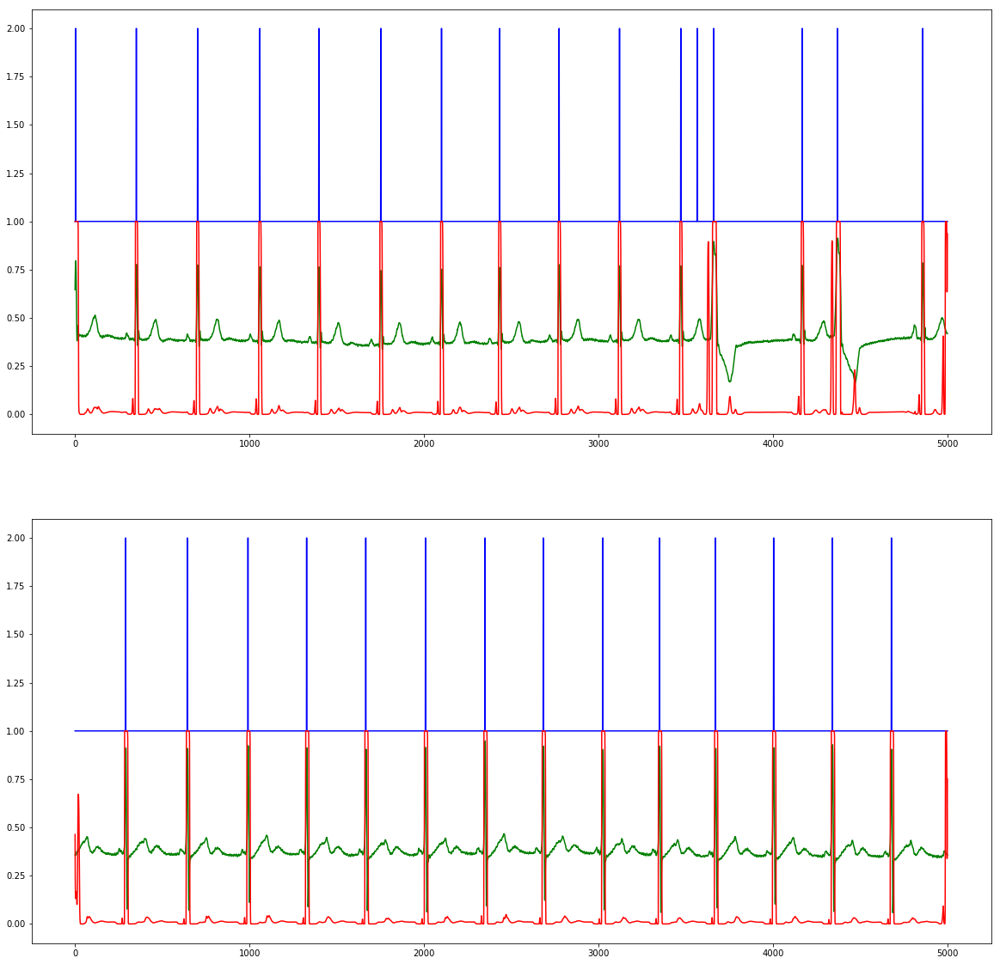

Epoch 55/100 running...Done in 4.593s!
  - training loss:		0.107936
  - test loss:			0.146414
  - test accuracy:		99.6389 %


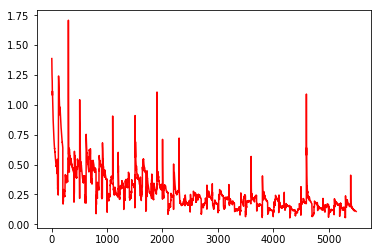

[[[ 0.2861343   0.11031895  0.06154231 ...,  0.21497309  0.29006907
    0.74008244]]]
[[[ 0.43010455  0.17580968  0.1016217  ...,  0.19857445  0.26349369
    0.69959038]]]


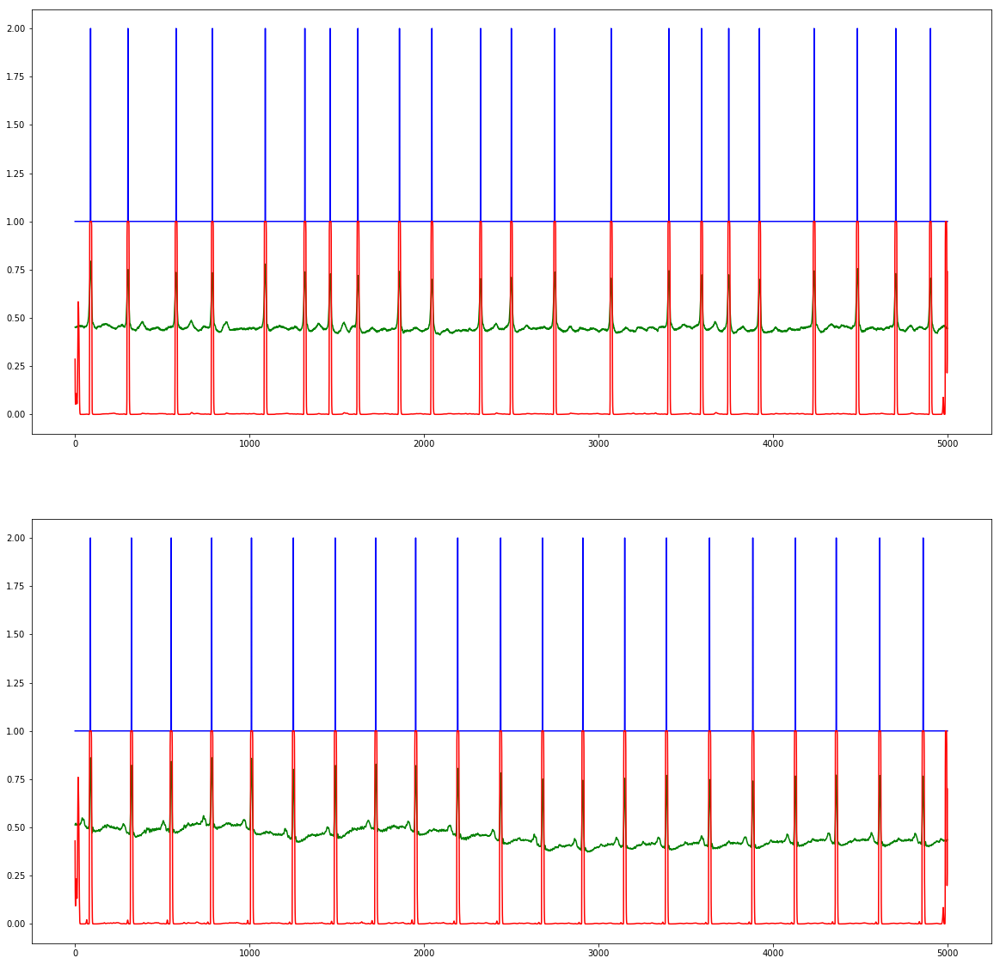

Epoch 56/100 running...Done in 4.581s!
  - training loss:		0.105901
  - test loss:			0.153583
  - test accuracy:		99.6389 %


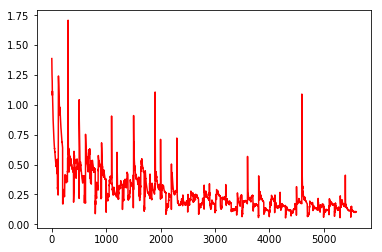

[[[ 0.56483167  0.34123302  0.23641501 ...,  0.154402    0.19665453
    0.54812902]]]
[[[ 0.13450916  0.06239229  0.03612289 ...,  0.06833837  0.08544824
    0.23460937]]]


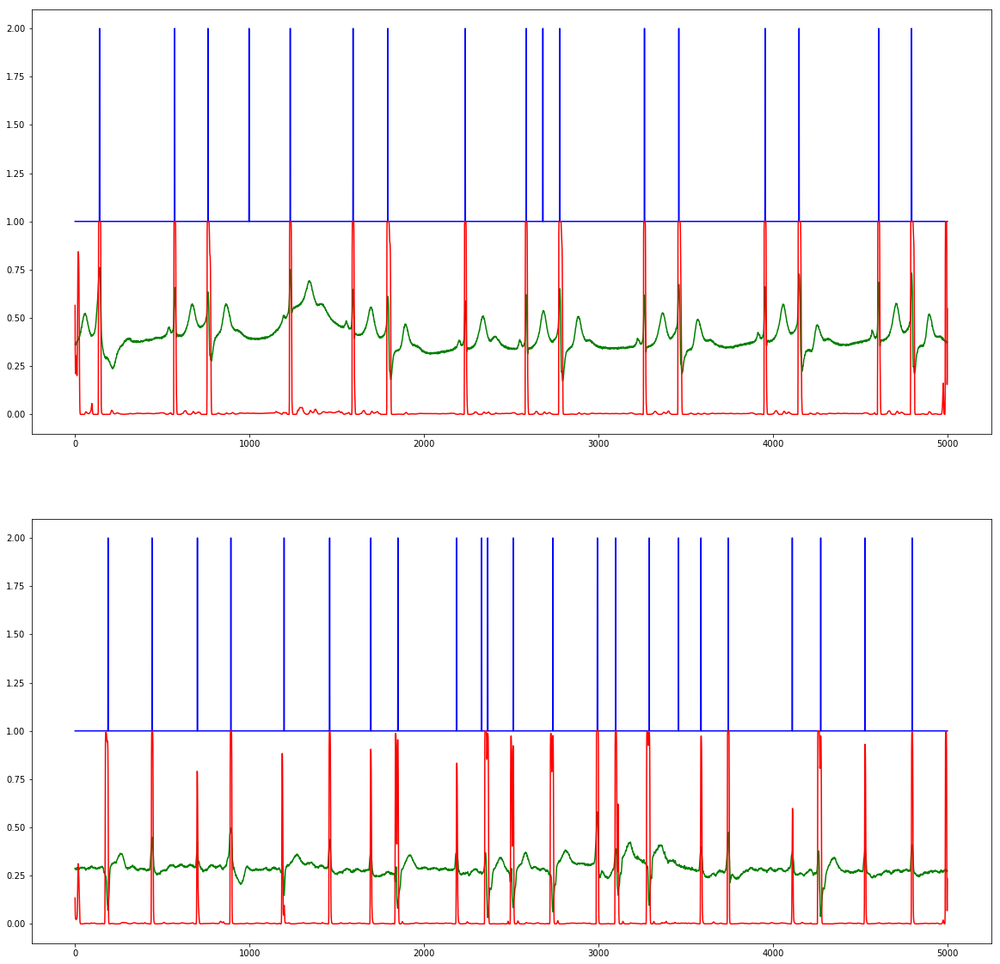

Epoch 57/100 running...Done in 4.619s!
  - training loss:		0.133397
  - test loss:			0.141924
  - test accuracy:		99.6389 %


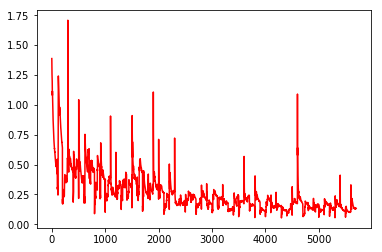

[[[ 0.01296274  0.00680881  0.00506165 ...,  0.10182878  0.12452574
    0.41838735]]]
[[[ 0.41381469  0.19068305  0.11482472 ...,  0.21054971  0.28456557
    0.75924814]]]


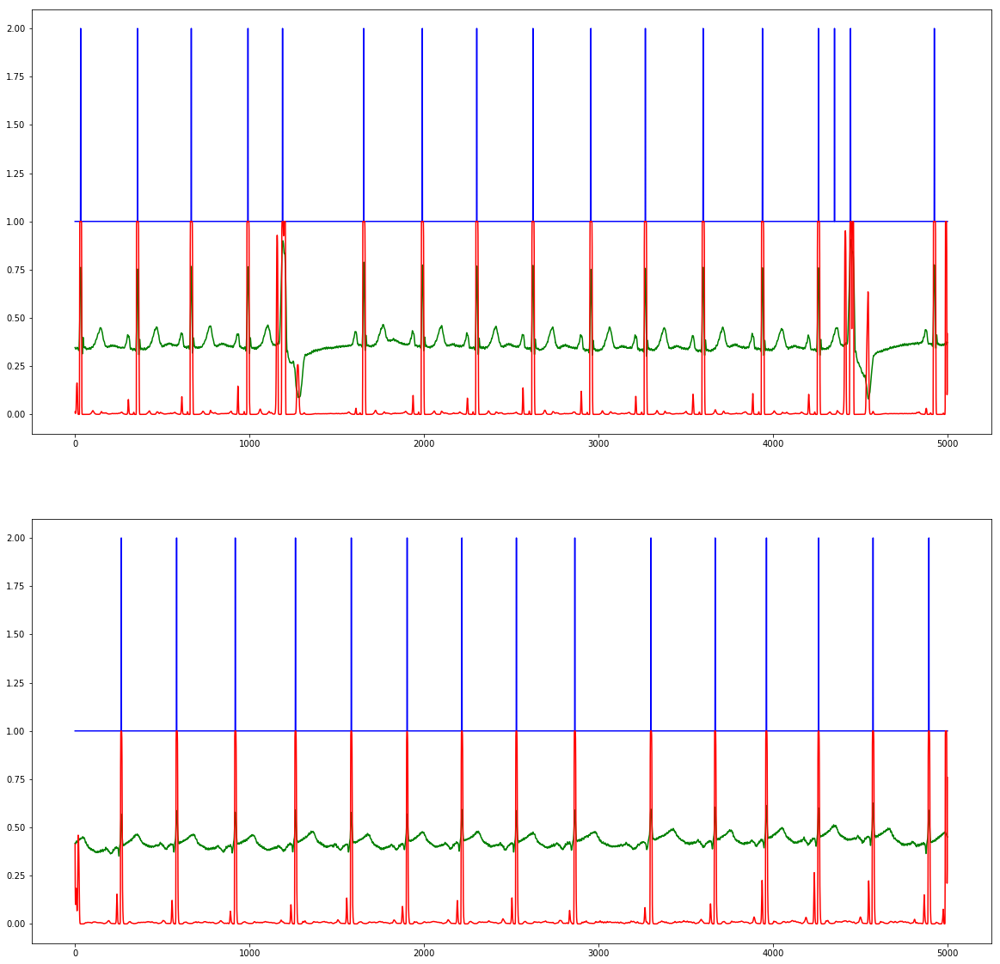

Epoch 58/100 running...Done in 4.607s!
  - training loss:		0.140208
  - test loss:			0.144546
  - test accuracy:		99.6389 %


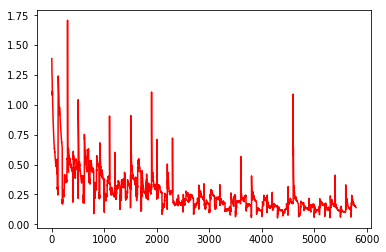

[[[ 0.34120145  0.11525577  0.05989803 ...,  0.12007666  0.146833
    0.48152885]]]
[[[ 0.3664878   0.13820663  0.08017439 ...,  0.19848704  0.25660458
    0.72836936]]]


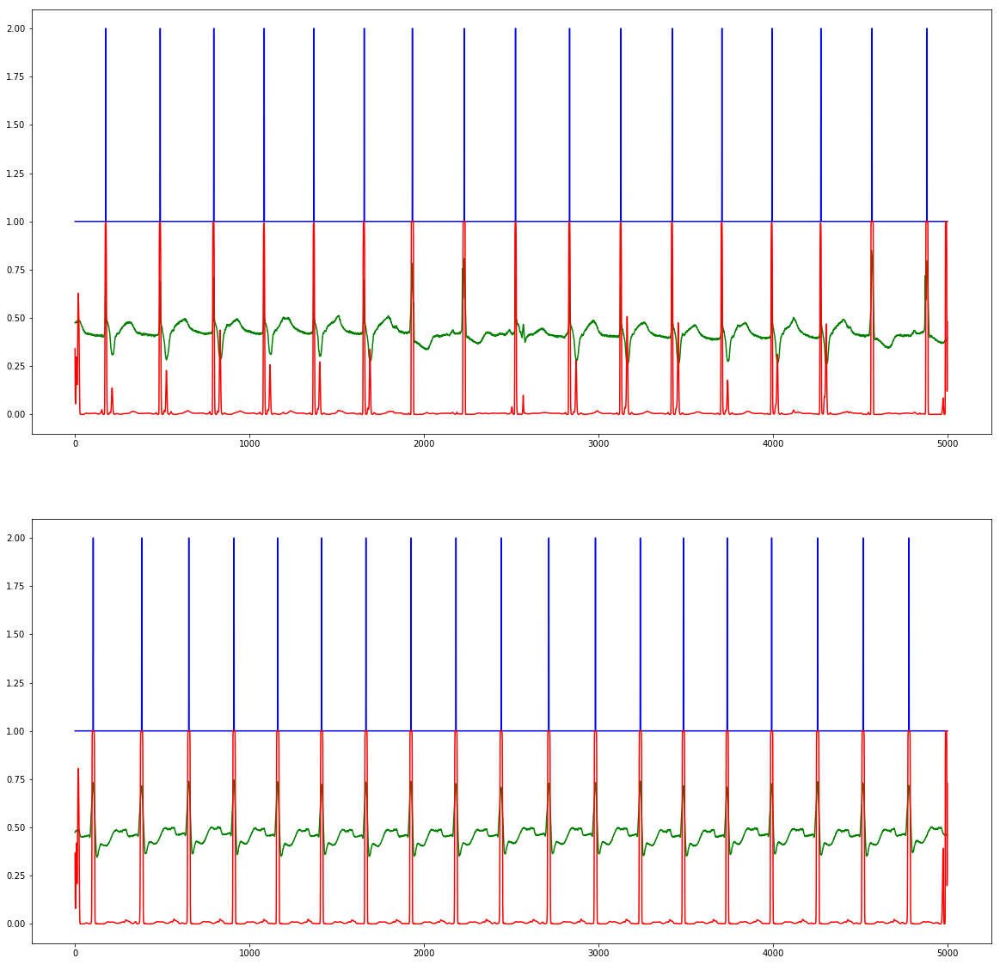

Epoch 59/100 running...Done in 4.600s!
  - training loss:		0.169133
  - test loss:			0.152757
  - test accuracy:		99.6389 %


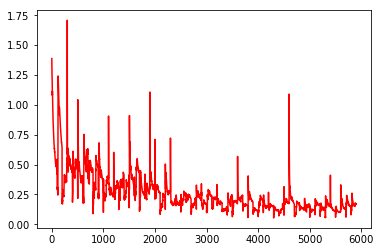

[[[ 0.90784442  0.6807366   0.34273186 ...,  0.30153057  0.3644639
    0.82016873]]]
[[[ 0.41239244  0.17094155  0.09584385 ...,  0.44962987  0.54249036
    0.93386918]]]


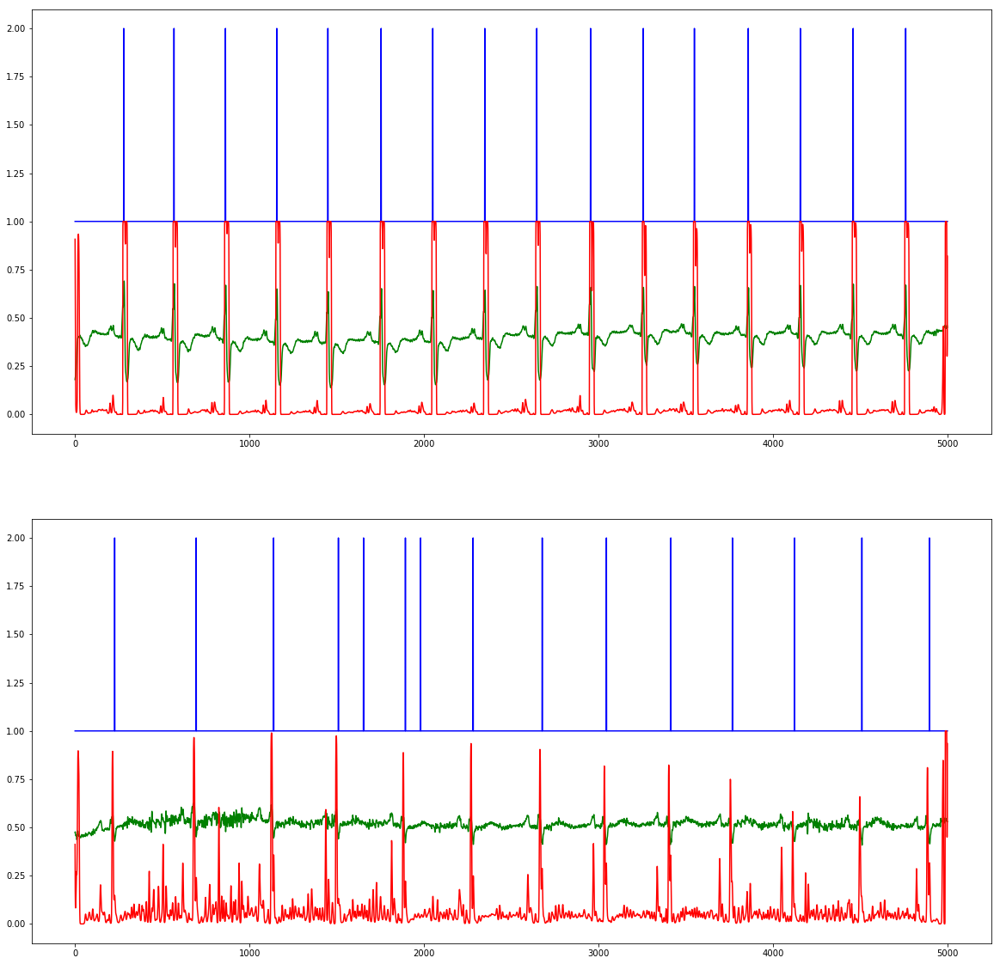

Epoch 60/100 running...Done in 4.587s!
  - training loss:		0.125779
  - test loss:			0.147285
  - test accuracy:		99.6389 %


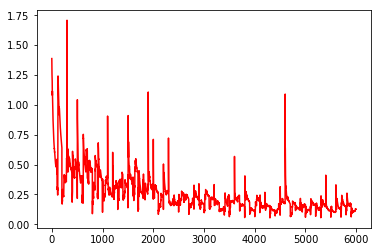

[[[ 0.13080963  0.05811675  0.0395643  ...,  0.85607648  0.55745304
    0.76312715]]]
[[[ 0.28804156  0.11102957  0.06489985 ...,  0.20469433  0.2845161
    0.74361449]]]


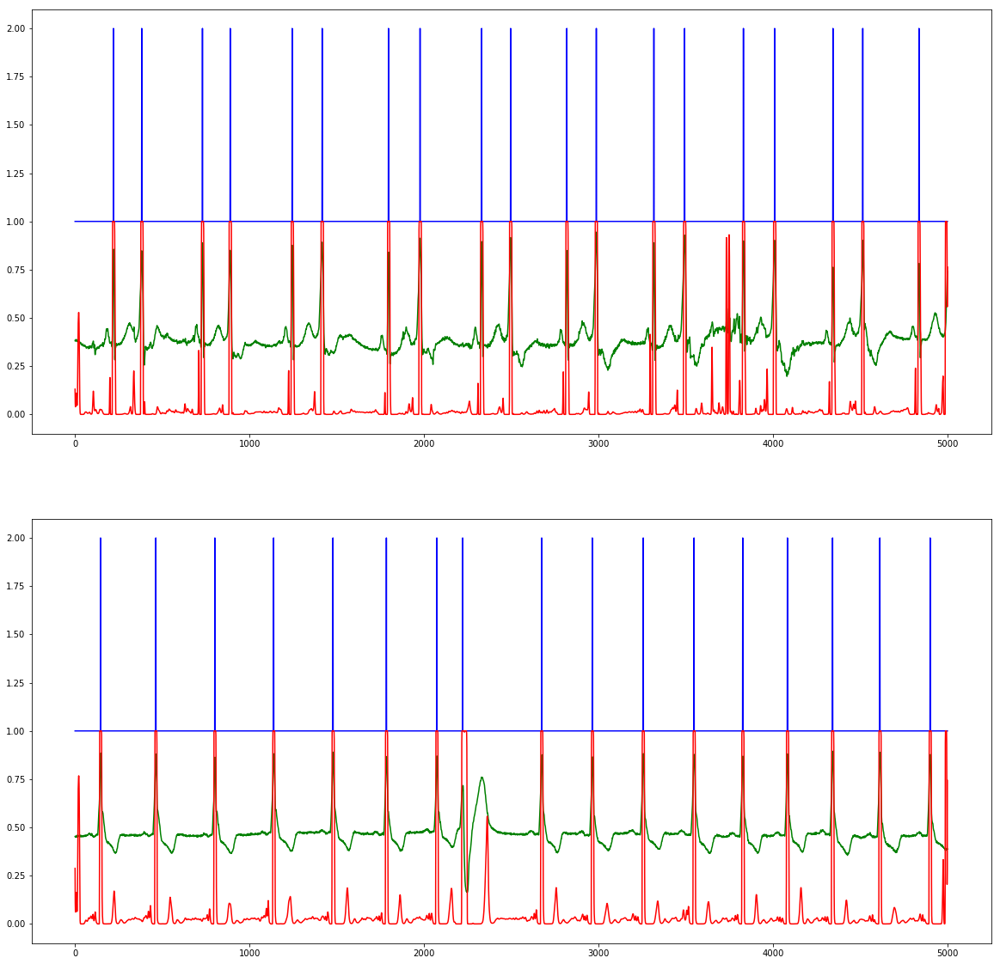

Epoch 61/100 running...Done in 4.583s!
  - training loss:		0.115997
  - test loss:			0.128643
  - test accuracy:		99.6389 %


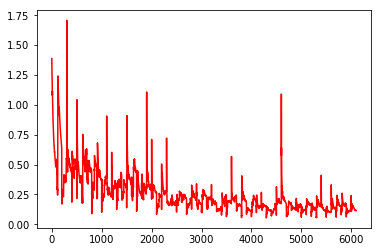

[[[ 0.45193875  0.16927603  0.09852432 ...,  0.18363702  0.29269603
    0.85049498]]]
[[[ 0.20218194  0.08191287  0.04718774 ...,  0.07365853  0.10334085
    0.43217596]]]


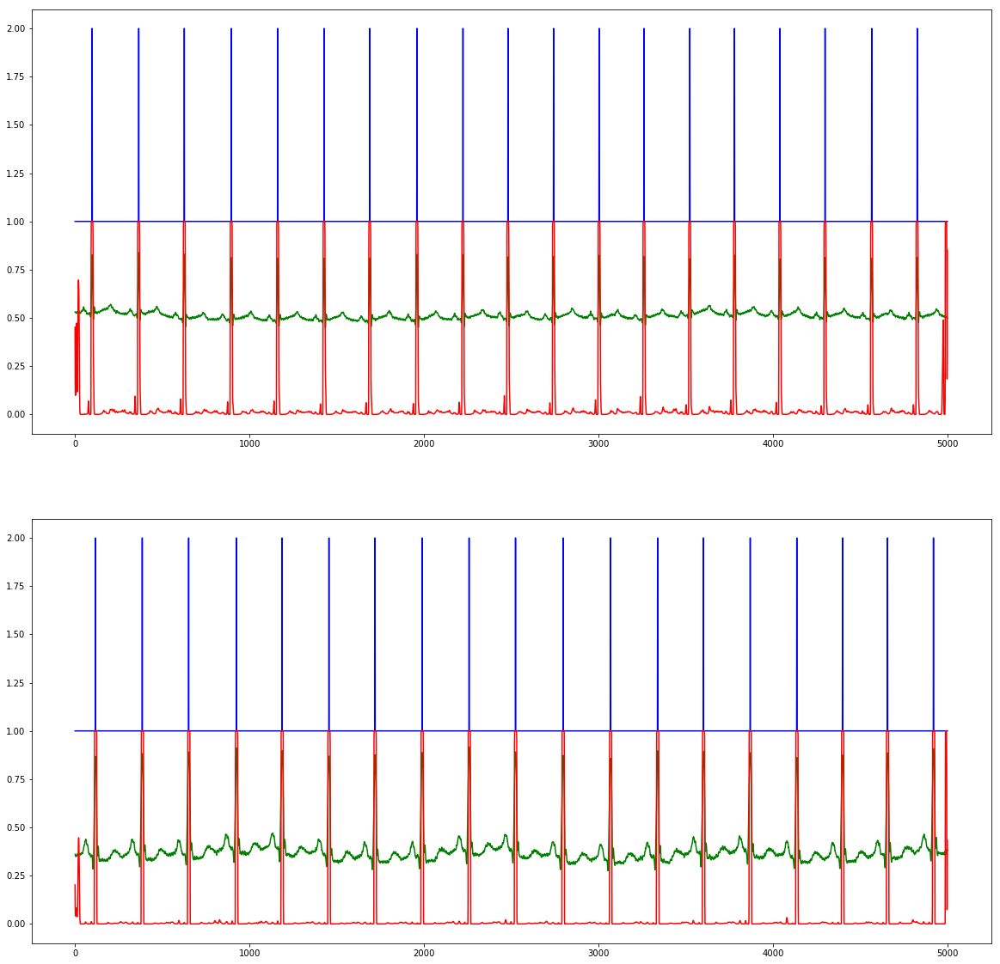

Epoch 62/100 running...Done in 4.618s!
  - training loss:		0.122521
  - test loss:			0.135430
  - test accuracy:		99.6389 %


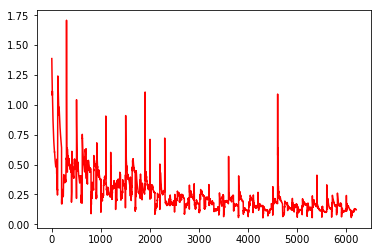

[[[ 0.00548229  0.00592337  0.00998432 ...,  0.00889919  0.01885844
    0.12854351]]]
[[[ 0.28740302  0.26777288  0.32298094 ...,  0.02620418  0.03536537
    0.19172168]]]


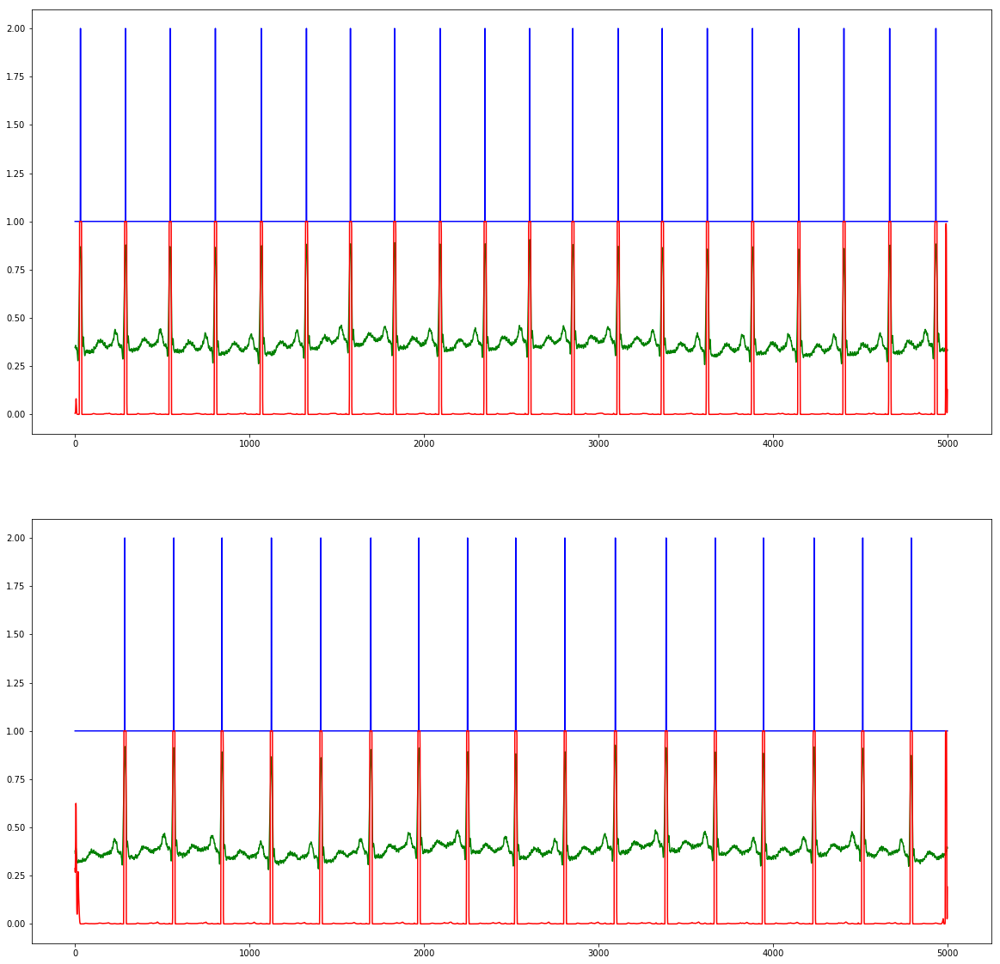

Epoch 63/100 running...Done in 4.594s!
  - training loss:		0.076836
  - test loss:			0.127052
  - test accuracy:		99.6389 %


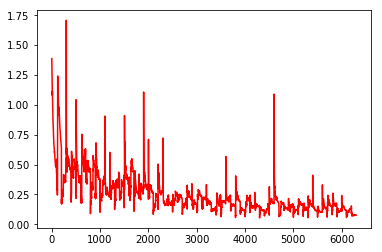

[[[ 0.08175291  0.03419567  0.01915711 ...,  0.00139575  0.00251843
    0.01207713]]]
[[[ 0.76116765  0.24572125  0.09020303 ...,  0.09848401  0.07400151
    0.28301516]]]


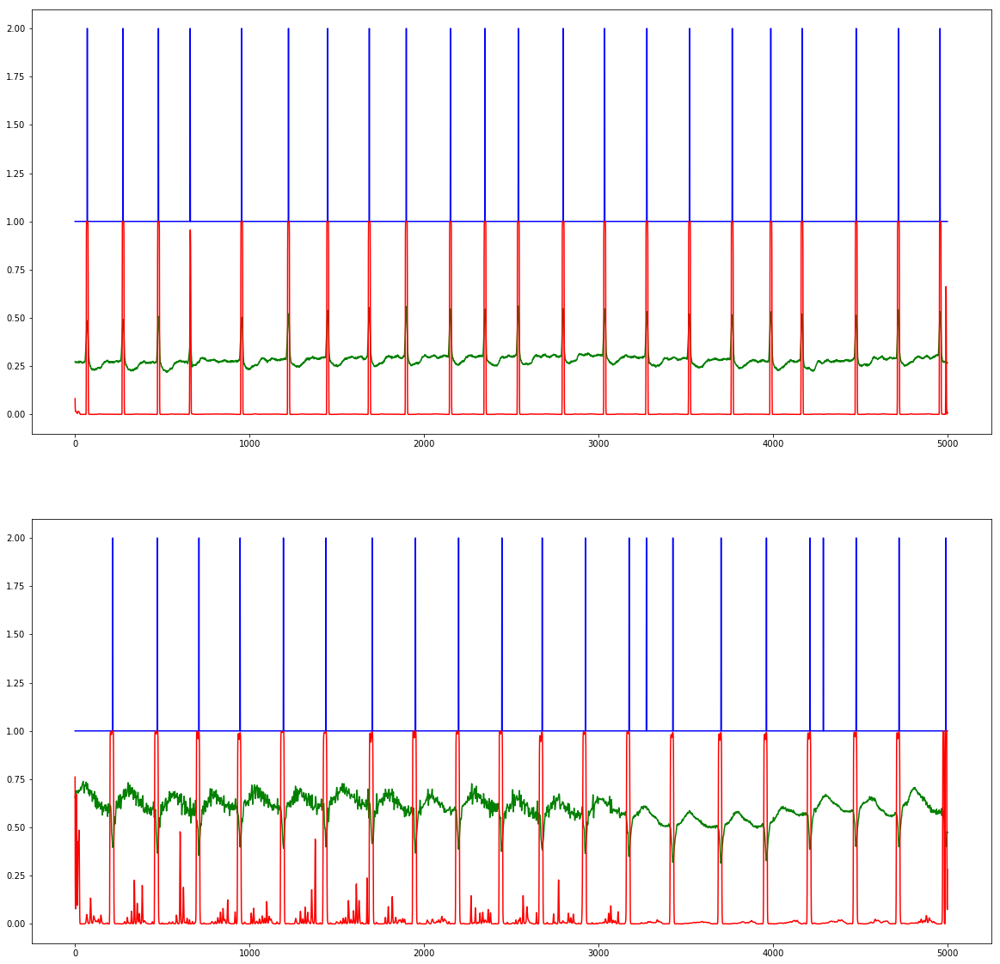

Epoch 64/100 running...Done in 4.635s!
  - training loss:		0.125537
  - test loss:			0.130764
  - test accuracy:		99.6389 %


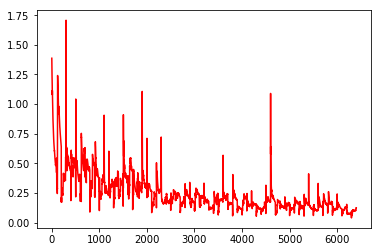

[[[ 0.50126892  0.11239769  0.01290169 ...,  0.00682926  0.00652802
    0.01632361]]]
[[[ 0.04974248  0.02039424  0.01968867 ...,  0.05101782  0.08422813
    0.45023647]]]


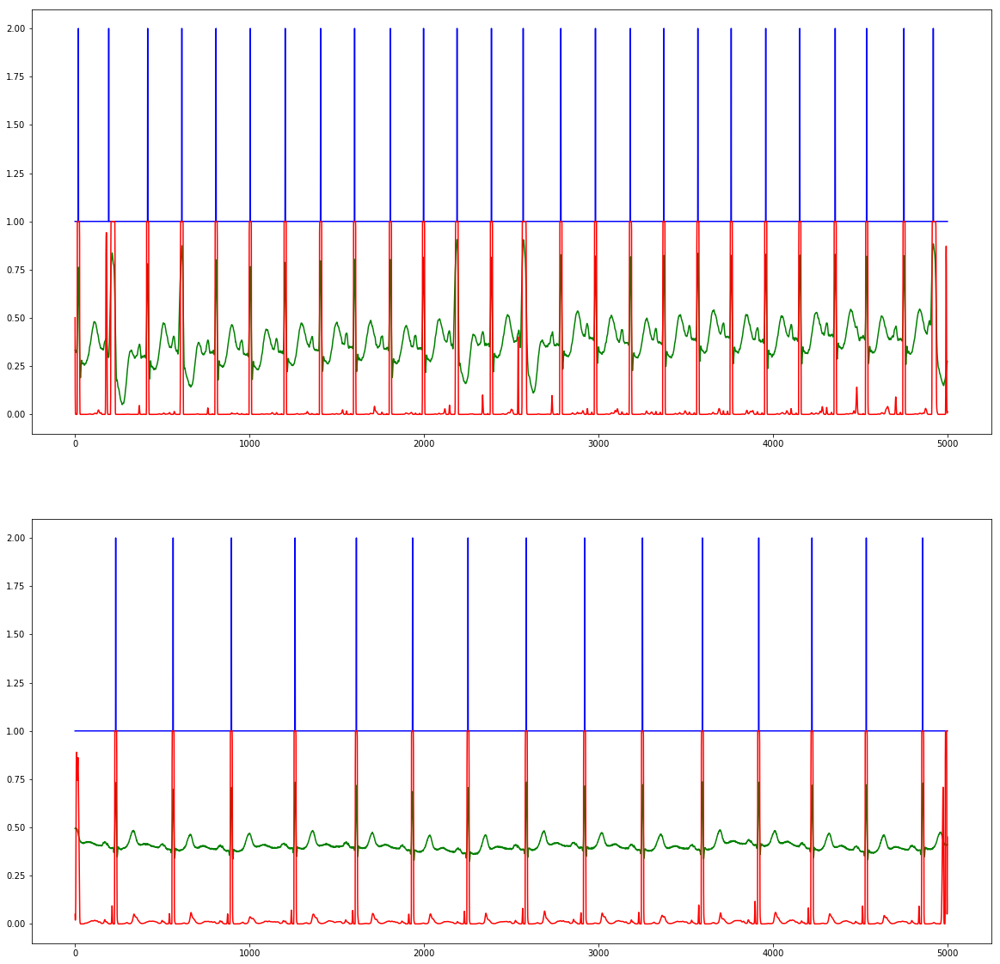

Epoch 65/100 running...Done in 4.592s!
  - training loss:		0.117950
  - test loss:			0.126416
  - test accuracy:		99.6389 %


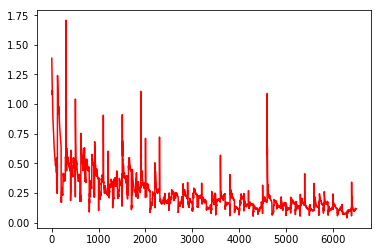

[[[ 0.56796807  0.18493421  0.09100163 ...,  0.07540262  0.18330991
    0.85969162]]]
[[[ 0.63371438  0.17844301  0.04792799 ...,  0.00274069  0.00394272
    0.03878425]]]


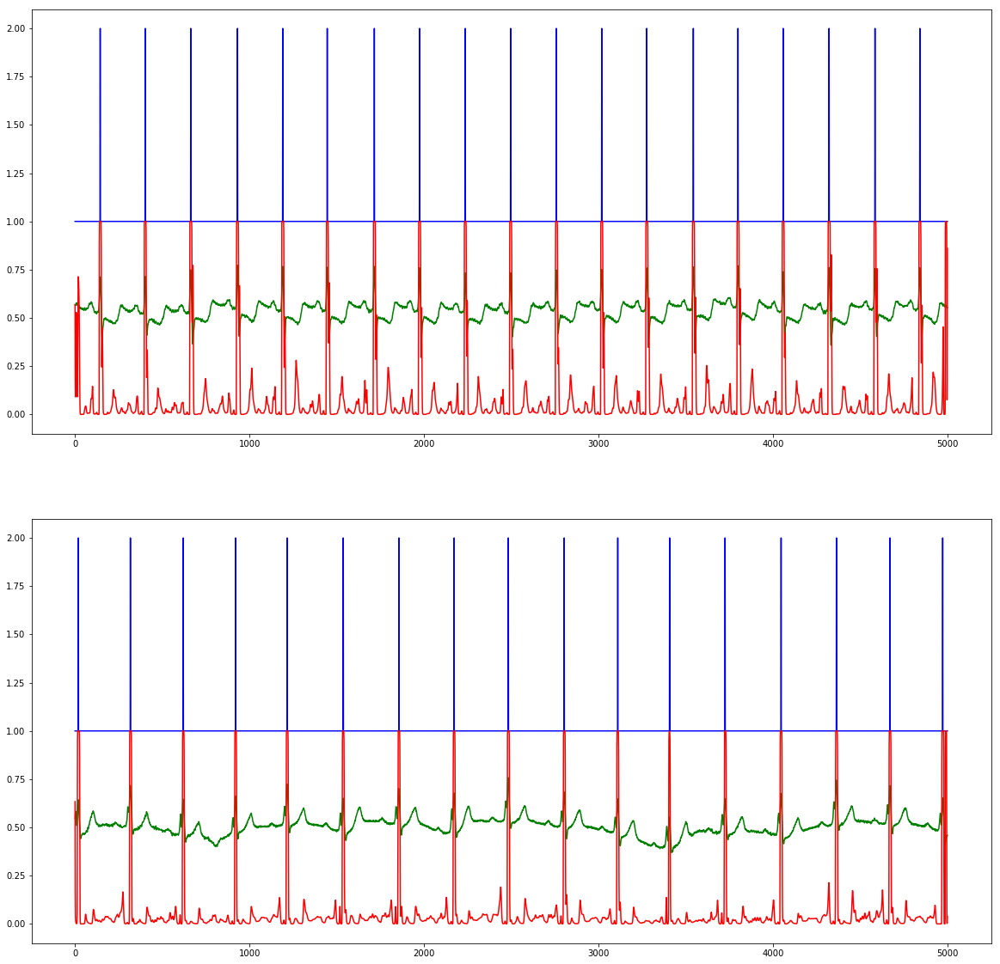

Epoch 66/100 running...Done in 4.600s!
  - training loss:		0.130651
  - test loss:			0.154352
  - test accuracy:		99.6389 %


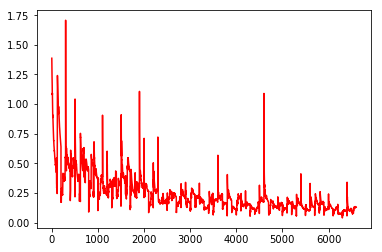

[[[ 0.11027264  0.05971185  0.05936498 ...,  0.03081943  0.0555435
    0.43482748]]]
[[[ 0.97236764  0.87992108  0.75125271 ...,  0.11718944  0.30384526
    0.94264573]]]


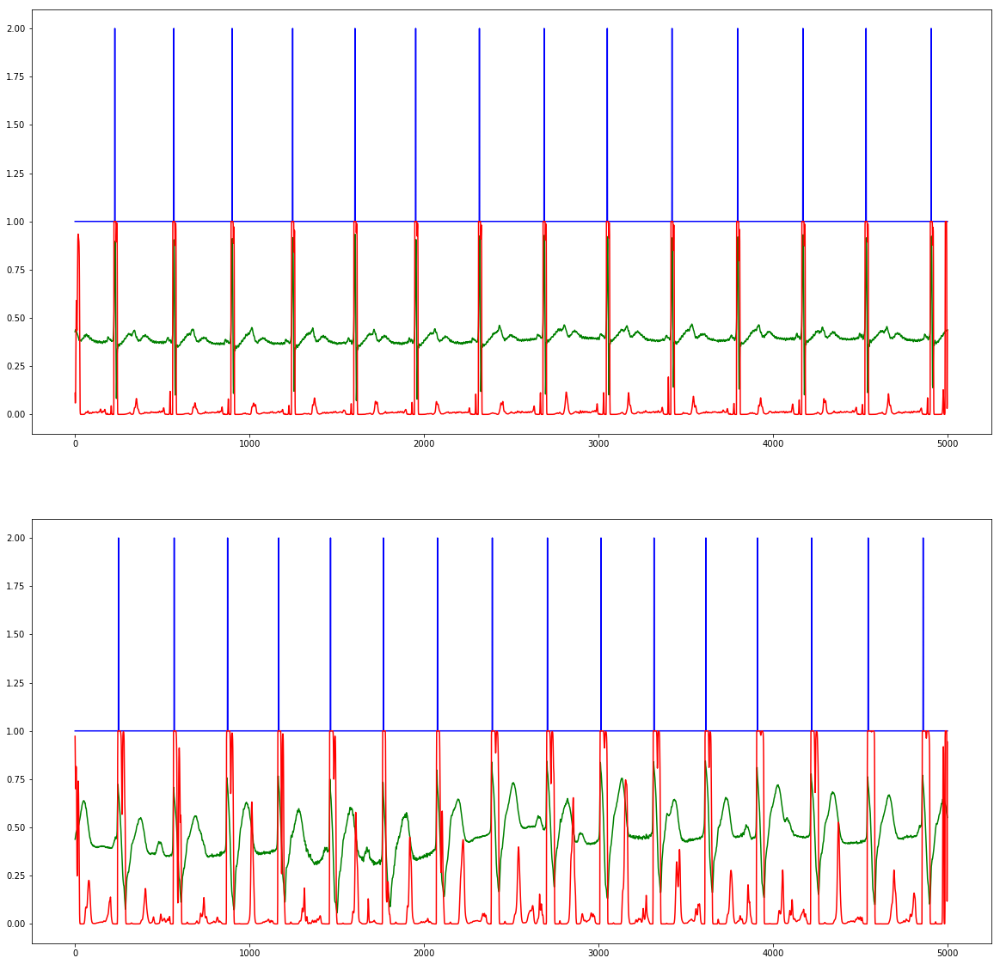

Epoch 67/100 running...Done in 4.647s!
  - training loss:		0.101008
  - test loss:			0.128160
  - test accuracy:		99.6389 %


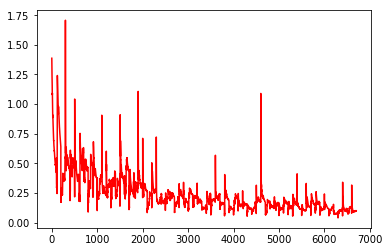

[[[ 0.73255545  0.36304331  0.17621477 ...,  0.03168317  0.06753111
    0.60997003]]]
[[[ 0.65324014  0.28603142  0.13302104 ...,  0.03016487  0.05997349
    0.40285897]]]


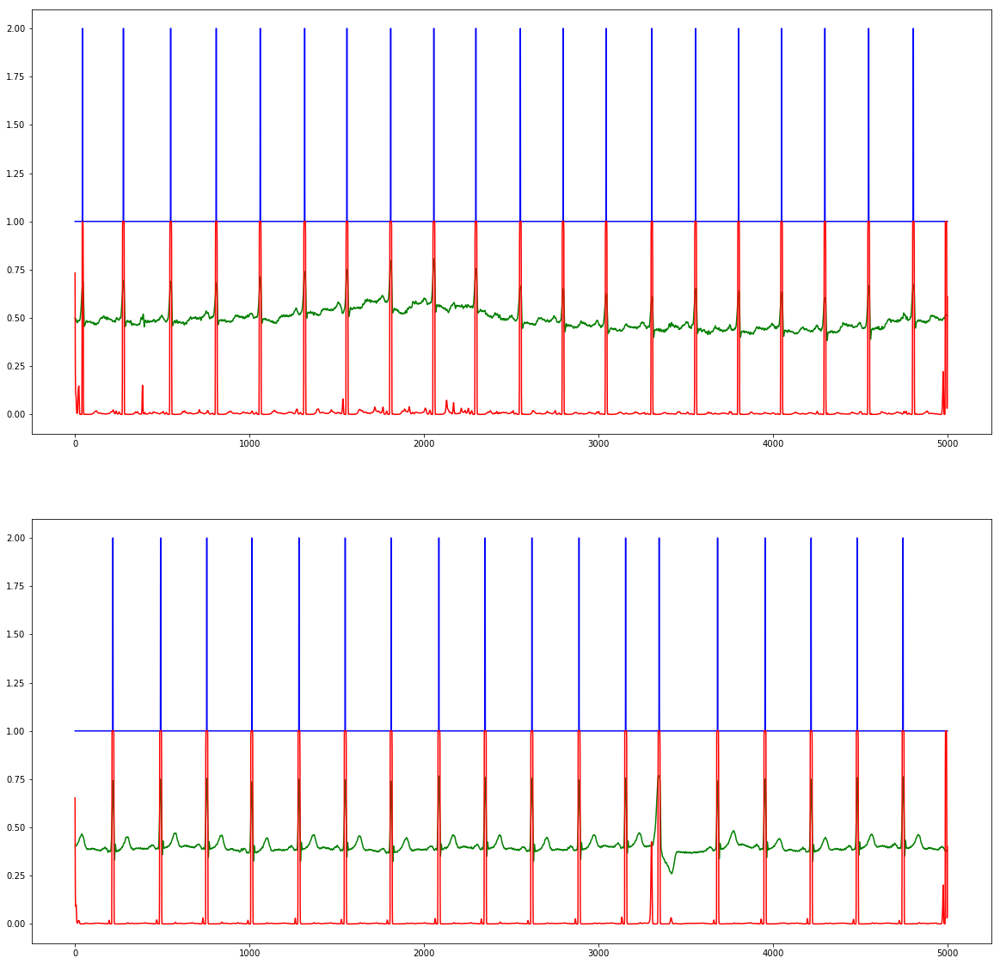

Epoch 68/100 running...Done in 4.632s!
  - training loss:		0.105327
  - test loss:			0.135432
  - test accuracy:		99.6389 %


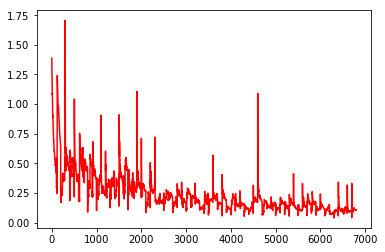

[[[ 0.20111454  0.05618351  0.02581469 ...,  0.03270428  0.08940249
    0.75117666]]]
[[[  3.63663554e-01   9.63498652e-02   4.79667149e-02 ...,   4.87375610e-06
     7.94767311e-06   1.15087903e-04]]]


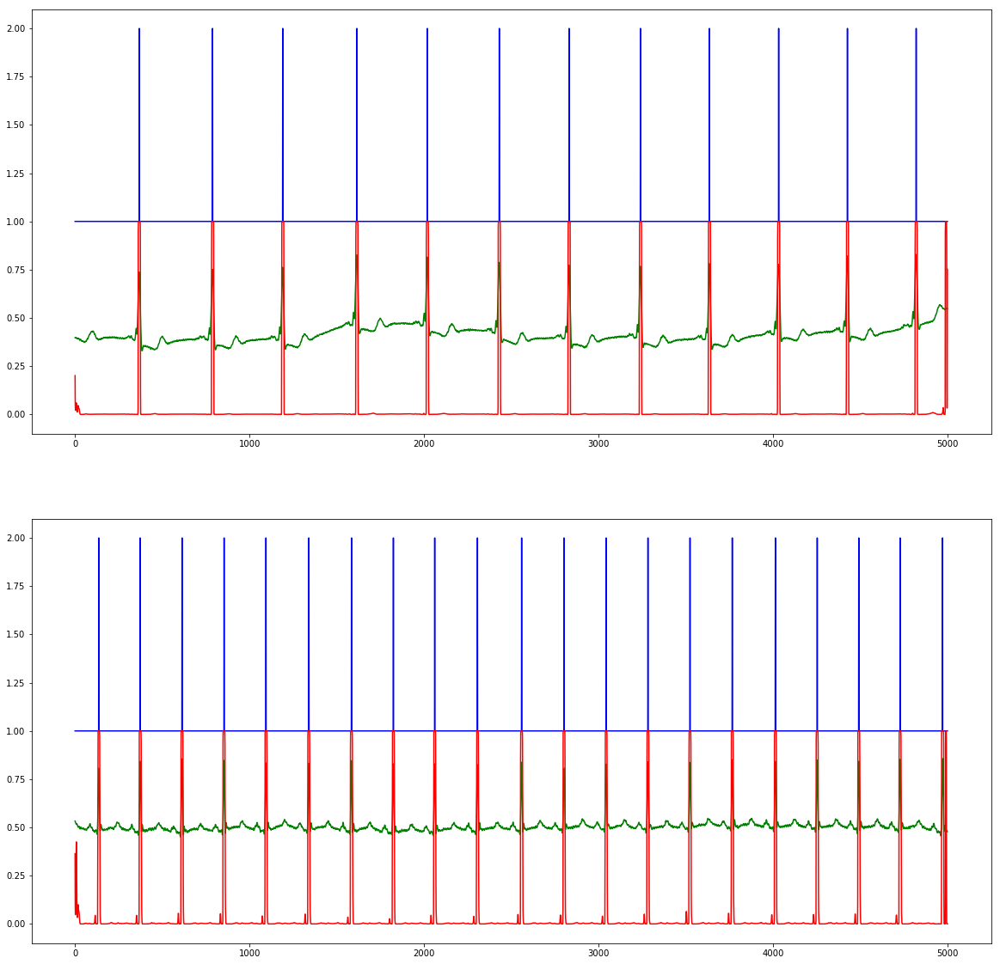

Epoch 69/100 running...Done in 4.622s!
  - training loss:		0.295765
  - test loss:			0.186877
  - test accuracy:		99.6389 %


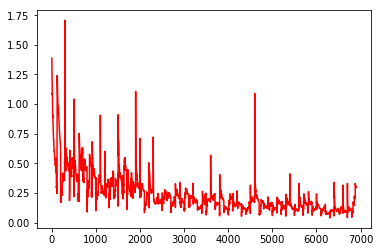

[[[  5.76239645e-01   2.17359826e-01   1.08007133e-01 ...,   3.69217567e-04
     2.50029378e-04   9.92113957e-04]]]
[[[ 0.69300753  0.26766497  0.14438681 ...,  0.1512038   0.30212837
    0.89926708]]]


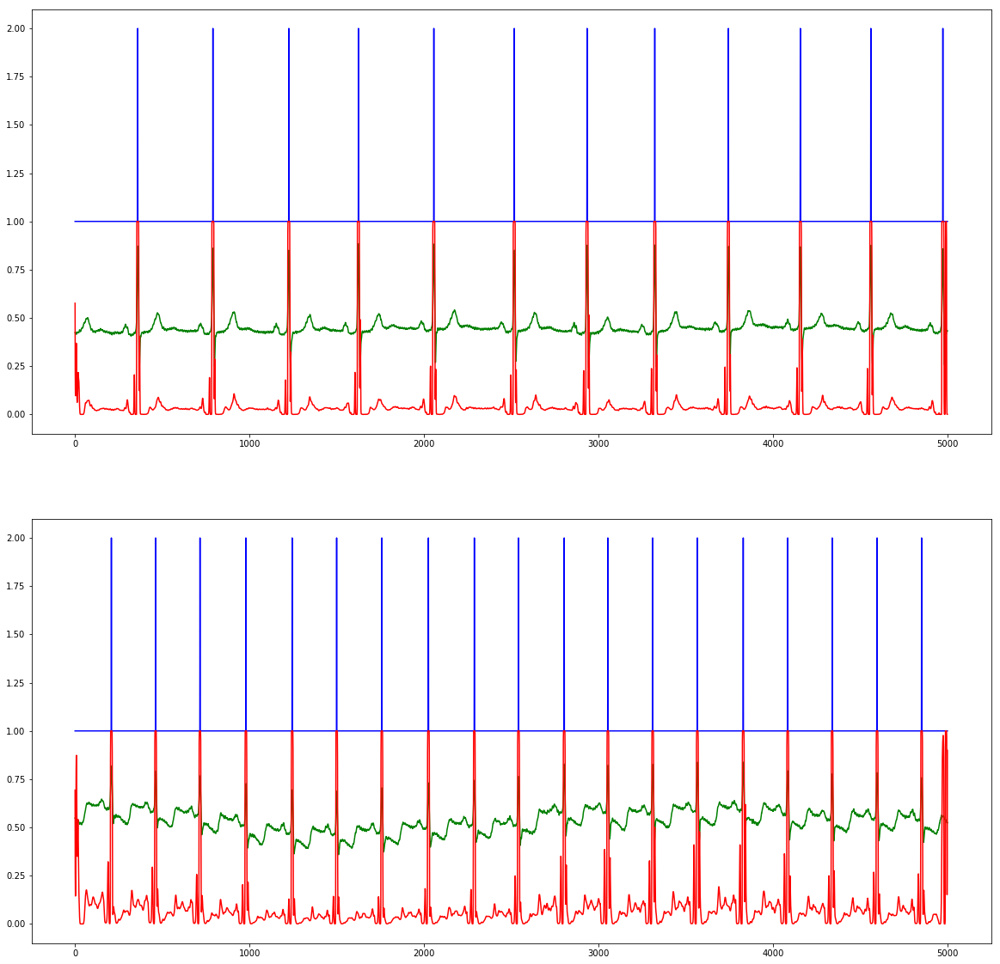

Epoch 70/100 running...Done in 4.639s!
  - training loss:		0.128569
  - test loss:			0.152326
  - test accuracy:		99.6389 %


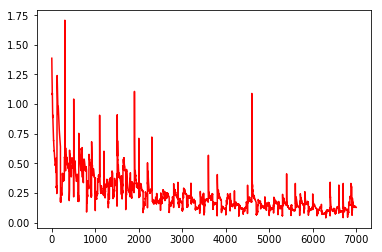

[[[ 0.99999821  1.          1.         ...,  0.00133107  0.00186225
    0.01605606]]]
[[[ 0.74514127  0.24662505  0.07675592 ...,  0.00426905  0.01963193
    0.33837864]]]


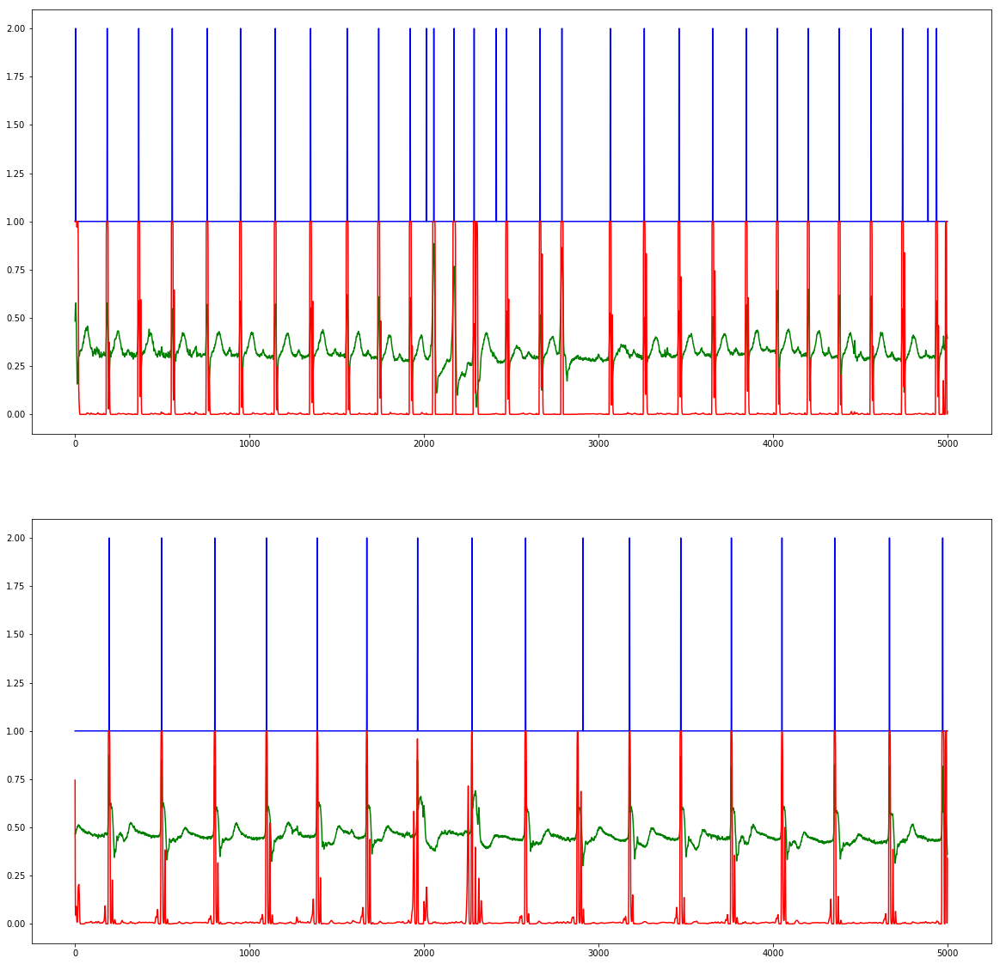

Epoch 71/100 running...Done in 4.638s!
  - training loss:		0.213090
  - test loss:			0.172186
  - test accuracy:		99.6389 %


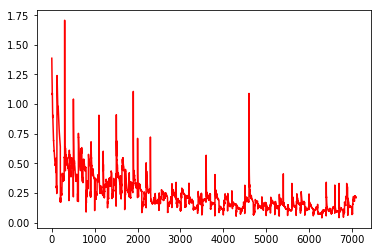

[[[ 0.47142059  0.11611988  0.04836617 ...,  0.066356    0.19369584
    0.8880856 ]]]
[[[ 0.33507776  0.12313192  0.07273671 ...,  0.02233184  0.0467339
    0.31296909]]]


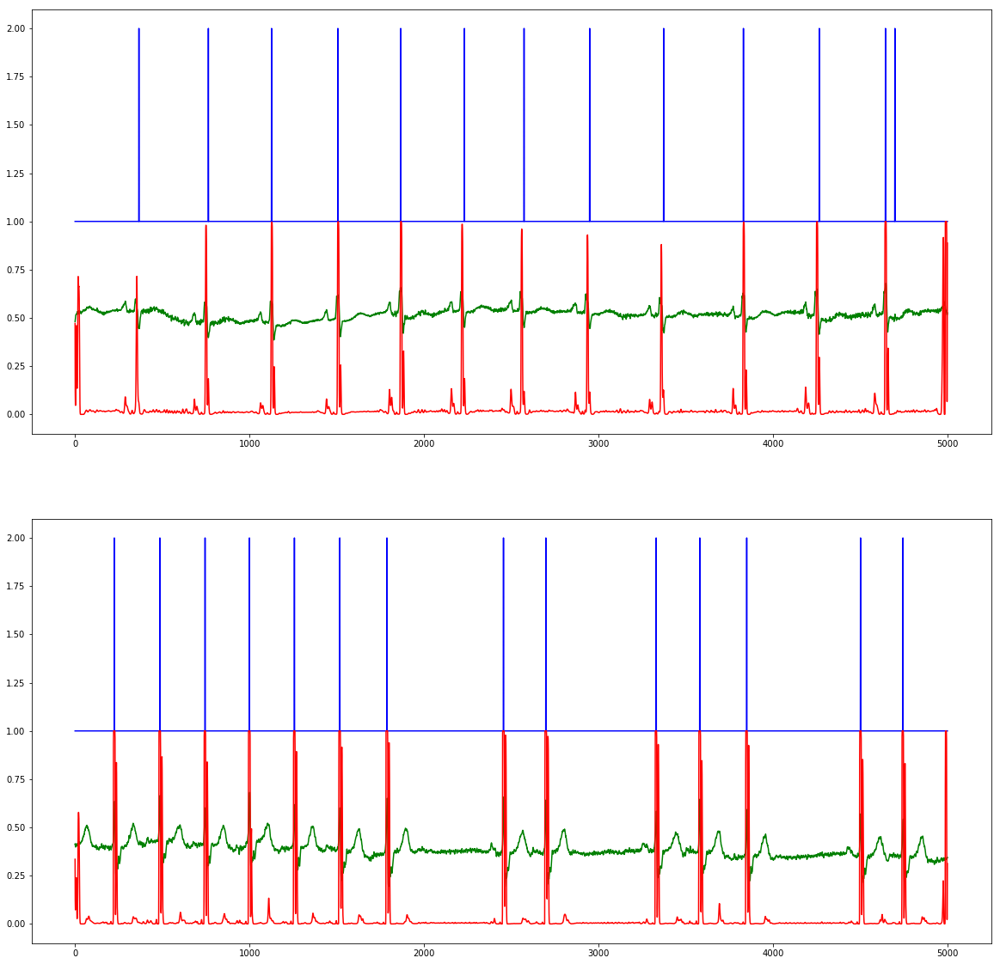

Epoch 72/100 running...Done in 4.776s!
  - training loss:		0.156564
  - test loss:			0.128101
  - test accuracy:		99.6389 %


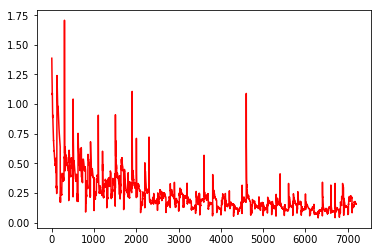

[[[ 0.83220845  0.30384809  0.09368612 ...,  0.01570134  0.04973829
    0.64949584]]]
[[[ 0.51323277  0.13144776  0.04463256 ...,  0.00615844  0.01102659
    0.10607437]]]


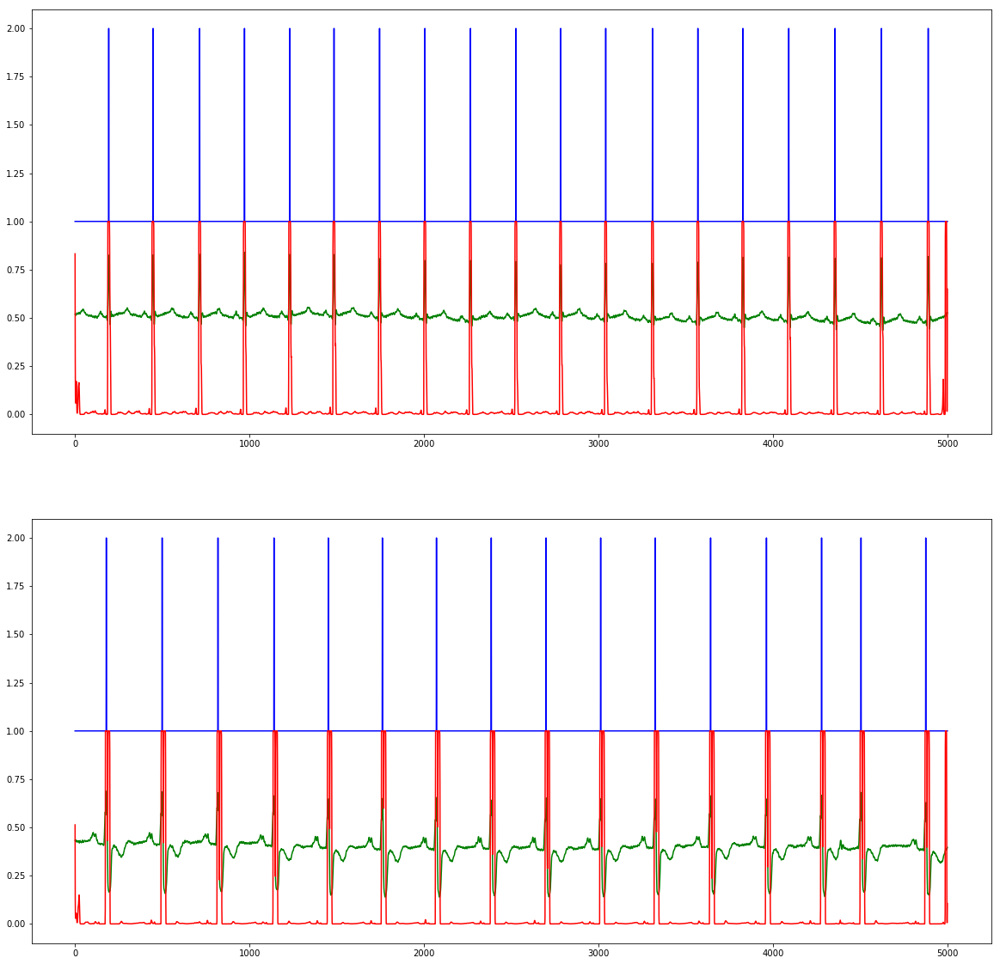

Epoch 73/100 running...Done in 4.699s!
  - training loss:		0.120044
  - test loss:			0.120953
  - test accuracy:		99.6389 %


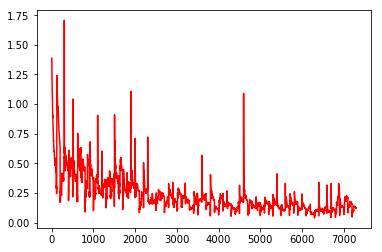

[[[ 0.15025762  0.03590547  0.01444412 ...,  0.03005629  0.07338756
    0.47711128]]]
[[[ 0.64357239  0.1281683   0.03361022 ...,  0.00322953  0.01965945
    0.57666343]]]


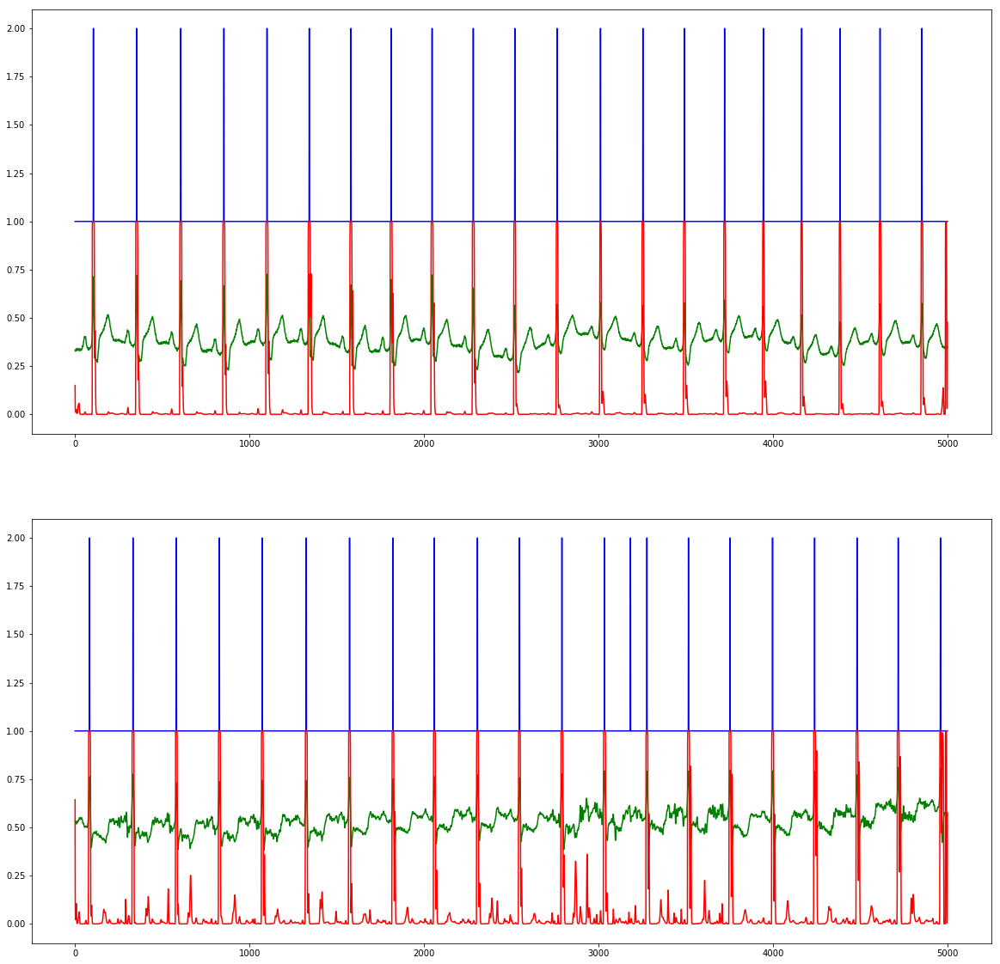

Epoch 74/100 running...Done in 4.633s!
  - training loss:		0.132597
  - test loss:			0.119503
  - test accuracy:		99.6389 %


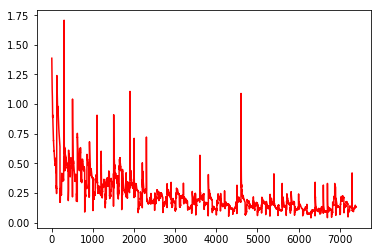

[[[ 0.62954849  0.13759772  0.04551852 ...,  0.09326253  0.22285111
    0.80191803]]]
[[[ 0.4221715   0.07248015  0.02662892 ...,  0.40235472  0.66166693
    0.97647047]]]


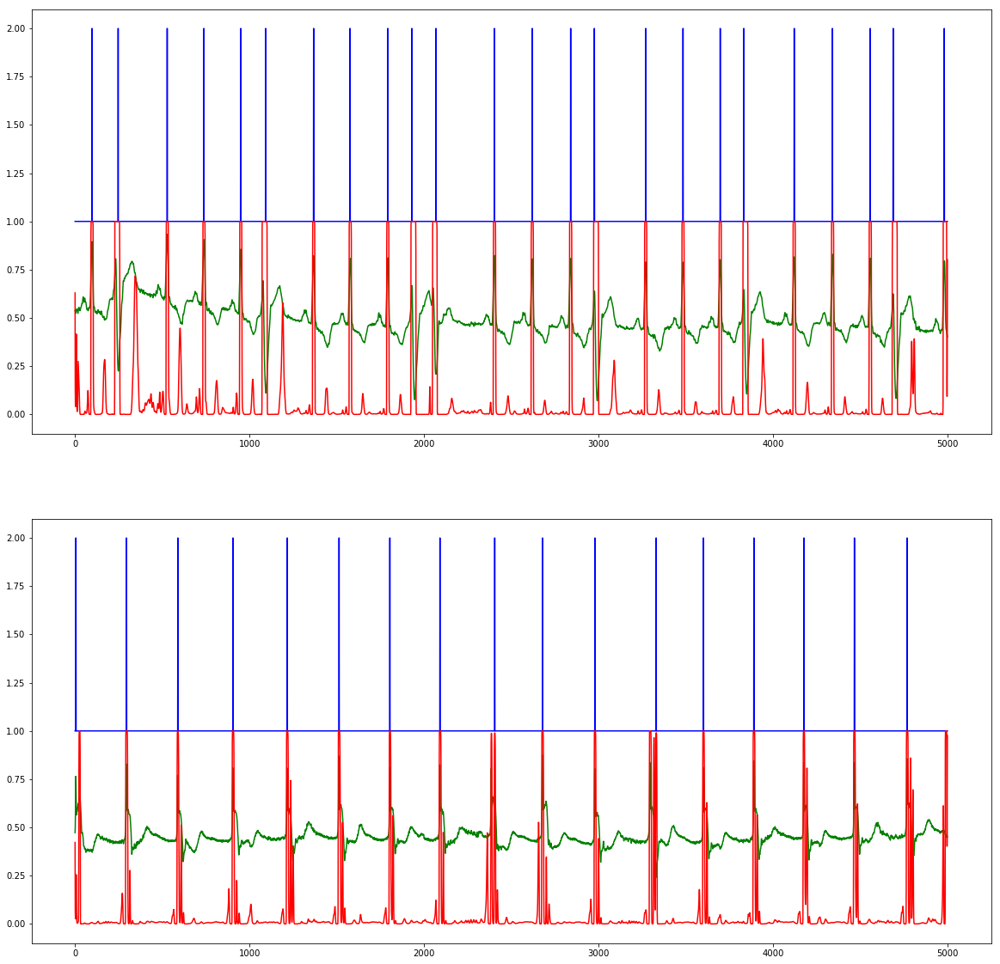

Epoch 75/100 running...Done in 4.678s!
  - training loss:		0.102305
  - test loss:			0.124315
  - test accuracy:		99.6389 %


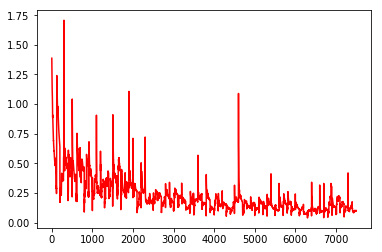

[[[ 0.13847132  0.02777822  0.01245905 ...,  0.01512299  0.04096681
    0.48448715]]]
[[[ 0.06457052  0.01530645  0.00657448 ...,  0.00091596  0.00125491
    0.00685308]]]


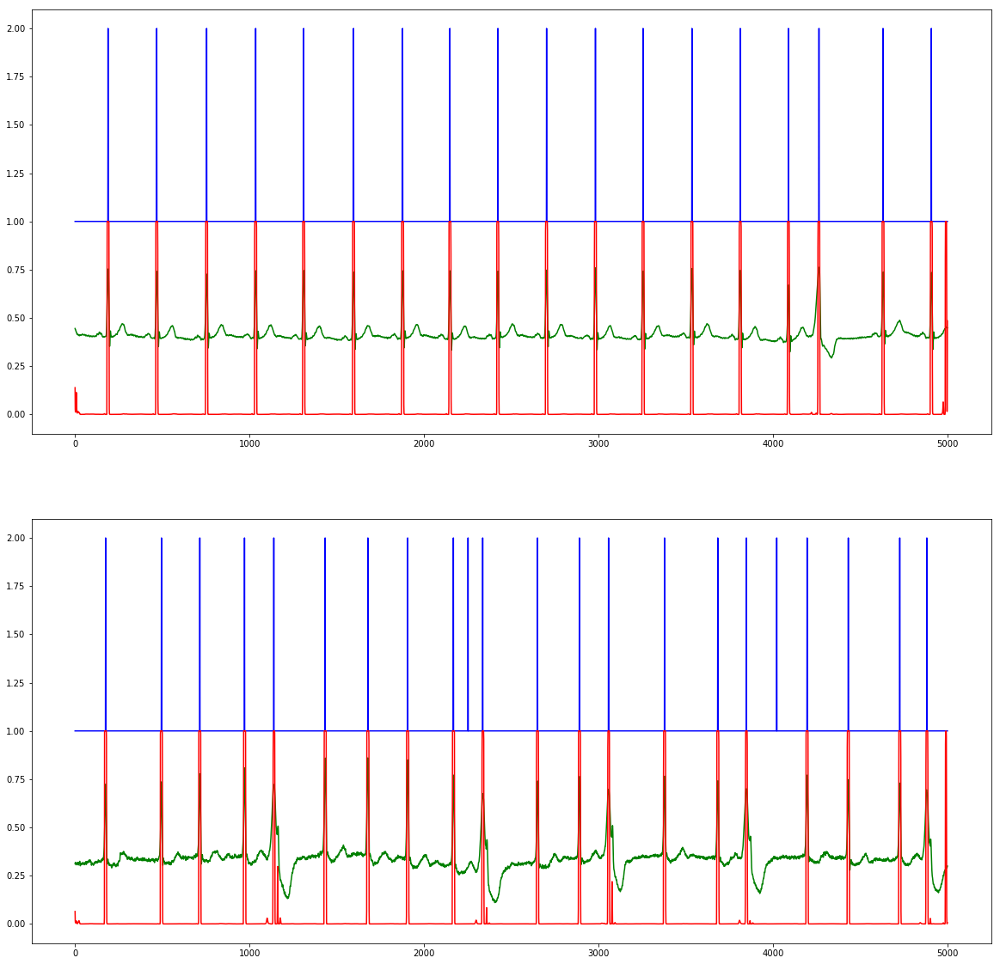

Epoch 76/100 running...Done in 4.649s!
  - training loss:		0.152000
  - test loss:			0.144182
  - test accuracy:		99.6389 %


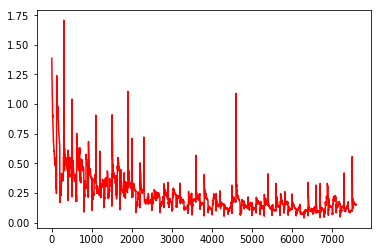

[[[ 0.73517543  0.30505136  0.12530473 ...,  0.27355137  0.47307742
    0.92259699]]]
[[[ 0.90688872  0.85867399  0.8552658  ...,  0.12405501  0.25410089
    0.8259294 ]]]


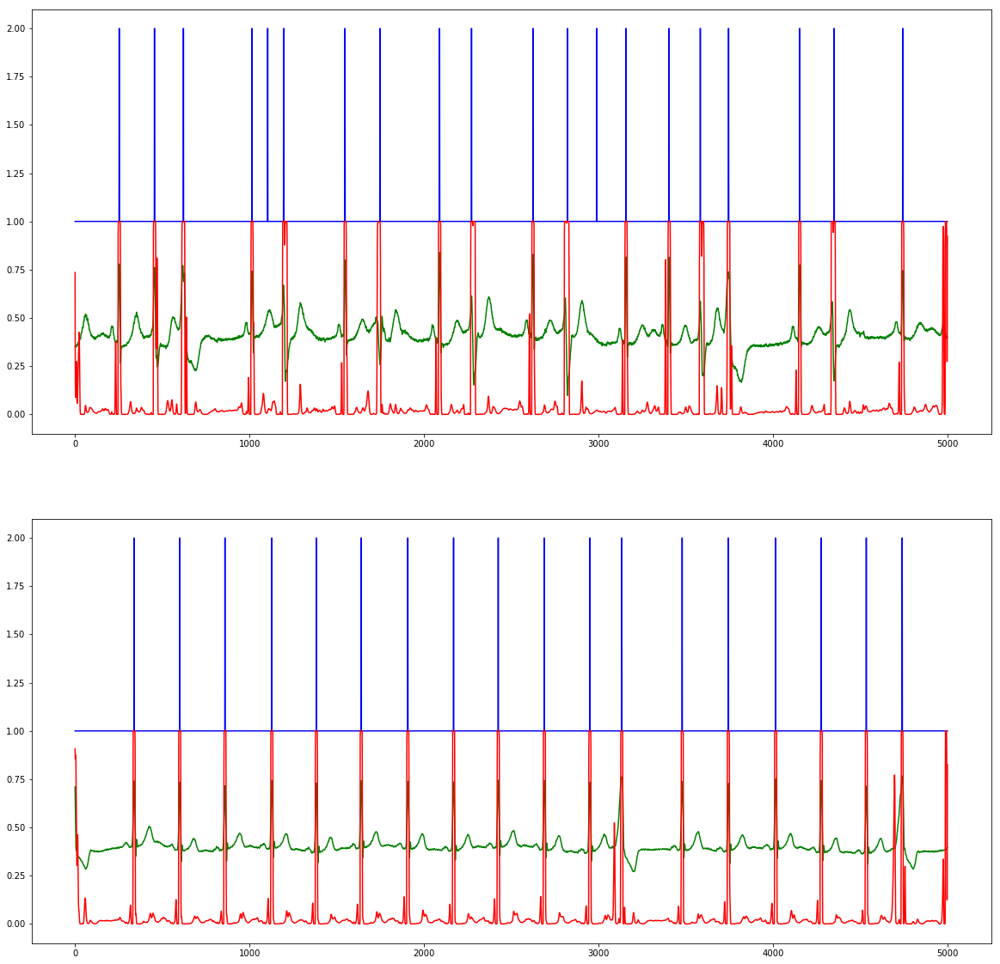

Epoch 77/100 running...Done in 4.662s!
  - training loss:		0.136387
  - test loss:			0.114554
  - test accuracy:		99.6389 %


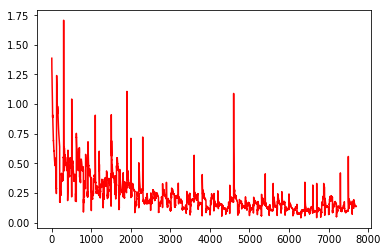

[[[ 0.64535624  0.06962959  0.01447575 ...,  0.10805694  0.36926827
    0.97749251]]]
[[[  2.51949608e-01   4.63409349e-02   1.72395688e-02 ...,   4.13530215e-05
     1.81428128e-04   3.16859572e-03]]]


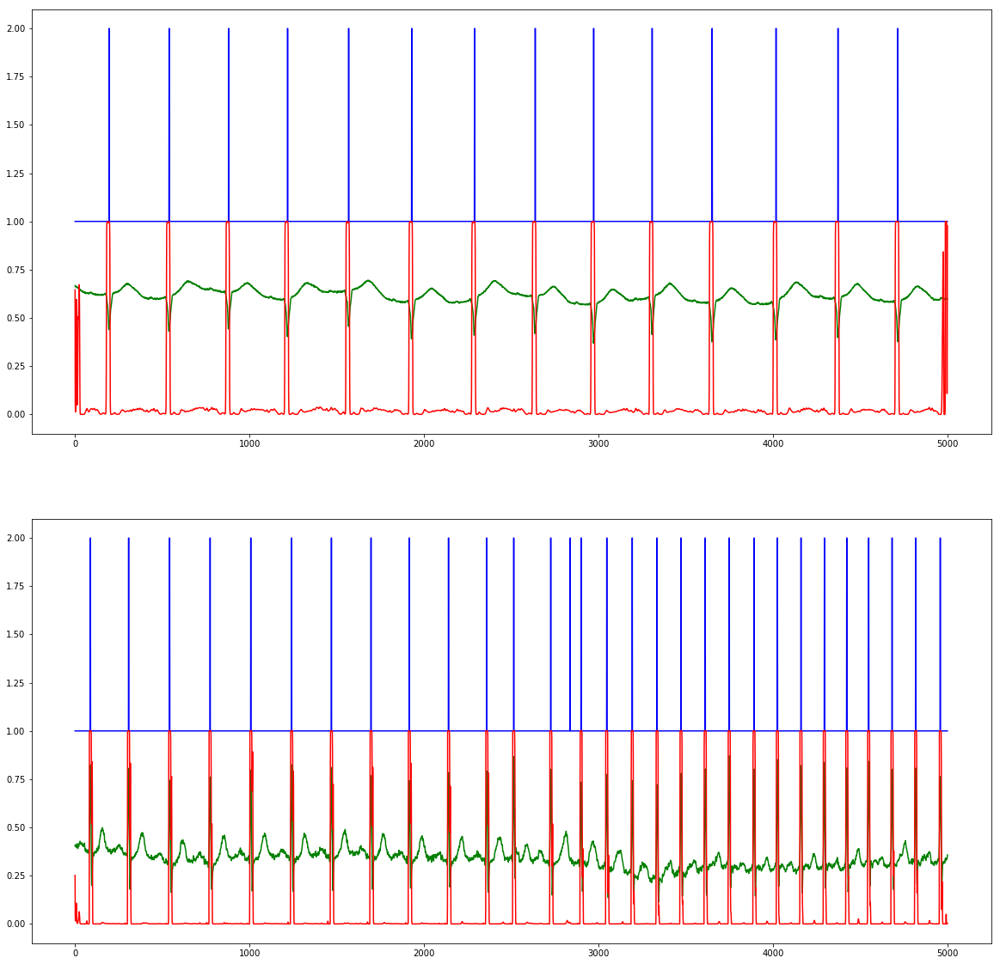

Epoch 78/100 running...Done in 4.591s!
  - training loss:		0.115822
  - test loss:			0.120846
  - test accuracy:		99.6389 %


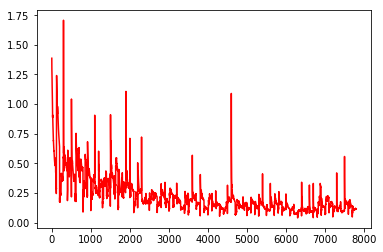

[[[ 0.44232777  0.08993647  0.02850853 ...,  0.0965974   0.21762414
    0.79061007]]]
[[[ 0.28037643  0.04060396  0.01245396 ...,  0.3891286   0.24053621
    0.48531231]]]


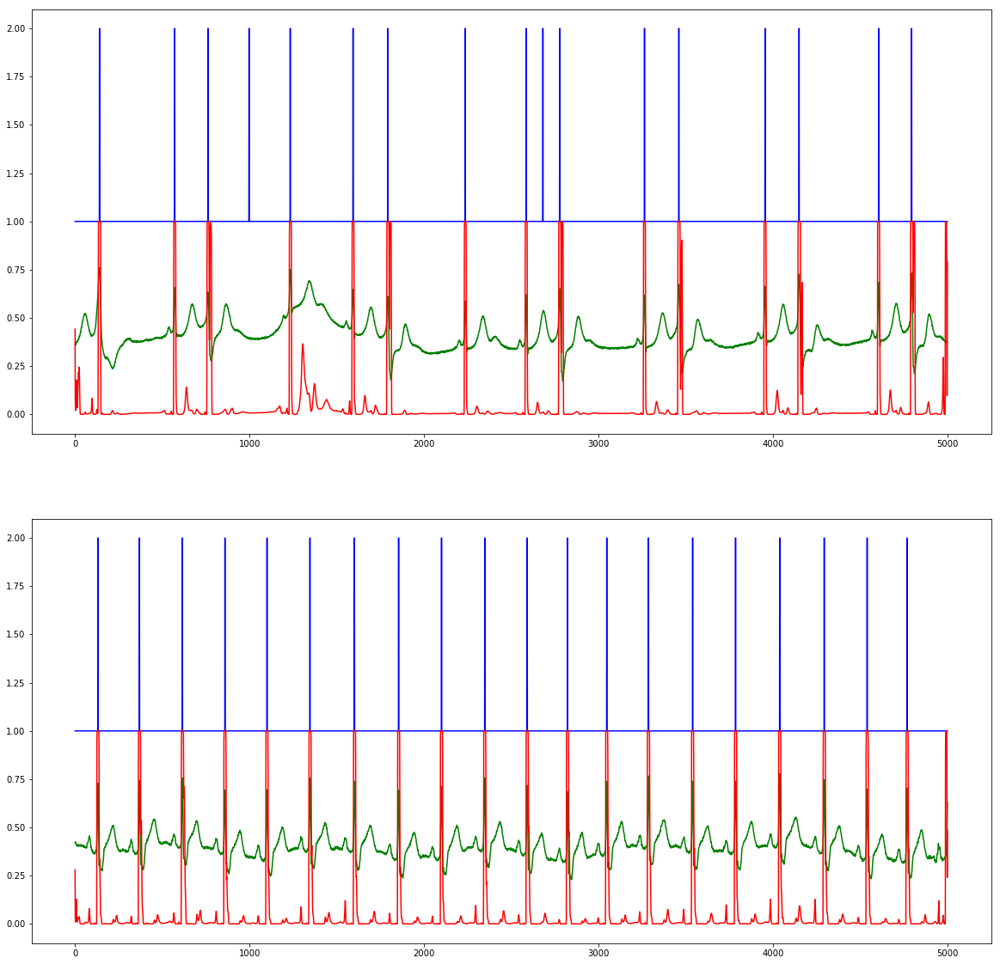

Epoch 79/100 running...Done in 4.614s!
  - training loss:		0.141886
  - test loss:			0.140873
  - test accuracy:		99.6389 %


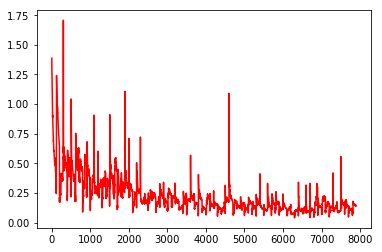

[[[ 0.0503053   0.02096873  0.01791265 ...,  0.00052296  0.00097727
    0.00691323]]]
[[[ 0.09196247  0.01938022  0.00776122 ...,  0.00121658  0.00142634
    0.0203715 ]]]


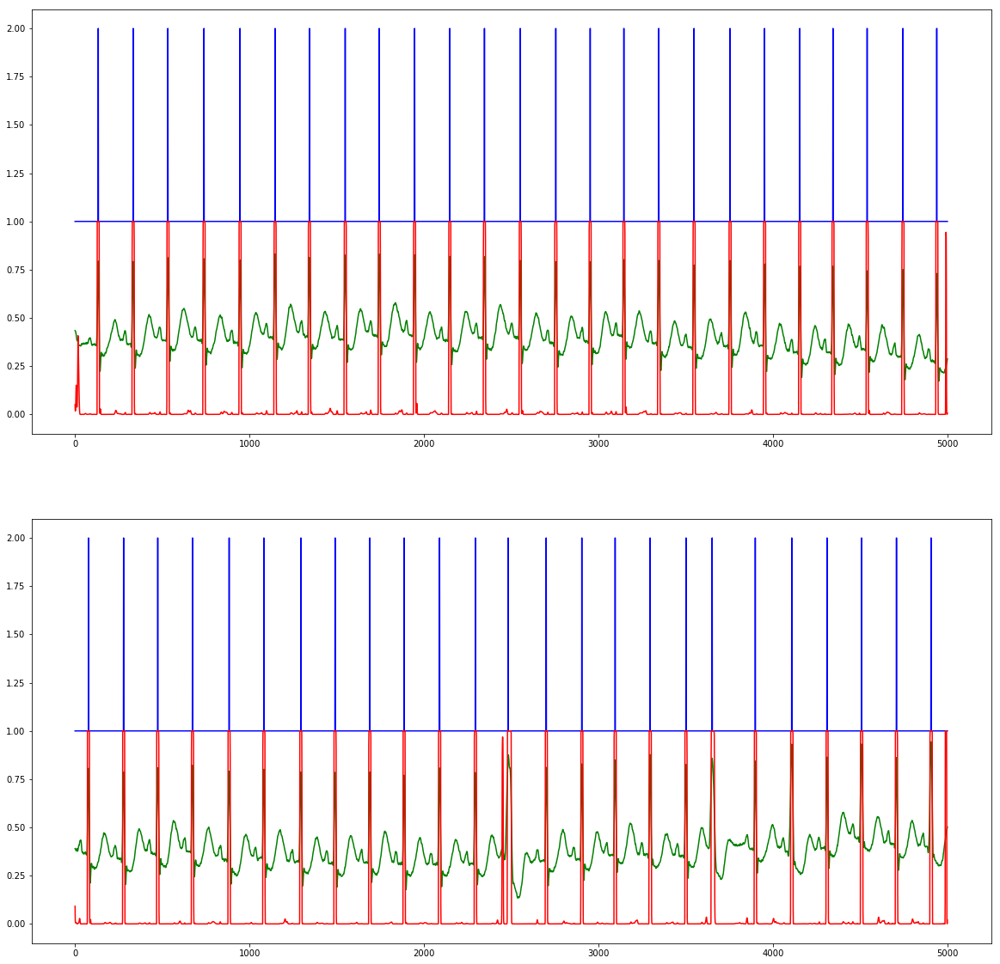

Epoch 80/100 running...Done in 4.617s!
  - training loss:		0.171119
  - test loss:			0.130653
  - test accuracy:		99.6389 %


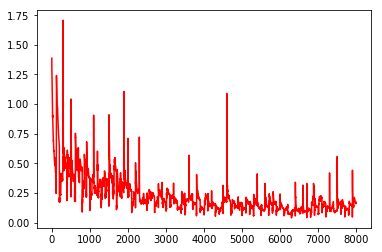

[[[ 0.77508259  0.16663931  0.03565801 ...,  0.02396367  0.06770866
    0.62074518]]]
[[[ 0.70482576  0.05834327  0.00810252 ...,  0.02037895  0.0505827
    0.51622486]]]


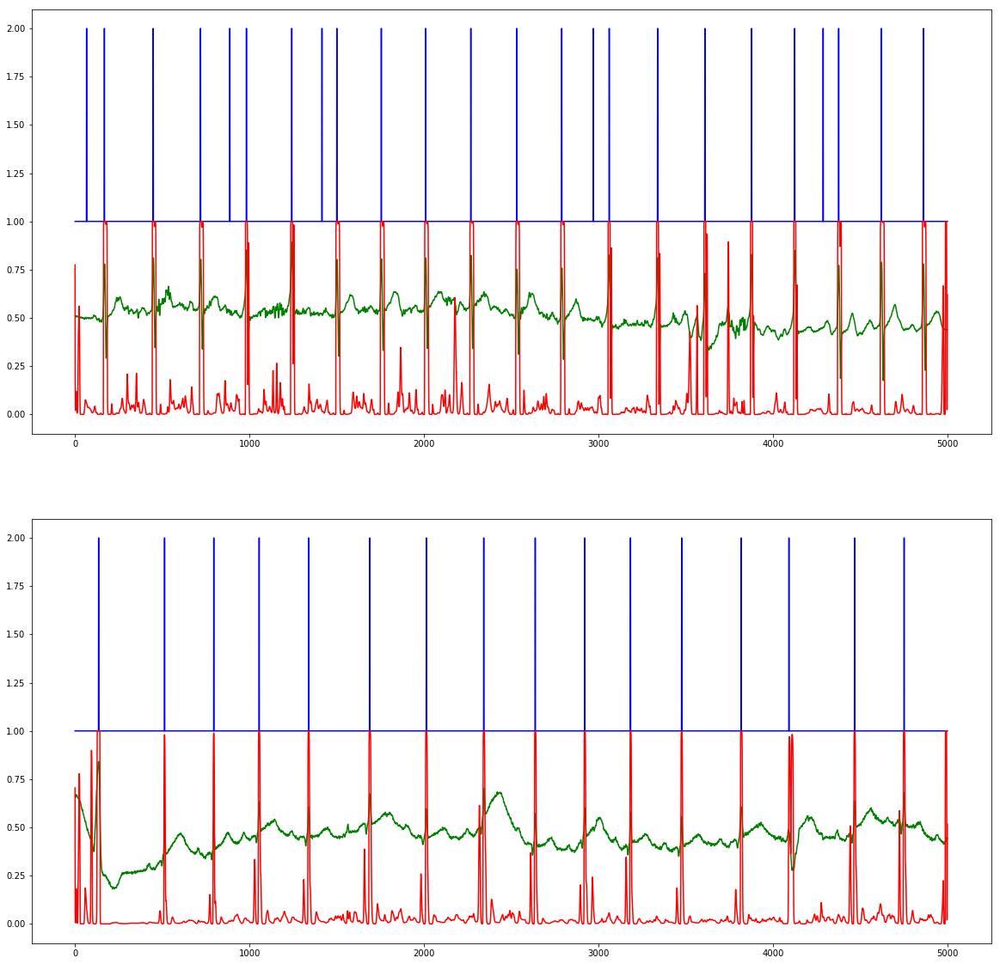

Epoch 81/100 running...Done in 4.634s!
  - training loss:		0.116814
  - test loss:			0.119346
  - test accuracy:		99.6389 %


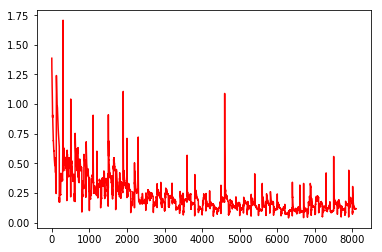

[[[  1.10085852e-01   3.96093819e-03   4.86808451e-04 ...,   1.89336091e-02
     8.80724788e-02   8.61485302e-01]]]
[[[ 0.5020988   0.06057102  0.01352048 ...,  0.00622882  0.02479369
    0.52180469]]]


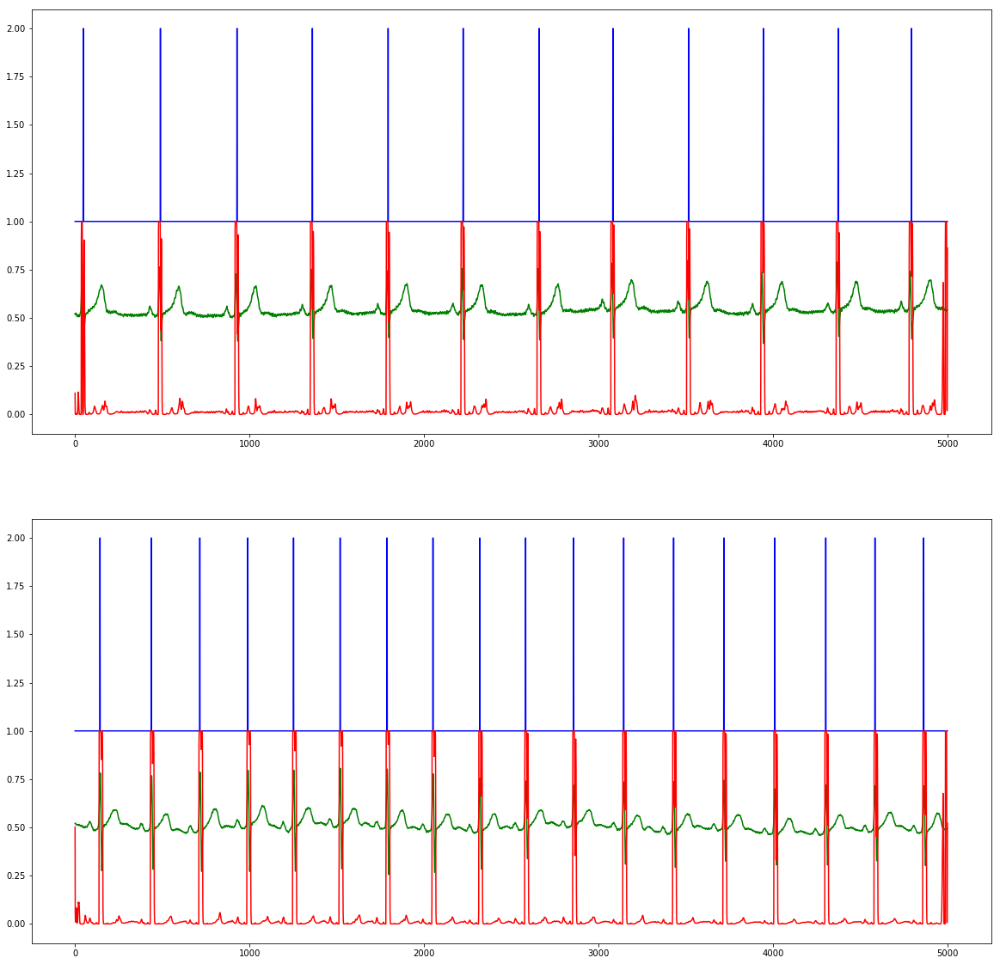

Epoch 82/100 running...Done in 4.609s!
  - training loss:		0.107239
  - test loss:			0.112232
  - test accuracy:		99.6389 %


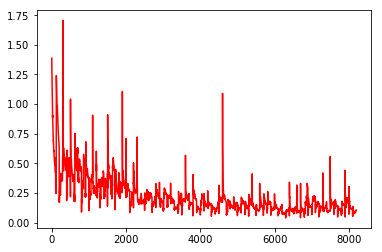

[[[ 0.82346916  0.15545182  0.02714359 ...,  0.01817739  0.07242313
    0.78711951]]]
[[[ 0.43099499  0.06779104  0.01737505 ...,  0.00556924  0.01884141
    0.29299298]]]


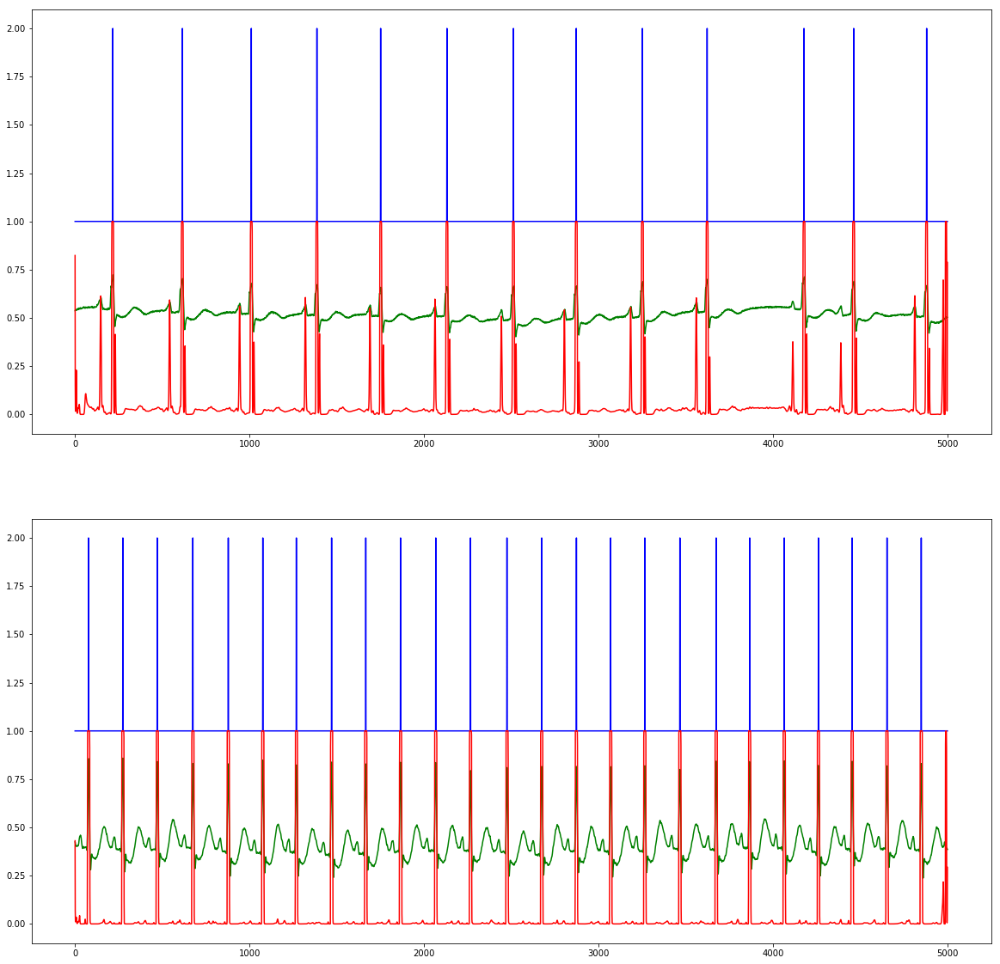

Epoch 83/100 running...Done in 4.658s!
  - training loss:		0.112559
  - test loss:			0.106130
  - test accuracy:		99.6389 %


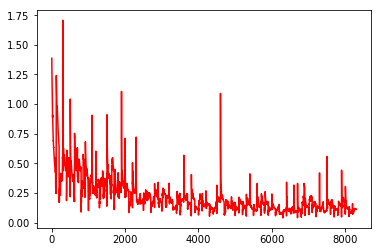

[[[ 0.84160948  0.11558262  0.01587889 ...,  0.02551932  0.13584611
    0.93781394]]]
[[[  4.56943316e-03   2.49329023e-04   8.69115684e-05 ...,   8.95569101e-03
     5.47034331e-02   9.00800884e-01]]]


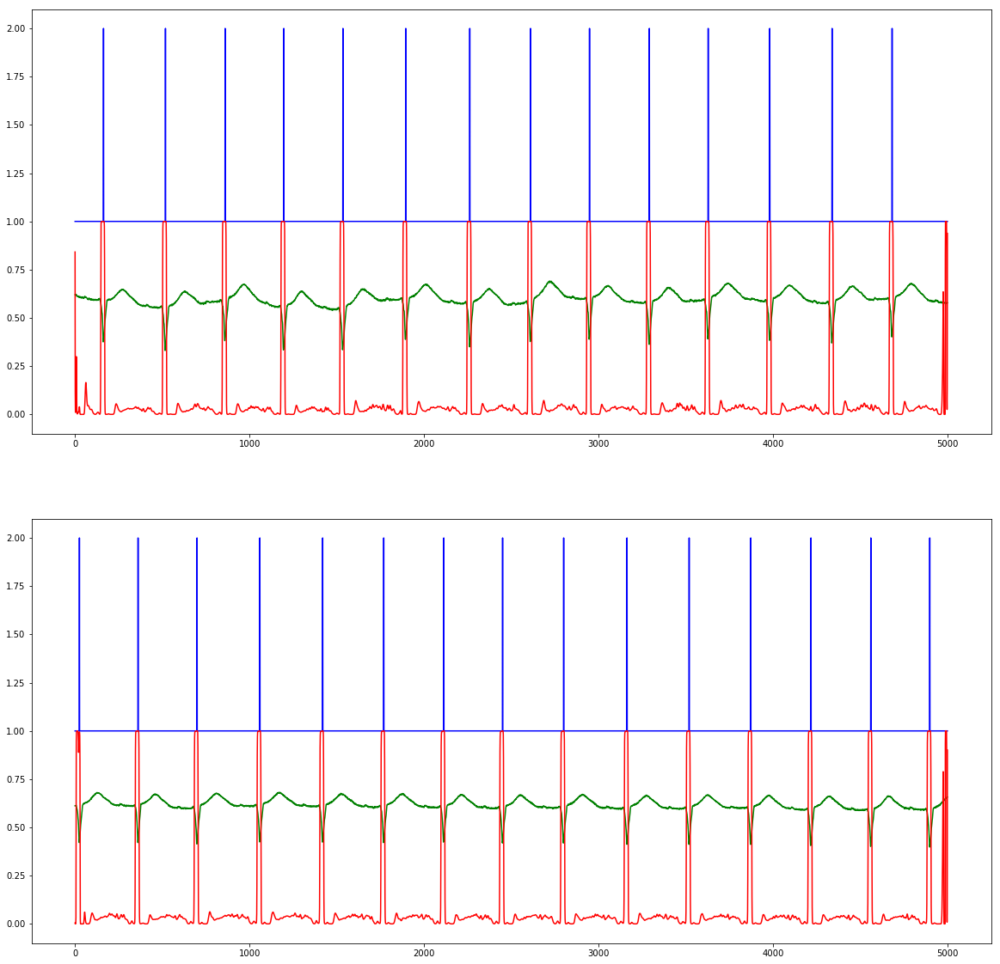

Epoch 84/100 running...Done in 4.605s!
  - training loss:		0.099290
  - test loss:			0.107930
  - test accuracy:		99.6389 %


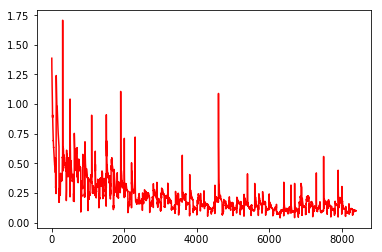

[[[ 0.58599246  0.02878036  0.0032832  ...,  0.02693469  0.10534144
    0.77407795]]]
[[[ 0.39848691  0.03315617  0.00541984 ...,  0.00843477  0.03485899
    0.49694961]]]


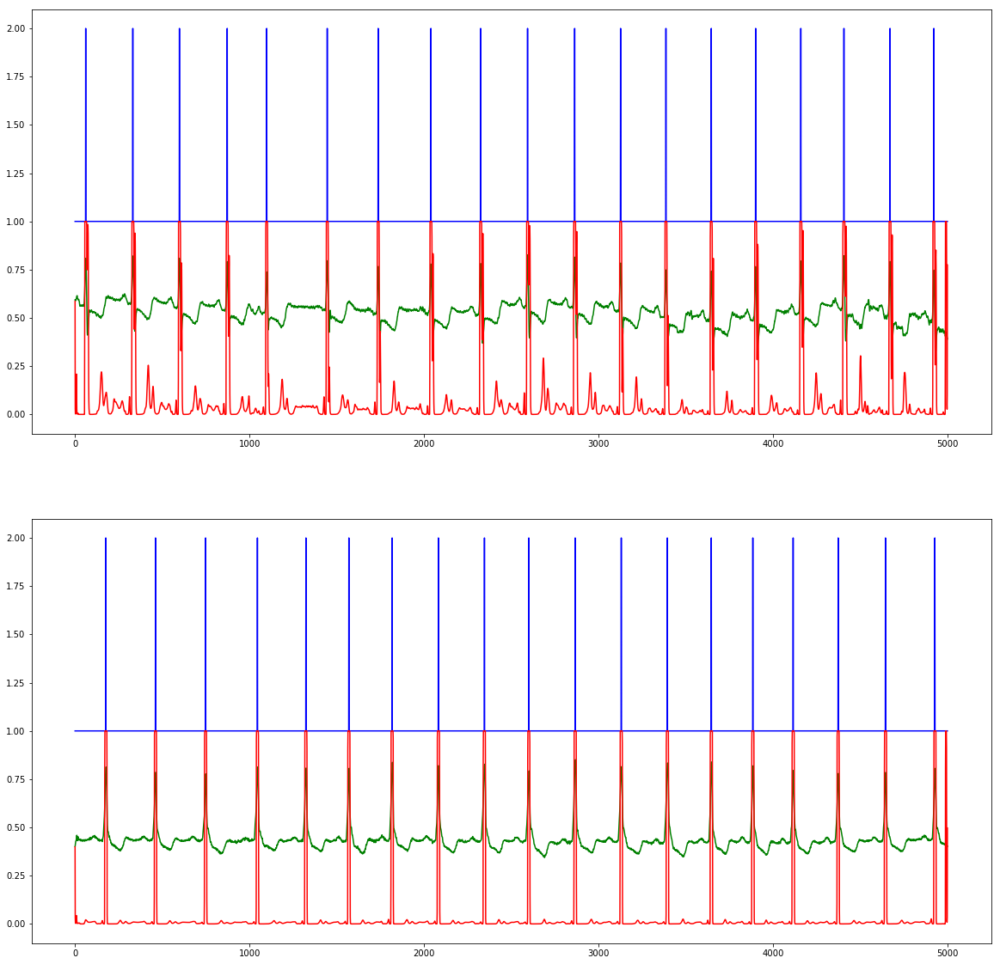

Epoch 85/100 running...Done in 4.610s!
  - training loss:		0.091103
  - test loss:			0.107257
  - test accuracy:		99.6389 %


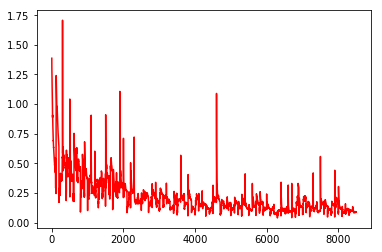

[[[ 0.43580651  0.15039586  0.05888018 ...,  0.00253113  0.00688876
    0.08432896]]]
[[[  2.91857645e-02   2.00196472e-03   4.19736723e-04 ...,   3.76490736e-03
     1.98494345e-02   5.88802993e-01]]]


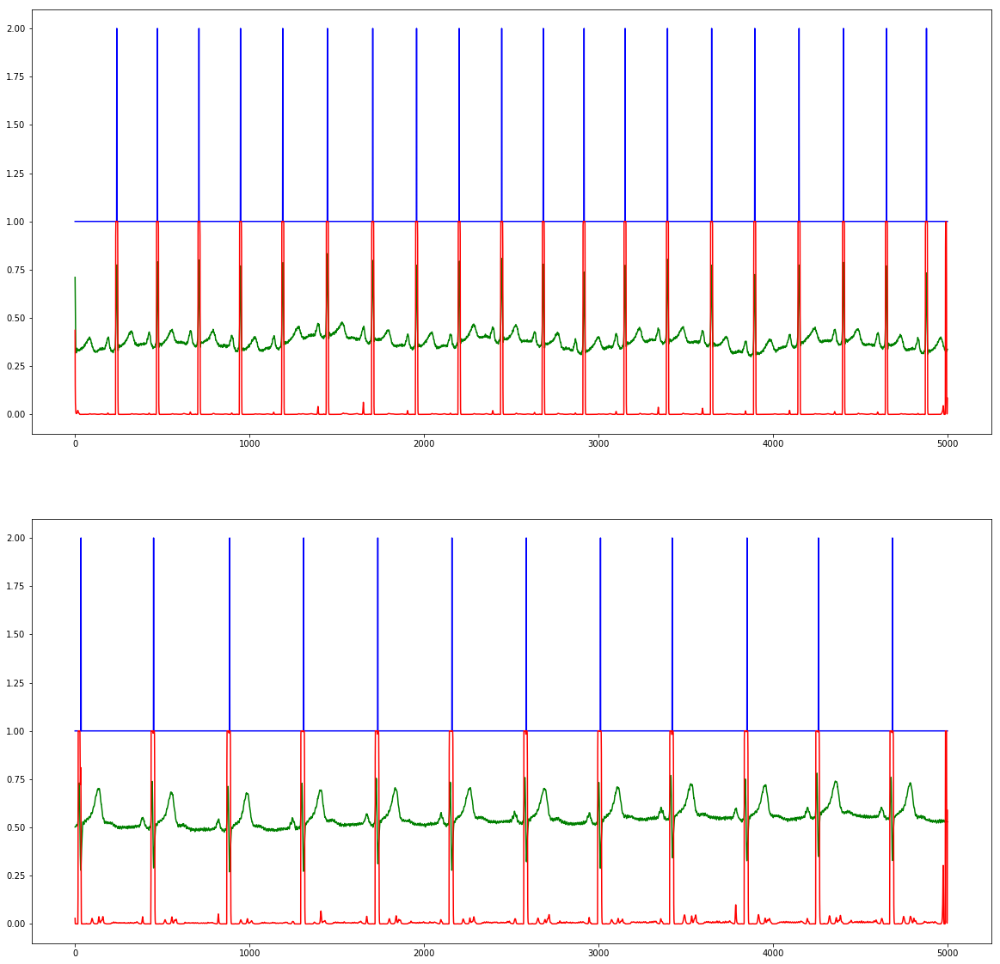

Epoch 86/100 running...Done in 4.625s!
  - training loss:		0.108999
  - test loss:			0.108217
  - test accuracy:		99.6389 %


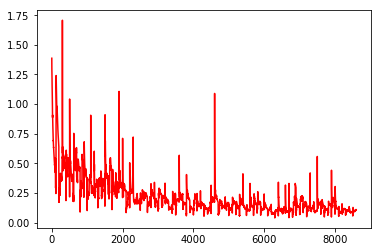

[[[ 0.63479918  0.09080373  0.01499569 ...,  0.00147781  0.00469752
    0.08623926]]]
[[[ 0.25496882  0.01786109  0.00358323 ...,  0.0010113   0.00106555
    0.02885725]]]


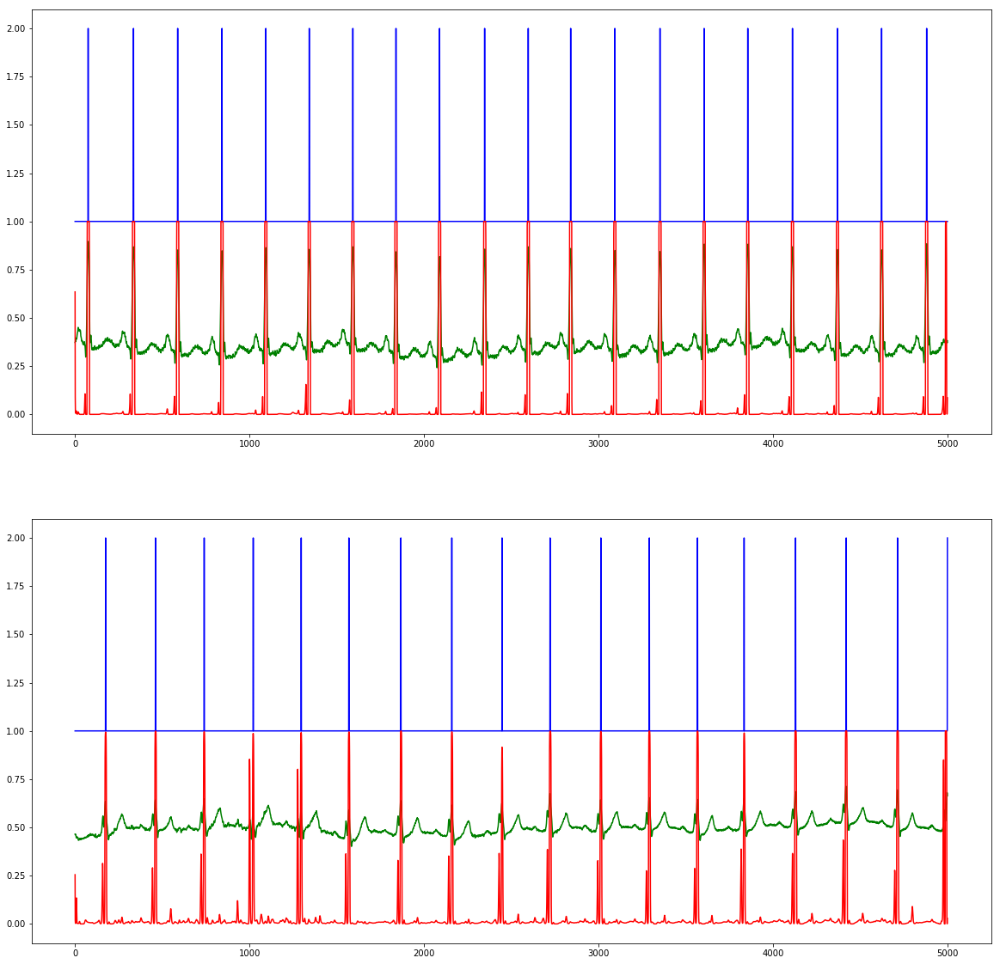

Epoch 87/100 running...Done in 4.641s!
  - training loss:		0.084407
  - test loss:			0.108889
  - test accuracy:		99.6389 %


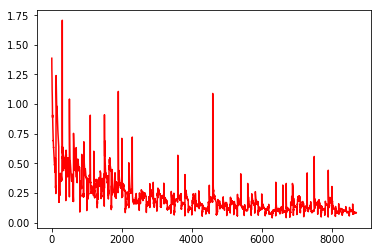

[[[ 0.2889618   0.01715275  0.00319824 ...,  0.00176646  0.00736965
    0.26331151]]]
[[[ 0.37191528  0.03114101  0.00617861 ...,  0.00227443  0.01053065
    0.33482152]]]


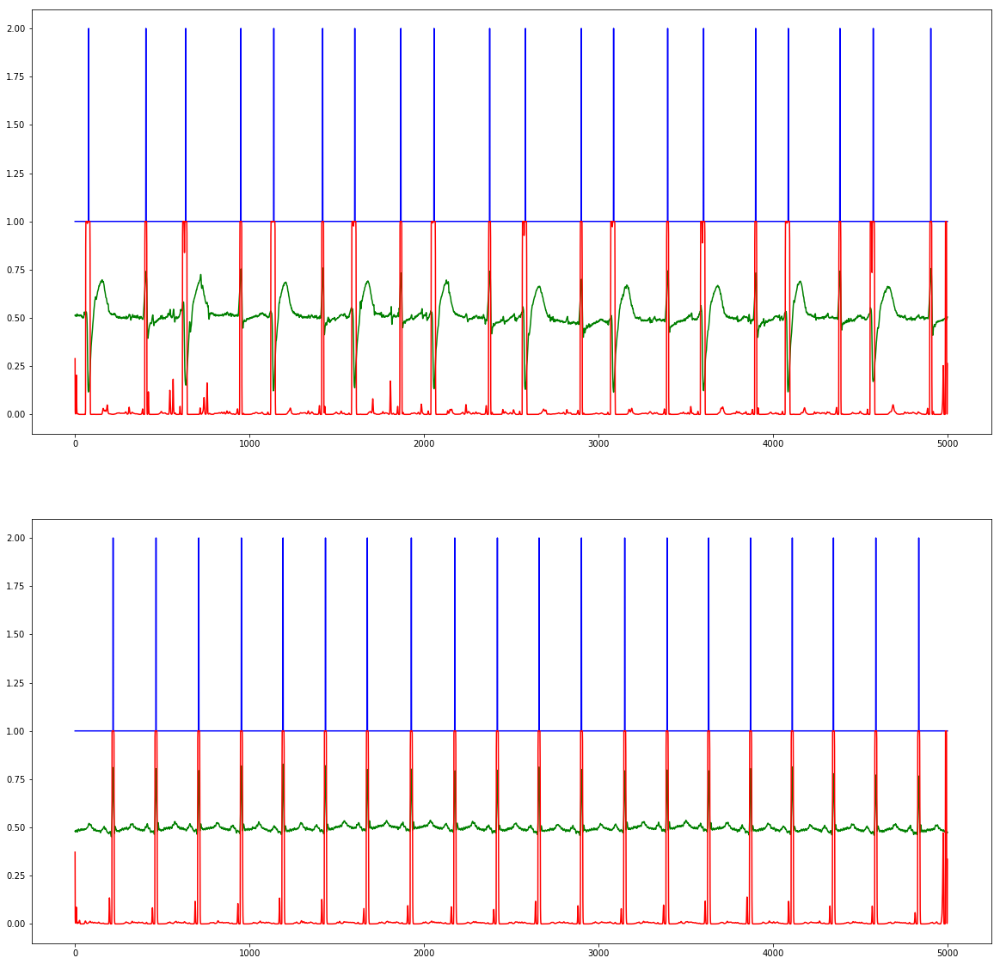

Epoch 88/100 running...Done in 4.616s!
  - training loss:		0.131148
  - test loss:			0.113274
  - test accuracy:		99.6389 %


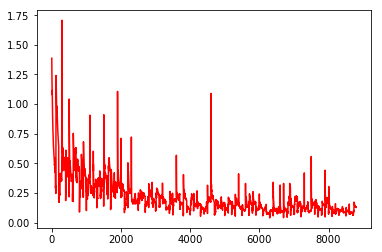

[[[ 0.2242209   0.01133701  0.002437   ...,  0.0006636   0.00415095
    0.3458679 ]]]
[[[ 0.0318612   0.0077251   0.00335278 ...,  0.00289123  0.00620482
    0.04689065]]]


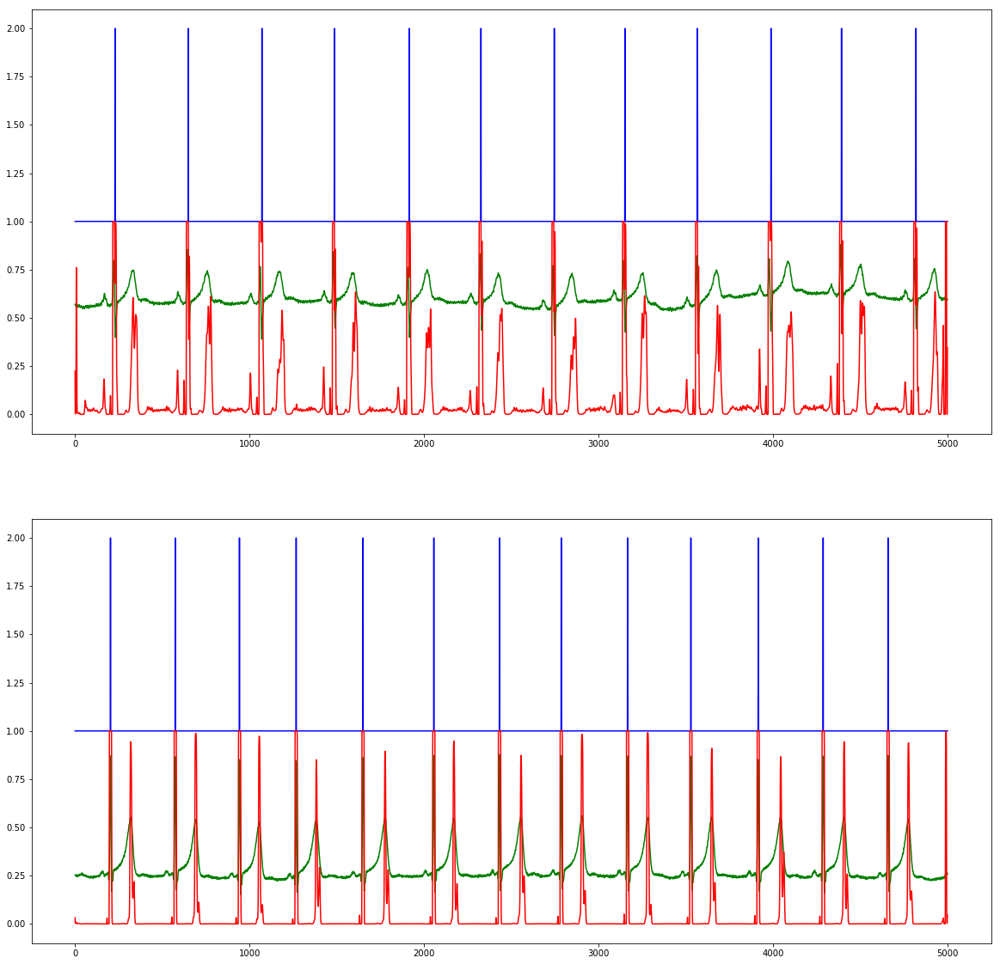

Epoch 89/100 running...Done in 4.682s!
  - training loss:		0.118379
  - test loss:			0.113322
  - test accuracy:		99.6389 %


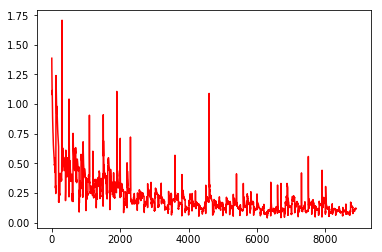

[[[ 0.30212232  0.02541708  0.00628422 ...,  0.00280938  0.01123318
    0.2959241 ]]]
[[[  2.63469666e-01   2.96002682e-02   1.11594098e-02 ...,   1.19640441e-04
     7.70873274e-04   7.08868131e-02]]]


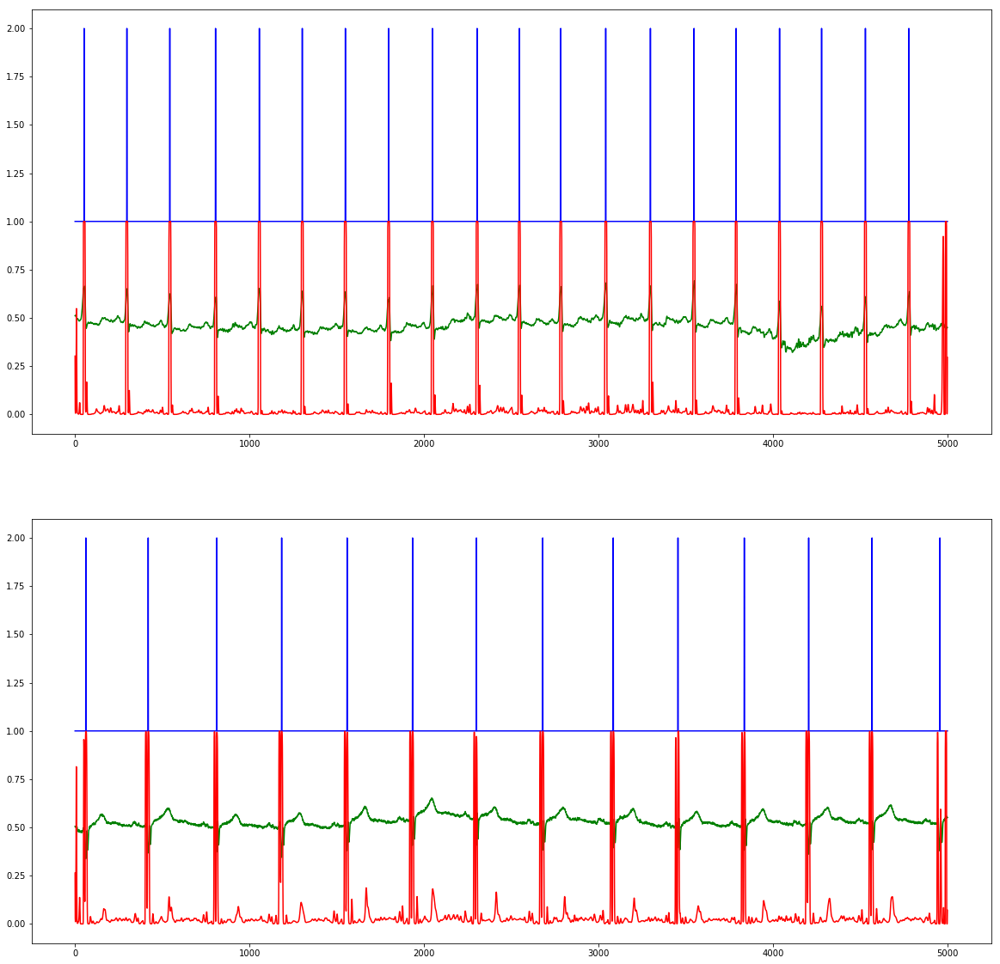

Epoch 90/100 running...Done in 4.590s!
  - training loss:		0.111103
  - test loss:			0.103776
  - test accuracy:		99.6389 %


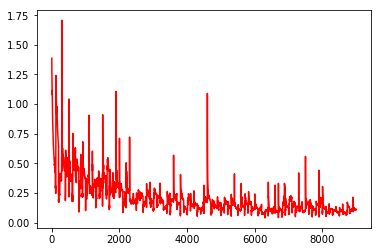

[[[ 0.15087895  0.03193225  0.01869841 ...,  0.0018167   0.00539645
    0.10866586]]]
[[[ 0.22174177  0.02999434  0.00987944 ...,  0.00265327  0.01089404
    0.26105881]]]


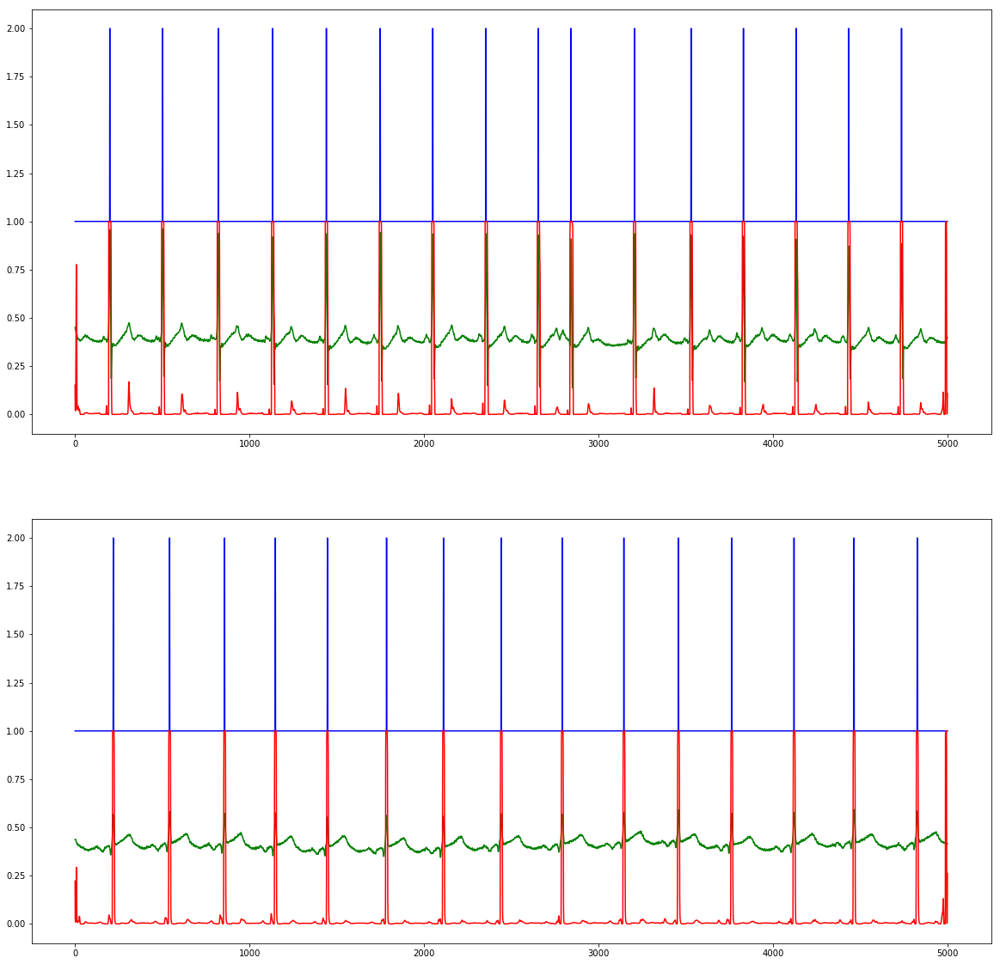

Epoch 91/100 running...Done in 4.610s!
  - training loss:		0.085593
  - test loss:			0.107208
  - test accuracy:		99.6389 %


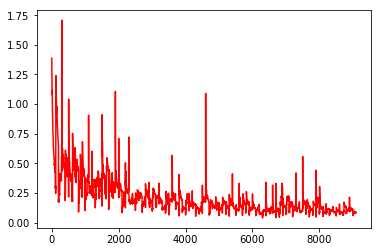

[[[ 0.09957831  0.011731    0.00322355 ...,  0.0004077   0.00130444
    0.03619673]]]
[[[  1.05788536e-01   8.49699788e-03   1.75471627e-03 ...,   9.23761581e-06
     5.81111090e-05   3.29082808e-03]]]


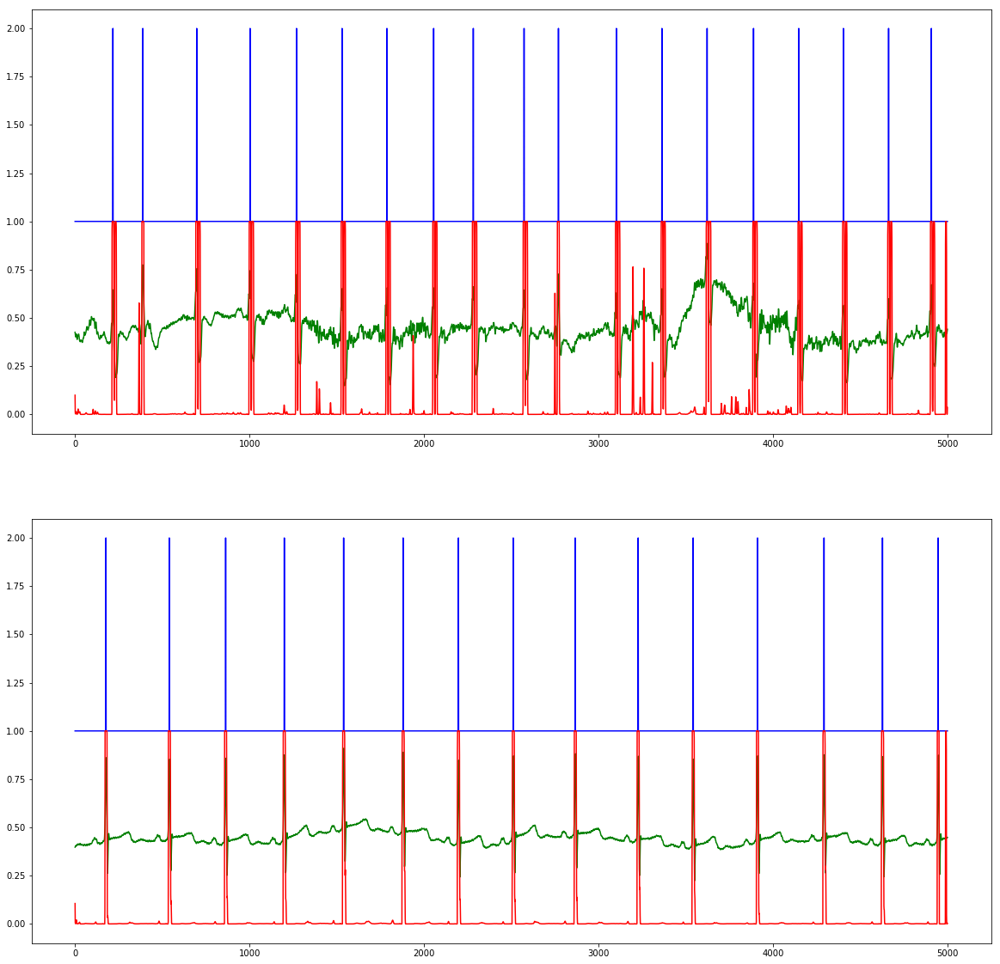

Epoch 92/100 running...Done in 4.664s!
  - training loss:		0.104166
  - test loss:			0.103888
  - test accuracy:		99.6389 %


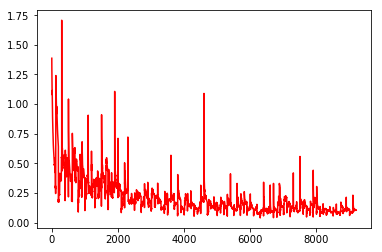

[[[  2.41493300e-01   1.24216797e-02   1.84744445e-03 ...,   8.49068456e-05
     2.91724456e-04   7.75539083e-03]]]
[[[ 0.05525973  0.00661175  0.00180415 ...,  0.00039223  0.00118796
    0.02032795]]]


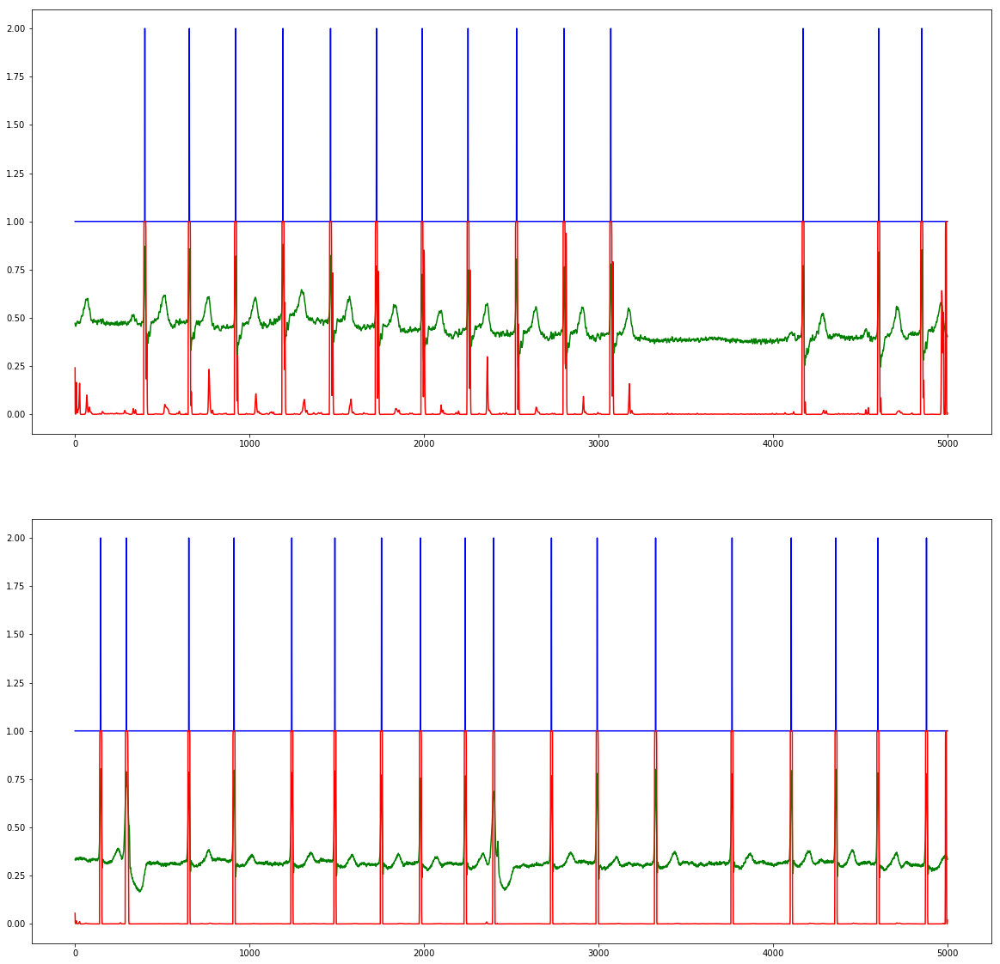

Epoch 93/100 running...Done in 4.591s!
  - training loss:		0.165012
  - test loss:			0.136289
  - test accuracy:		99.6389 %


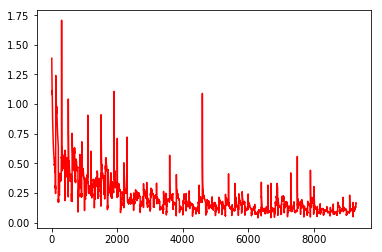

[[[ 0.00930581  0.00273407  0.00171255 ...,  0.00242769  0.0072446
    0.11848266]]]
[[[  9.91548717e-01   9.40079093e-01   7.15217173e-01 ...,   4.27458851e-08
     8.44072119e-08   2.53393250e-06]]]


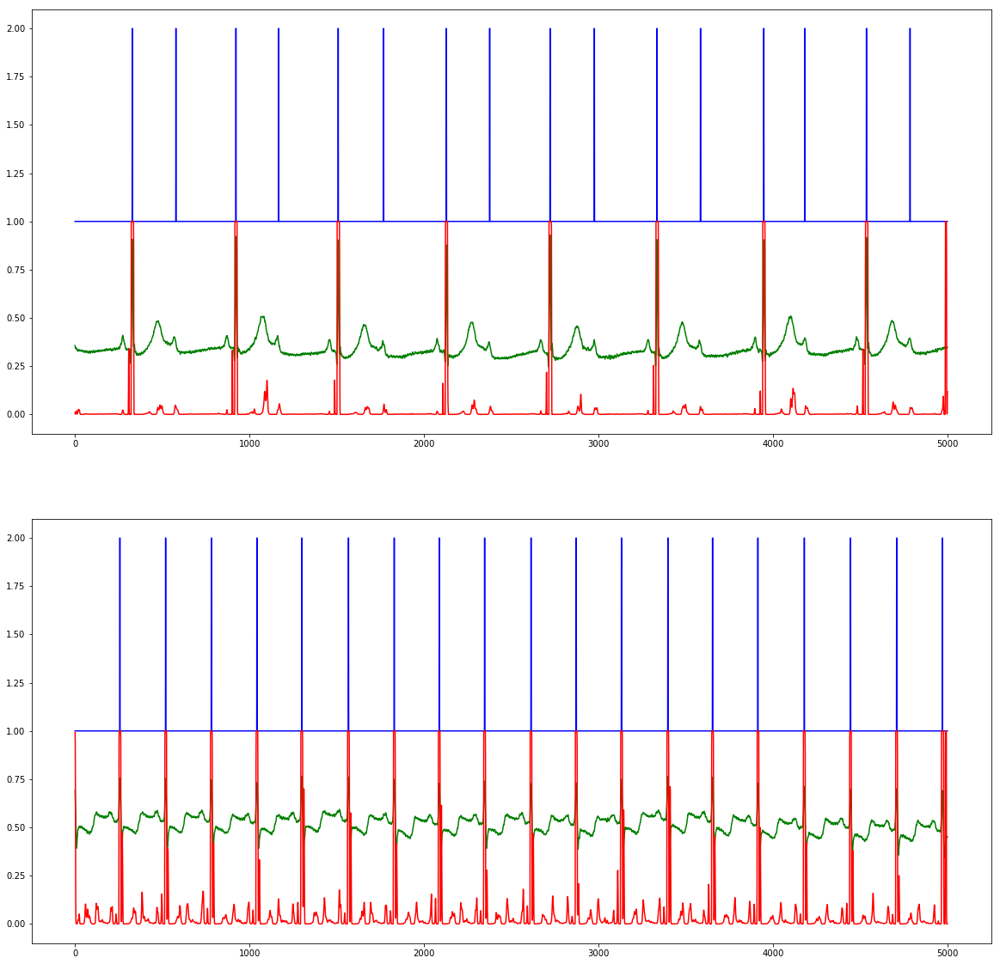

Epoch 94/100 running...Done in 4.707s!
  - training loss:		0.185487
  - test loss:			0.129244
  - test accuracy:		99.6389 %


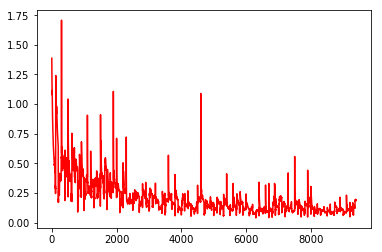

[[[ 0.7805326   0.09417546  0.00967511 ...,  0.00082836  0.00214615
    0.22735213]]]
[[[ 0.02118147  0.00389143  0.00232464 ...,  0.00195424  0.00579106
    0.13304202]]]


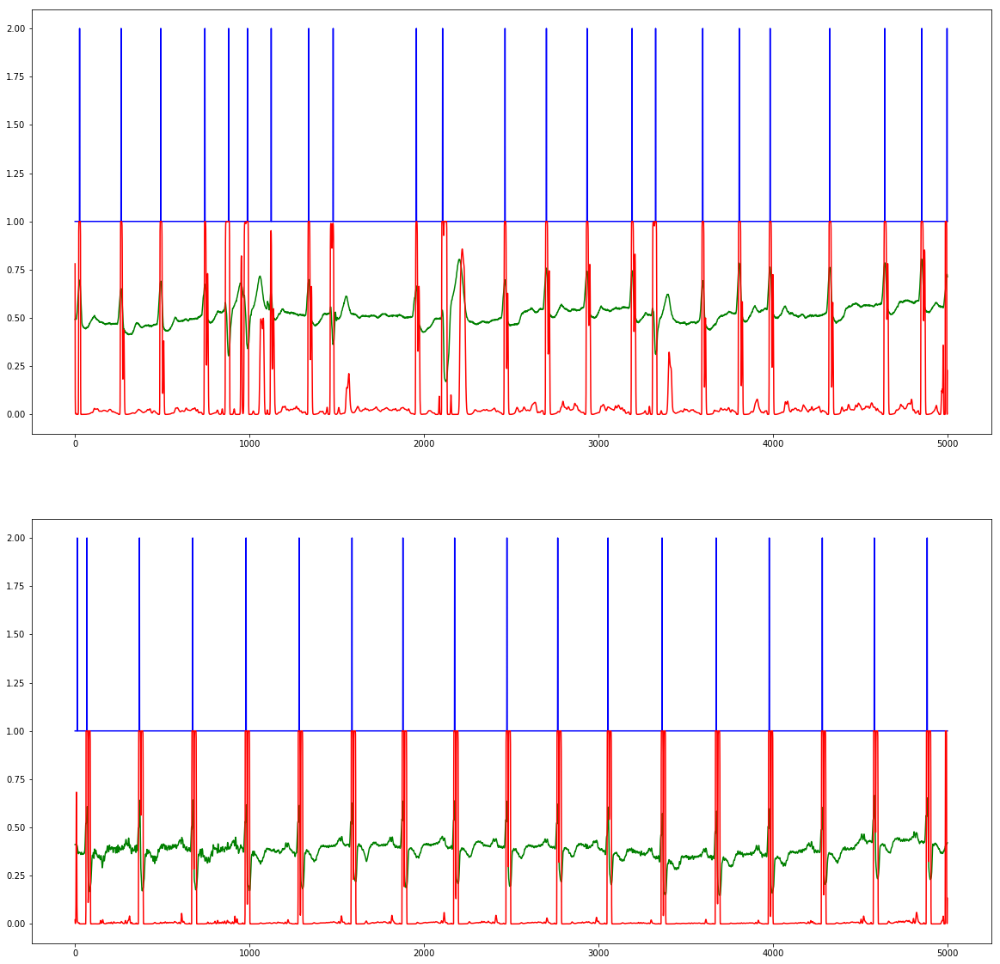

Epoch 95/100 running...Done in 4.596s!
  - training loss:		0.106005
  - test loss:			0.109880
  - test accuracy:		99.6389 %


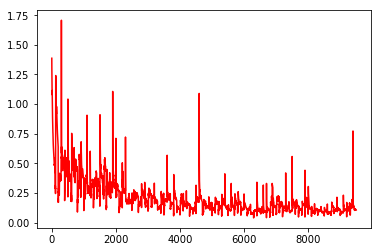

[[[ 0.69225538  0.04455788  0.00578064 ...,  0.00146275  0.00907369
    0.57781768]]]
[[[  4.41115499e-01   2.94131115e-02   5.95974084e-03 ...,   4.22330661e-04
     2.43815989e-03   1.79416716e-01]]]


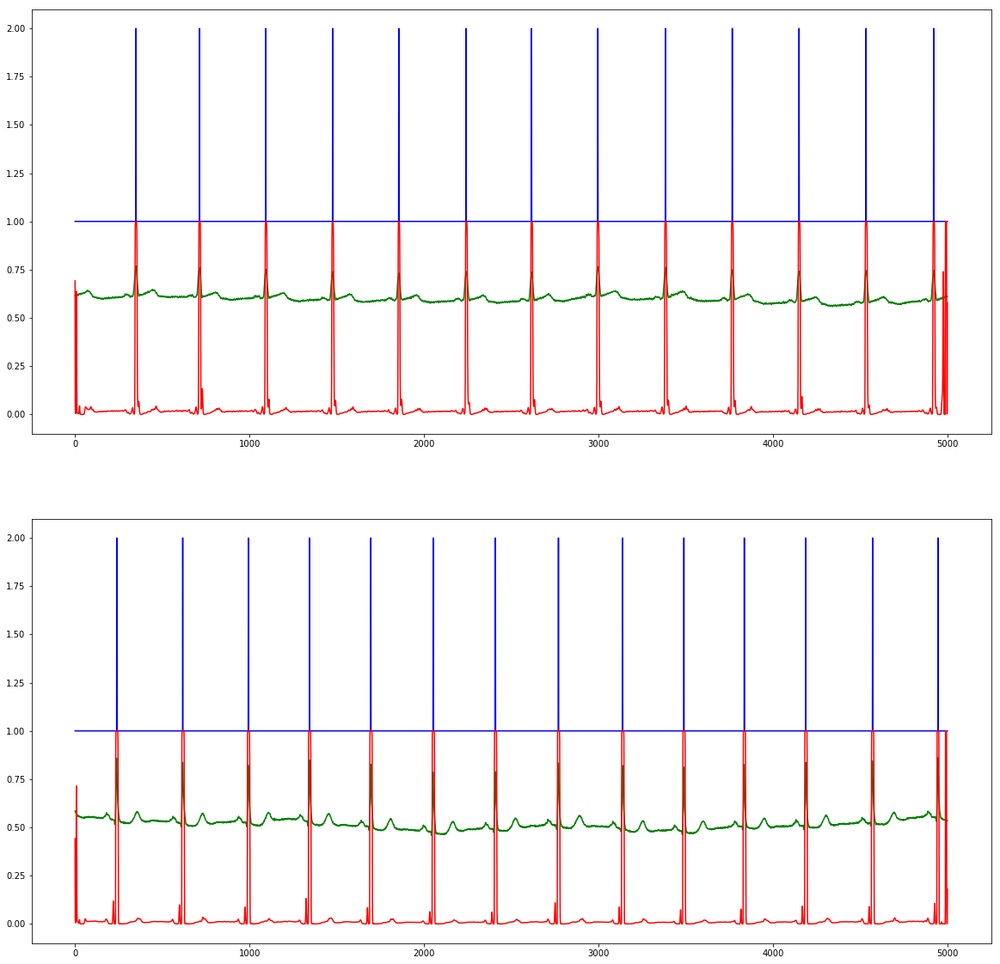

Epoch 96/100 running...Done in 4.619s!
  - training loss:		0.143004
  - test loss:			0.109593
  - test accuracy:		99.6389 %


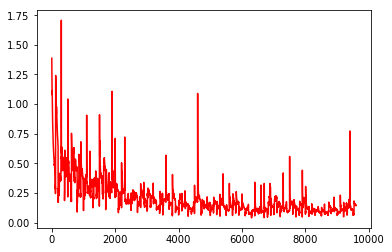

[[[ 0.00597347  0.00071178  0.00029257 ...,  0.00043199  0.00049014
    0.00711973]]]
[[[ 0.76020193  0.07434808  0.00978603 ...,  0.00147745  0.01027923
    0.58842069]]]


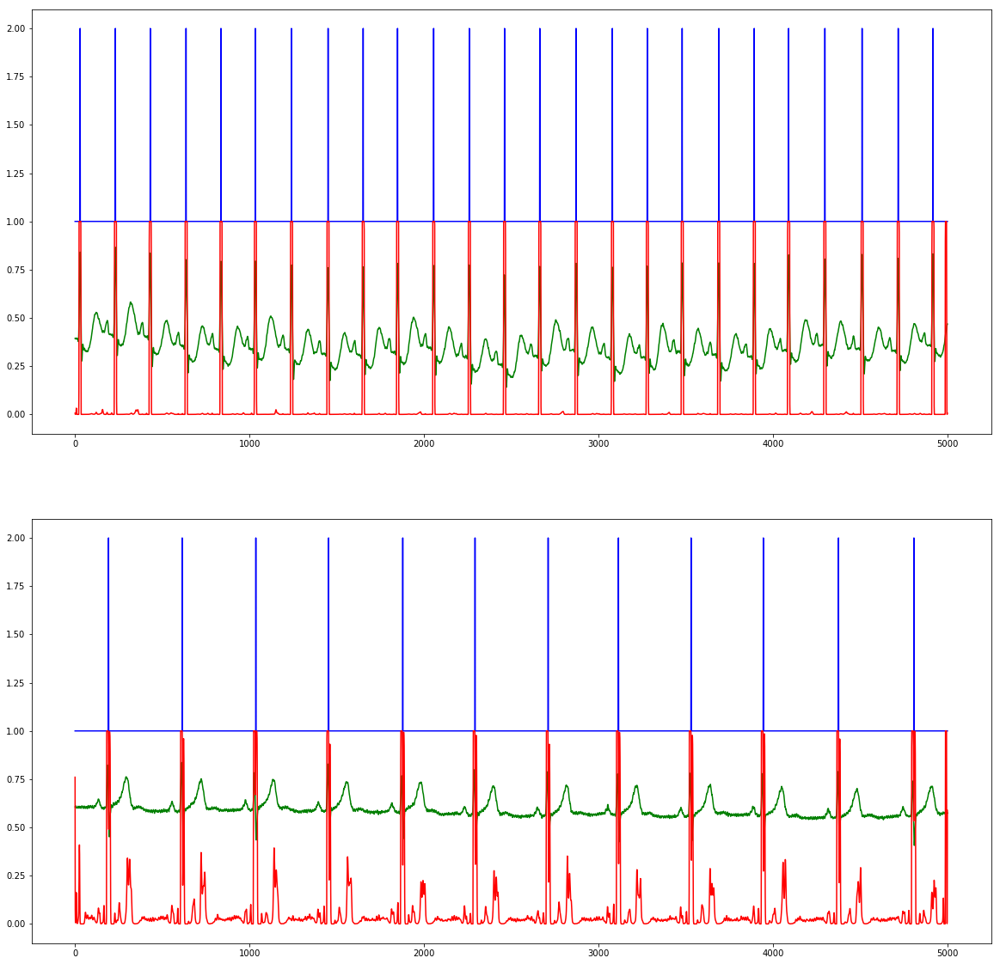

Epoch 97/100 running...Done in 4.707s!
  - training loss:		0.085669
  - test loss:			0.180248
  - test accuracy:		99.6389 %


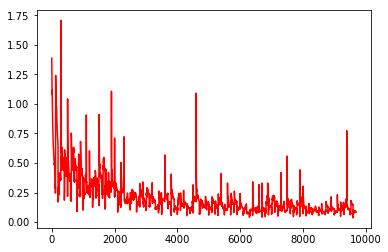

[[[  1.93360522e-02   5.32133412e-03   4.79822652e-03 ...,   9.50859321e-05
     3.47104651e-04   8.46317038e-03]]]
[[[ 0.03684973  0.00576519  0.00197422 ...,  0.00024978  0.0006881
    0.01145367]]]


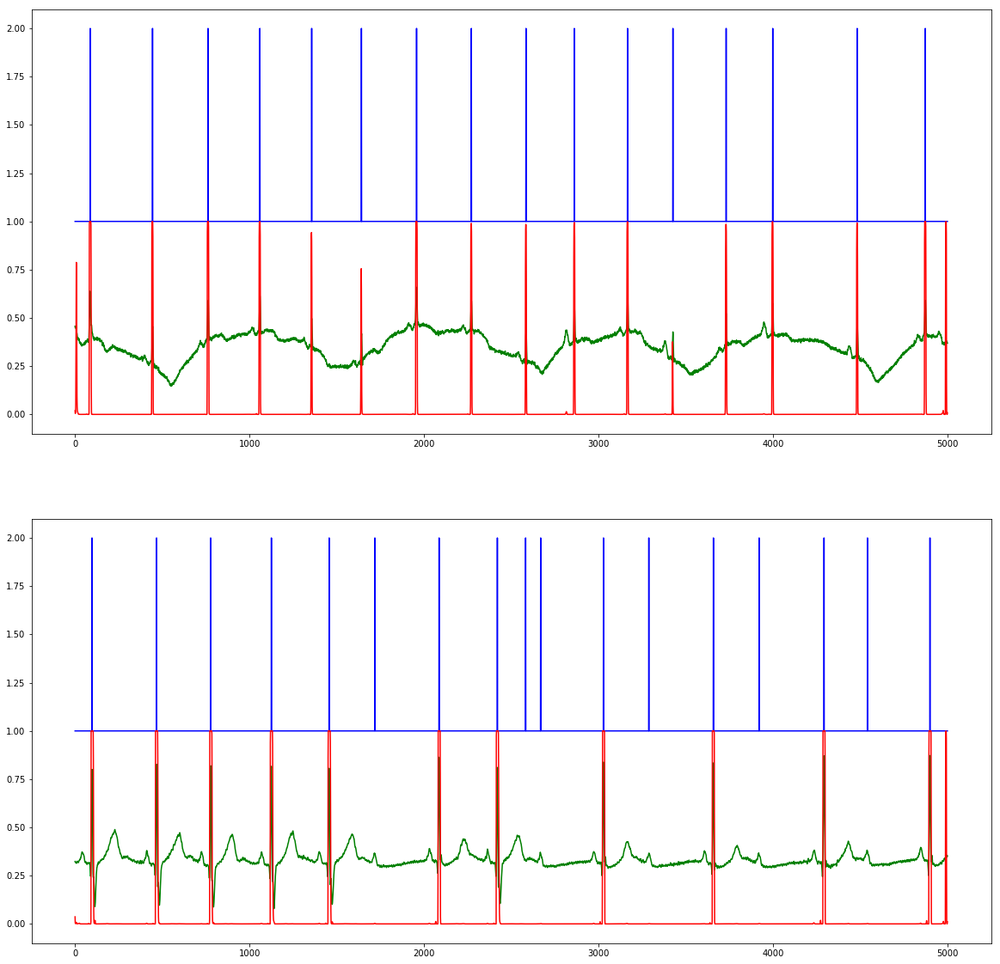

Epoch 98/100 running...Done in 4.709s!
  - training loss:		0.115939
  - test loss:			0.115572
  - test accuracy:		99.6389 %


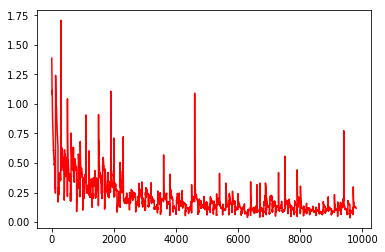

[[[ 0.54517442  0.04727445  0.00795911 ...,  0.00073484  0.00290425
    0.14405587]]]
[[[  1.01162735e-02   6.83015026e-03   8.45474470e-03 ...,   1.19616400e-10
     2.58671573e-09   2.03591668e-07]]]


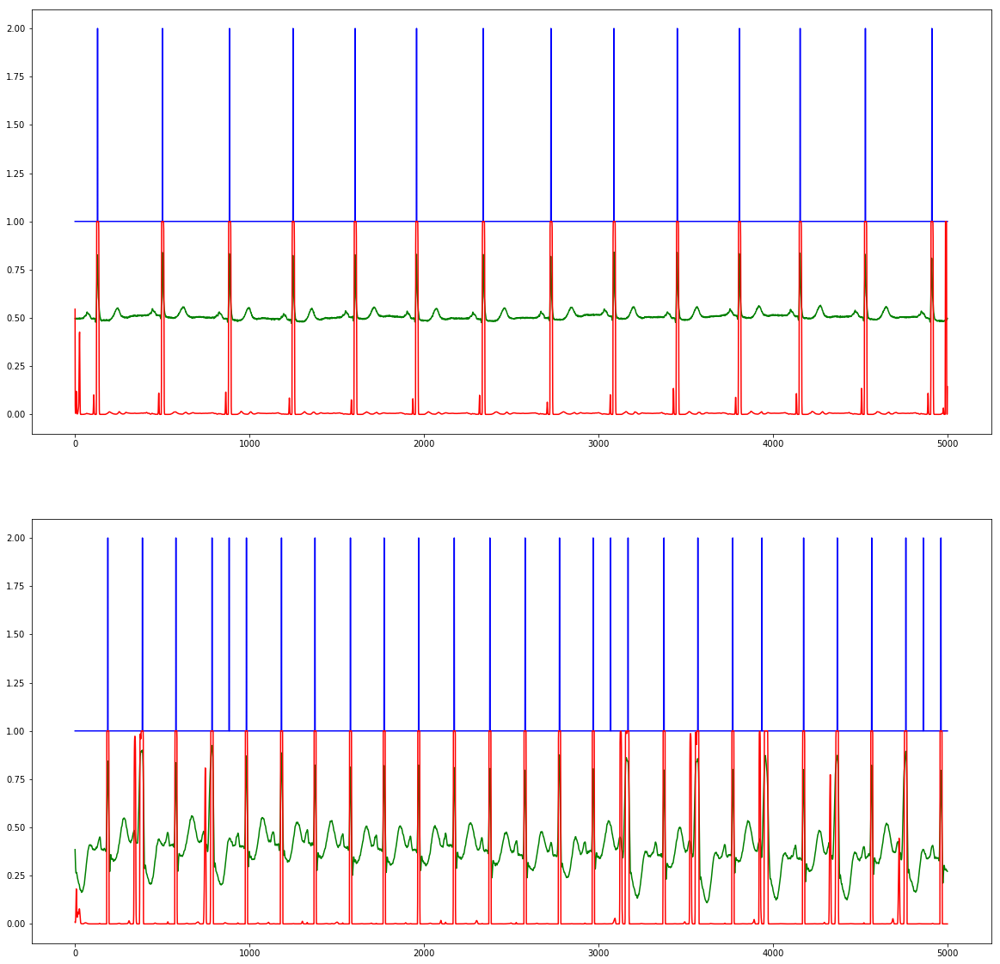

Epoch 99/100 running...Done in 4.730s!
  - training loss:		0.133495
  - test loss:			0.122436
  - test accuracy:		99.6389 %


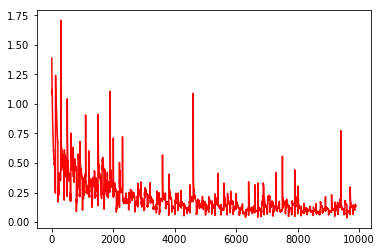

[[[ 0.18204169  0.01976827  0.00476321 ...,  0.00054807  0.00213465
    0.06088887]]]
[[[  9.65223312e-01   8.01200926e-01   4.84532684e-01 ...,   8.39106040e-04
     4.02194913e-03   1.08174622e-01]]]


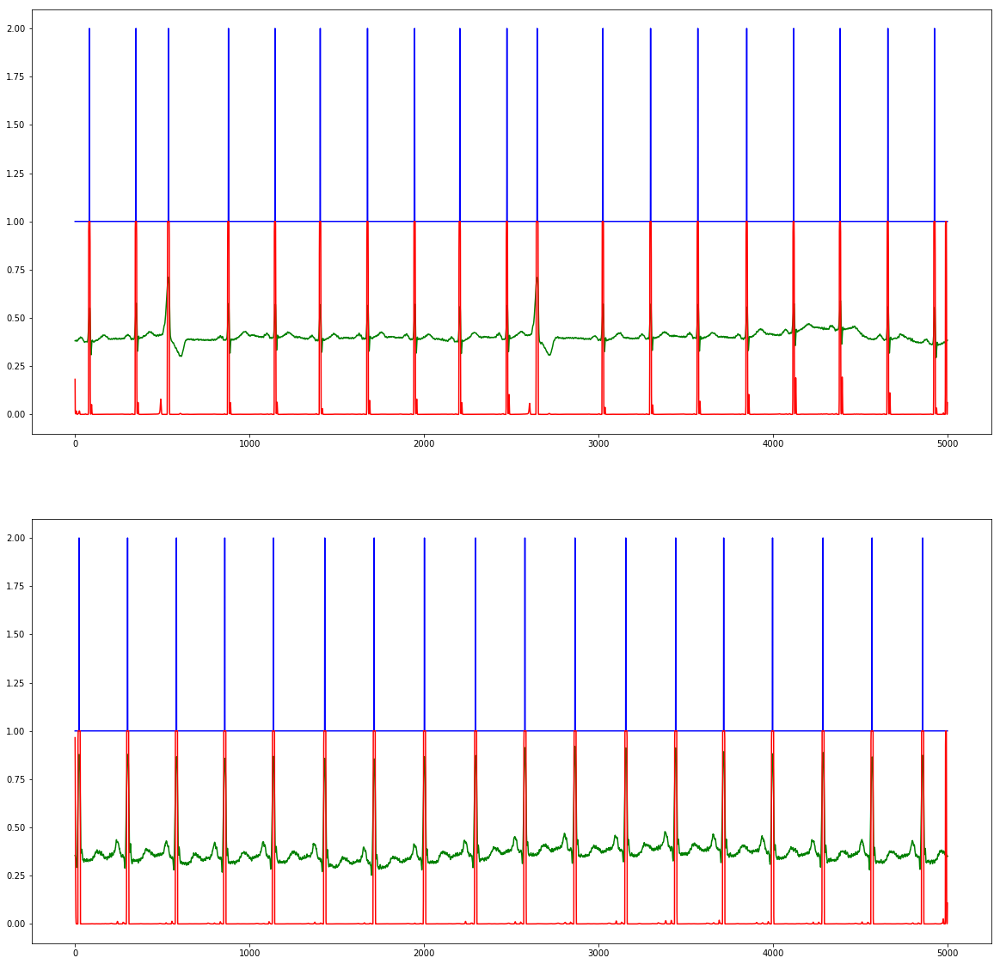

Epoch 100/100 running...Done in 4.618s!
  - training loss:		0.100354
  - test loss:			0.128167
  - test accuracy:		99.6389 %


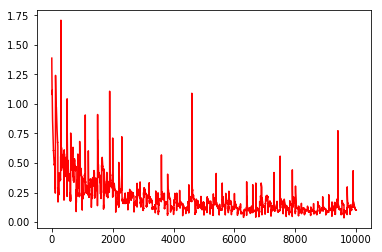

[[[ 0.11095545  0.00669549  0.00121068 ...,  0.00066149  0.00257081
    0.06527361]]]
[[[  9.99997139e-01   9.99996424e-01   9.99991536e-01 ...,   8.43519590e-13
     6.44860576e-13   3.50069583e-12]]]


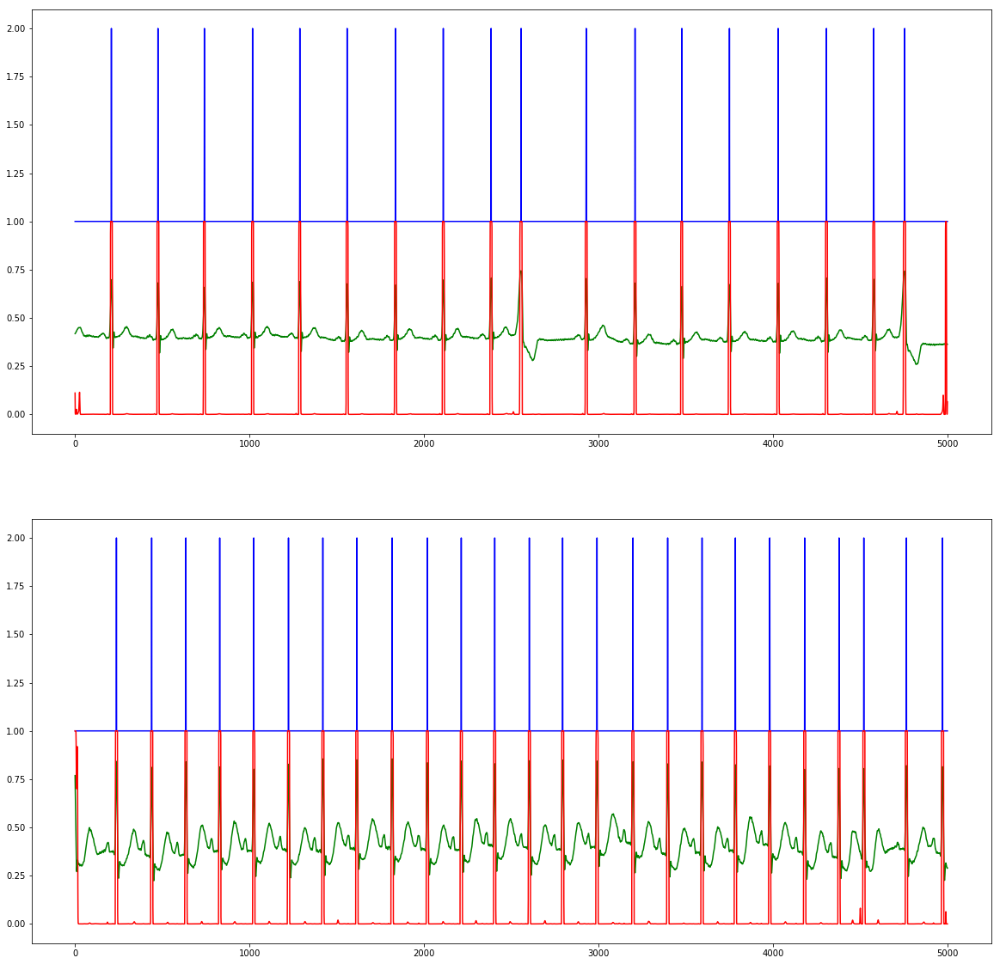

NameError: name 'get_all_param_values' is not defined

In [18]:
from theano import tensor, function, config
from theano.tensor import basic
from lasagne.updates import adam, nesterov_momentum
from lasagne.layers import InputLayer, DenseLayer, Conv1DLayer, Conv2DLayer, MaxPool1DLayer, MaxPool2DLayer, DropoutLayer, get_output, get_all_params, set_all_param_values, get_output_shape, ConcatLayer, ReshapeLayer
from lasagne.nonlinearities import sigmoid, rectify
from lasagne.init import GlorotUniform
from theano.printing import Print

# config.exception_verbosity='high'
# config.optimizer='fast_compile'
# config.optimizer='None'

def sa(v, a1=1, a2=2):
    return numpy.swapaxes(v, a1, a2)

def get_batch_gen(XY, batchsize, shuffle=False):
    X, Y, N = XY[:,0], XY[:,1], XY.shape[0]
    if shuffle:
        indices = numpy.arange(len(X))
        numpy.random.shuffle(indices)
    for start_idx in range(0, len(X) - batchsize + 1, batchsize):
        if shuffle:
            excerpt = indices[start_idx:start_idx + batchsize]
        else:
            excerpt = slice(start_idx, start_idx + batchsize)
#         yield X[excerpt], Y[excerpt]
        yield sa(X[excerpt]), sa(Y[excerpt])

def get_batch(XY, batchsize, shuffle):
    for x, y in get_batch_gen(XY, batchsize, shuffle=shuffle):
        return x, y
        
def build_model(input_tensor, dim, shape=None):
    l_in = InputLayer(shape, input_var=input_tensor)
    
    c1 = Conv1DLayer(l_in, num_filters=8, filter_size=(3), nonlinearity=rectify, W=GlorotUniform(), pad='same')
    print('c1:', get_output_shape(c1))
    c2 = Conv1DLayer(l_in, num_filters=64, filter_size=(15), nonlinearity=rectify, W=GlorotUniform(), pad='same')
    print('c2:', get_output_shape(c2))
    c3 = Conv1DLayer(l_in, num_filters=64, filter_size=(45), nonlinearity=rectify, W=GlorotUniform(), pad='same')
    print('c3:', get_output_shape(c3))
    c4 = Conv1DLayer(l_in, num_filters=256, filter_size=(89), nonlinearity=rectify, W=GlorotUniform(), pad='same')
    print('c3:', get_output_shape(c4))    
    cl = ConcatLayer([c1, c2, c3, c4], axis=1)
    print('cl:', get_output_shape(cl))
    
#     rl = ReshapeLayer(cl, shape=([0], 1, [1], [2]))
#     print('rl:', get_output_shape(rl))
    c2d = Conv1DLayer(cl, num_filters=50, filter_size=89, nonlinearity=rectify, W=GlorotUniform(), pad='same')
    print('c2d:', get_output_shape(c2d))
    
#     mp2d = MaxPool2DLayer(c2d, pool_size=9, pad=(0, 2))
#     print('mp2d:', get_output_shape(mp2d))
    
    model = Conv1DLayer(cl, num_filters=1, filter_size=89, nonlinearity=sigmoid, W=GlorotUniform(), pad='same')
#     model = DenseLayer(c2d, num_units=5000, nonlinearity=sigmoid)
    print('out:', get_output_shape(model))
#     model = DenseLayer(c2d, num_units=1000, nonlinearity=rectify)
#     print('Dense(1000)', get_output_shape(model))
#     model = DropoutLayer(model, p=0.5)
#     print('Dropout(0.5)', get_output_shape(model))
#     model = DenseLayer(model, num_units=500, nonlinearity=rectify)
#     print('Dsense(500)', get_output_shape(model))
#     model = DenseLayer(model, num_units=dim, nonlinearity=sigmoid)
#     print('Dense(1)', get_output_shape(model))
    return model

def my_loss(predictions, targets):
    pp = predictions
    tt = targets
#     pp = Print('preds')(predictions)
#     tt = Print('targs')(targets)
    return  tensor.abs_(tensor.log((targets * pp).sum() / tt.sum())) +\
            tensor.abs_(tensor.log(((1-targets) * (1-predictions)).sum() / (1-targets).sum()))


def plot_examples(eval_fun, nb=2):
    exs = numpy.random.randint(len(testXY), size=nb).tolist()
    fig, ax = plt.subplots(len(exs), figsize=(20, 20))
    for i, ex_id in enumerate(exs):
        res = eval_fun(numpy.asarray([sa(testXY[ex_id, 0], 0, 1)]))
        print(res)
        ax[i].plot(testXY[ex_id, 1]+1, color='blue')
        ax[i].plot(res[0][0], color='red')
        ax[i].plot(testXY[ex_id, 0], color='green')
        
    plt.show()

    
class NN:
    def __init__(self, dim=1):
        self.t_in = tensor.ftensor3('inputs')  #  =X     float64
        self.t_out = tensor.imatrix('targets') # =Y_true int32
        self.input_shape = (None, dim, segment_size,)
        self.output_shape  = (None, dim, segment_size,)
        self.model = build_model(self.t_in, dim=dim, shape=self.input_shape)
        
        test_pred = get_output(self.model, deterministic=True)
        test_loss = my_loss(test_pred, self.t_out)
        test_acc  = tensor.mean(tensor.eq(tensor.argmax(test_pred, axis=1), self.t_out), dtype=config.floatX)
        test_

        self.eval_fn  = function([self.t_in, self.t_out], [test_loss, test_acc], allow_input_downcast=True)
        self.evaluate = function([self.t_in], get_output(self.model, self.t_in), allow_input_downcast=True)
    
    def train(self, trainXY, testXY, batch_size, num_epochs, examples_by_epoch, stop_accuracy=100.0, info=False):
        trainN, testN = trainXY.shape[0], testXY.shape[0]
        print('Training on {} examples, testing on {} examples.'.format(trainN, testN))
        print("Starting training...")
        
        pred = get_output(self.model)
        loss = my_loss(pred, self.t_out)
        params = get_all_params(self.model, trainable=True)
        updates = adam(loss, params=params, learning_rate=0.001)
#         t_in_p = Print('t_in')(self.t_in)
#         t_out_p = Print('t_out')(self.t_out)
        train_fn = function([self.t_in, self.t_out], loss, updates=updates, allow_input_downcast=True)
        
        examples_used = 0
        train_losses = []
        rps = []
        for epoch in range(1, num_epochs+1):
            start_time = time.time()
            print('Epoch {}/{} running...'.format(epoch, num_epochs), end='')
            train_loss = 0
            xs, ys = get_batch(trainXY, examples_by_epoch, shuffle=True)
            for z in range(examples_by_epoch):
                x, y = numpy.asarray([xs[z]]), ys[z]
#                 print(x.shape, y.shape)
                train_loss += train_fn(x, y)
                train_losses.append(train_loss/(z+1))
                examples_used += 1
            print('Done in {:.3f}s!'.format(time.time() - start_time))
            print("  - training loss:\t\t{:.6f}".format(train_loss / examples_by_epoch))
            
            # Eval on examples:
            test_loss = 0
            test_acc = 0
            for k in range(testN):
                x, y = testXY[k,0], testXY[k,1]
#                 print(x.shape, y.shape)
                tmp_loss, tmp_acc = self.eval_fn(numpy.asarray([sa(x, 0, 1)]), sa(y, 0, 1))
                test_loss += tmp_loss
                test_acc  += tmp_acc
            print("  - test loss:\t\t\t{:.6f}".format(test_loss / testN))
            acc = test_acc / testN * 100
            print("  - test accuracy:\t\t{:.4f} %".format(acc))
            plt.plot(train_losses, color='r')
            plt.plot(rps, color='g')
            plt.show()
            plot_examples(self.evaluate)
            if acc > stop_accuracy:
                break
        self.save_model('model-{}.sav'.format(acc))
        
    def save_model(self, model_path):
        numpy.savez(model_path, *get_all_param_values(self.model))

    def load_model(self, model_path):
        with numpy.load(model_path) as f:
            param_values = [f['arr_%d' % i] for i in range(len(f.files))]
        set_all_param_values(self.model, param_values)
        

nn = NN()
nn.train(trainXY, testXY, batch_size=4, num_epochs=100, examples_by_epoch=100, info=True)

In [21]:
from keras import backend as K
from theano.tensor import basic as tensor
_EPSILON = 10e-8
import tensorflow as tf
from keras.backend.tensorflow_backend import _to_tensor
from tensorflow.python.framework import ops
from tensorflow.python.ops import math_ops as mo
from tensorflow.python.ops import nn_ops
from tensorflow.python.ops import nn
from sklearn.metrics import f1_score
    
    
def rp(y_true, y_pred):
    # Rpeaks
    return K.sum(y_pred)/K.sum(y_true)

def se(y_true, y_pred):
    # Sensibility, recall, TPR
    TP = mo.reduce_sum(mo.multiply(y_true, y_pred))
    RP = mo.reduce_sum(y_true)
    return TP/RP

def sp(y_true, y_pred):
    # Specificity, TNR
    TN = mo.reduce_sum(mo.multiply(1-y_true, 1-y_pred))
    RN = mo.reduce_sum(1-y_true)
    return TN/RN    

def mmc(y_true, y_pred):
    # Matthews correlation coefficient
    TP = mo.reduce_sum(mo.multiply(y_true, y_pred))        # Correctly predicted as positive
    TN = mo.reduce_sum(mo.multiply(1-y_true, 1-y_pred))    # Correctly predicted as negative
    FP = mo.reduce_sum(mo.multiply(1-y_true, y_pred))      # Falsely predicted as positive
    FN = mo.reduce_sum(mo.multiply(y_true, 1-y_pred))      # Falsely predicted as negative
    return (TP*TN - FP*FN) / K.sqrt((TP+FP)*(TP+FN)*(TN+FP)*(TN+FN))

def my_loss(targets, logits, name=None):
    with ops.name_scope(name, "logistic_loss", [logits, targets]) as name:
        logits = ops.convert_to_tensor(logits, name="logits")
        targets = ops.convert_to_tensor(targets, name="targets")
        try:
            targets.get_shape().merge_with(logits.get_shape())
        except ValueError:
            raise ValueError("logits and targets must have the same shape (%s vs %s)"
                           % (logits.get_shape(), targets.get_shape()))
        #return math_ops.add(ratio_zero_one*(1-logits)*targets, (1-targets)*logits, name=name)
        loss_tp = mo.abs(mo.log(mo.div(
                    mo.reduce_sum(mo.multiply(targets, logits)),
                    mo.reduce_sum(targets))))
        loss_tn = mo.abs(mo.log(mo.div(
                    mo.reduce_sum(mo.multiply((1-targets), (1-logits))),
                    mo.reduce_sum((1-targets)))))
        return mo.add(loss_tp, loss_tn)
    
def my_loss2(targets, logits, name=None):
    with ops.name_scope(name, "logistic_loss", [logits, targets]) as name:
        logits = ops.convert_to_tensor(logits, name="logits")
        targets = ops.convert_to_tensor(targets, name="targets")
        try:
            targets.get_shape().merge_with(logits.get_shape())
        except ValueError:
            raise ValueError("logits and targets must have the same shape (%s vs %s)"
                           % (logits.get_shape(), targets.get_shape()))
        #return math_ops.add(ratio_zero_one*(1-logits)*targets, (1-targets)*logits, name=name)
        TP = mo.reduce_sum(mo.multiply(targets, logits))     # Correctly predicted as positive
        TN = mo.reduce_sum(mo.multiply(1-targets, 1-logits)) # Correctly predicted as negative
        FP = mo.reduce_sum(mo.multiply(1-targets, logits))      # Falsely predicted as positive
        FN = mo.reduce_sum(mo.multiply(targets, 1-logits))      # Falsely predicted as negative
        
        PP = mo.add(TP, FP)
        
        RP = mo.reduce_sum(targets) # Number of real positives
        RN = mo.reduce_sum(1-targets) # Number of real negatives
        
        loss_tp = mo.abs(mo.log(mo.div(TP, RP)))
        loss_tn = mo.abs(mo.log(mo.div(TN, RN)))
        loss_fp = mo.log(mo.div(FP, RP)+1)
        loss_fn = mo.log(mo.div(FN, RN)+1)/4
        
        # Grandement pénaliser si il ne prédit pas de positifs
        loss_nb_p = mo.abs(mo.log(mo.div(PP, RP)))*4
        
#         return mo.add(loss_nb_p, mo.add(mo.add(mo.add(loss_tp, loss_tn), loss_fp), loss_fn))
        return mo.add(loss_tp, loss_tn)

def mmc_loss(targets, logits, name=None):
    with ops.name_scope(name, "logistic_loss", [logits, targets]) as name:
        logits = ops.convert_to_tensor(logits, name="logits")
        targets = ops.convert_to_tensor(targets, name="targets")
        try:
            targets.get_shape().merge_with(logits.get_shape())
        except ValueError:
            raise ValueError("logits and targets must have the same shape (%s vs %s)"
                           % (logits.get_shape(), targets.get_shape()))
        return mo.exp(1-mmc(y_true=targets, y_pred=logits))

def my_ce(y_true, y_pred):
    return K.mean(nn.weighted_cross_entropy_with_logits(targets=y_true, logits=y_pred, pos_weight=ratio_zero_one), axis=-1)

# model1 = Sequential()
# model1.add(LSTM(units=512, input_shape=(segment_size, 1), return_sequences=True))
# model1.add(Dense(1, activation='sigmoid'))
# model1.compile(loss=my_loss, optimizer='adam', metrics=['accuracy', Rpeaks_metric])


# model2 = Sequential()
# model2.add(LSTM(units=1024, input_shape=(segment_size, 1), return_sequences=True))
# model2.add(Dense(100))
# model2.add(Dense(1, activation='sigmoid'))
# model2.compile(loss=my_loss, optimizer='adam', metrics=['accuracy', Rpeaks_metric])

# model3 = Sequential()
# model3.add(LSTM(units=256, input_shape=(segment_size, 1), return_sequences=True))
# model3.add(Dense(1, activation='sigmoid'))
# model3.compile(loss=my_loss, optimizer='adam', metrics=['accuracy', rpeaks])

# model4 = Sequential()
# model4.add(LSTM(units=2048, input_shape=(segment_size, 1), return_sequences=True))
# model4.add(Dense(1, activation='sigmoid'))
# model4.compile(loss=my_loss, optimizer='adam', metrics=['accuracy', rpeaks])

# model5 = Sequential()
# model5.add(Conv1D(128, 10, padding='valid', activation='relu', strides=1, input_shape=(segment_size, 1)))
# model5.add(MaxPooling1D(pool_size=8))
# model5.add(LSTM(256, return_sequences=True))
# model5.add(Dense(1, activation='sigmoid'))
# model5.compile(loss=my_loss, optimizer='adam', metrics=['accuracy', rpeaks])

# model6 = Sequential()
# model6.add(Dense(3000, input_shape=(segment_size, 1)))
# model6.add(Conv1D(256, 5, padding='same'))
# model6.add(Dense(500))
# model6.add(Dense(1, activation='sigmoid'))
# model6.compile(loss=my_loss, optimizer='adam', metrics=['accuracy', se, sp, mmc, rpeaks])

mdl_name = "dense3000-conv1d256-dense500-dense1"
model7 = Sequential()
model7.add(Dense(3000, input_shape=(segment_size, 1)))
model7.add(Conv1D(256, 5, padding='same'))
model7.add(Dense(500))
model7.add(Dense(1, activation='sigmoid'))
model7.compile(loss=my_loss, optimizer='adam', metrics=['accuracy', se, sp, mmc, rp])

# SVG(model_to_dot(model).create(prog='dot', format='svg'))

INFO:tensorflow:Summary name dense_19/kernel:0 is illegal; using dense_19/kernel_0 instead.
INFO:tensorflow:Summary name dense_19/kernel:0 is illegal; using dense_19/kernel_0 instead.
INFO:tensorflow:Summary name dense_19/bias:0 is illegal; using dense_19/bias_0 instead.
INFO:tensorflow:Summary name dense_19/bias:0 is illegal; using dense_19/bias_0 instead.
INFO:tensorflow:Summary name conv1d_7/kernel:0 is illegal; using conv1d_7/kernel_0 instead.
INFO:tensorflow:Summary name conv1d_7/kernel:0 is illegal; using conv1d_7/kernel_0 instead.
INFO:tensorflow:Summary name conv1d_7/bias:0 is illegal; using conv1d_7/bias_0 instead.
INFO:tensorflow:Summary name conv1d_7/bias:0 is illegal; using conv1d_7/bias_0 instead.
INFO:tensorflow:Summary name dense_20/kernel:0 is illegal; using dense_20/kernel_0 instead.
INFO:tensorflow:Summary name dense_20/kernel:0 is illegal; using dense_20/kernel_0 instead.
INFO:tensorflow:Summary name dense_20/bias:0 is illegal; using dense_20/bias_0 instead.
INFO:ten

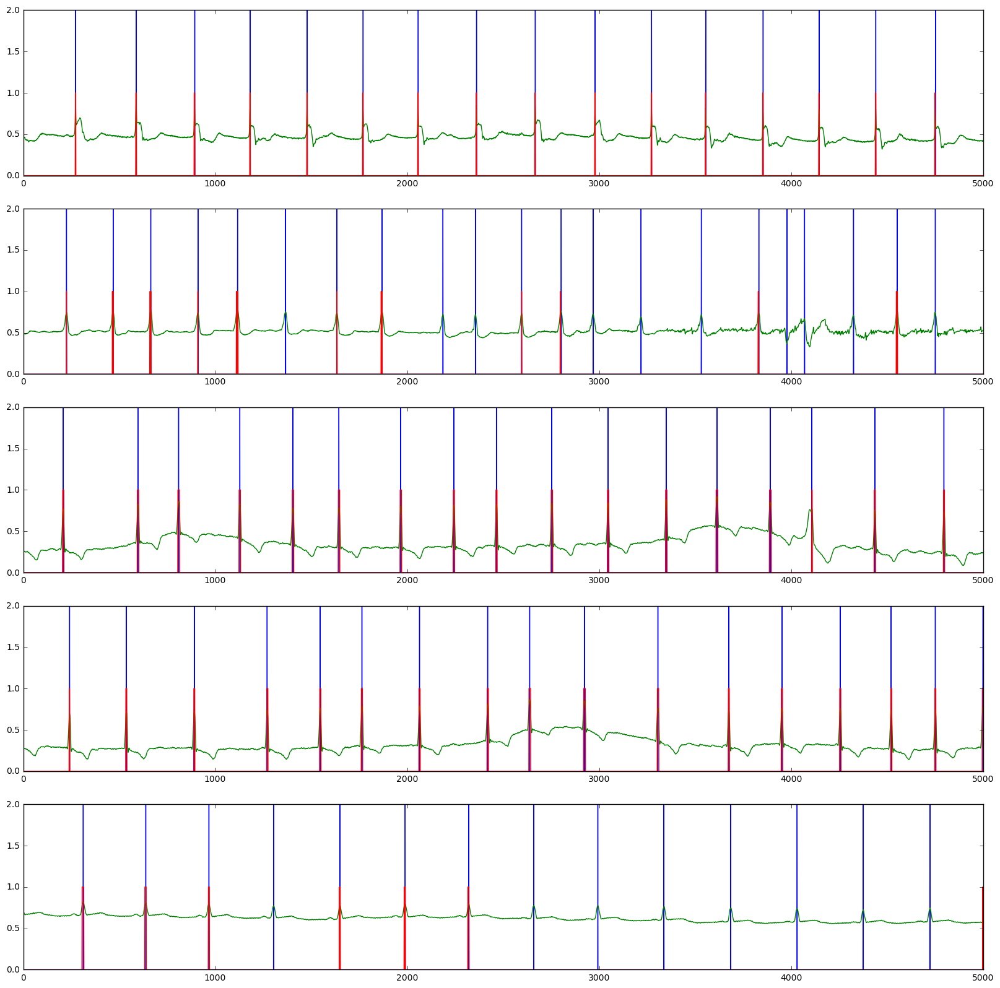

Epoch 94/5000
2/2 [==============================] - 0s


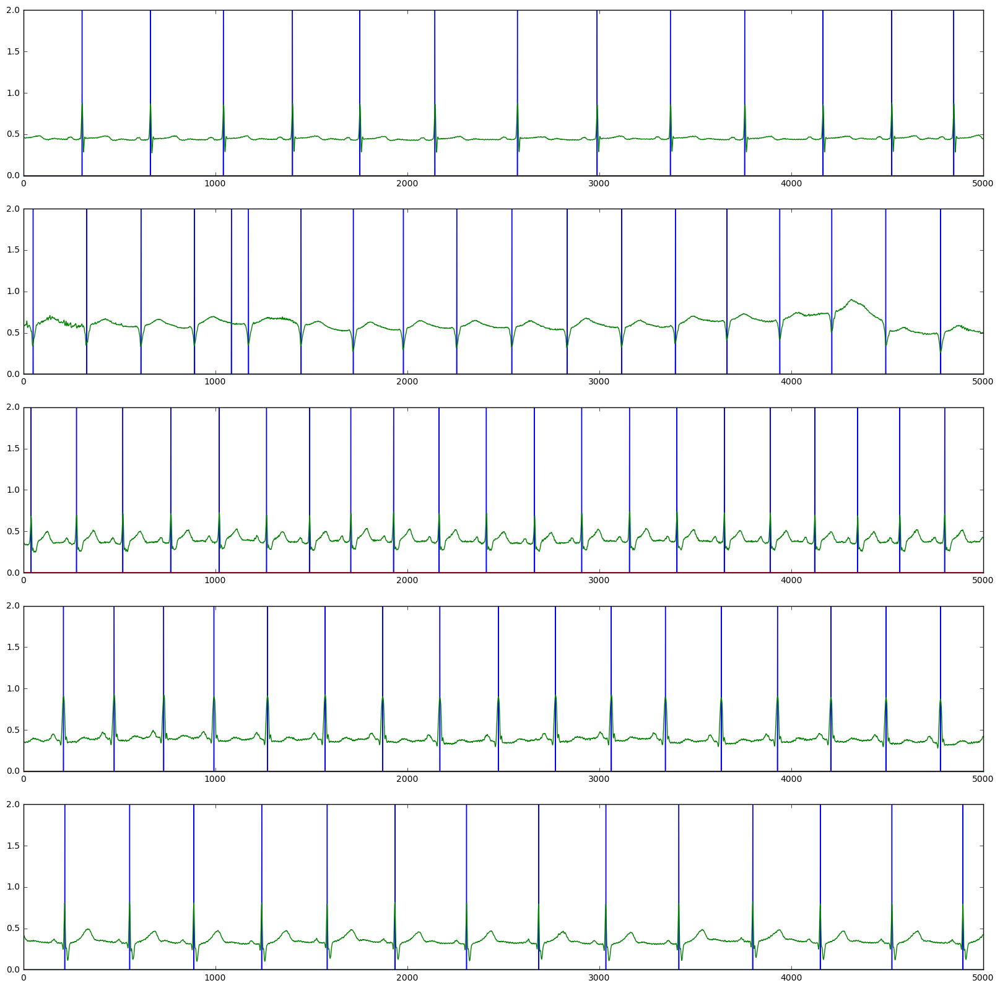

Epoch 95/5000
2/2 [==============================] - 0s


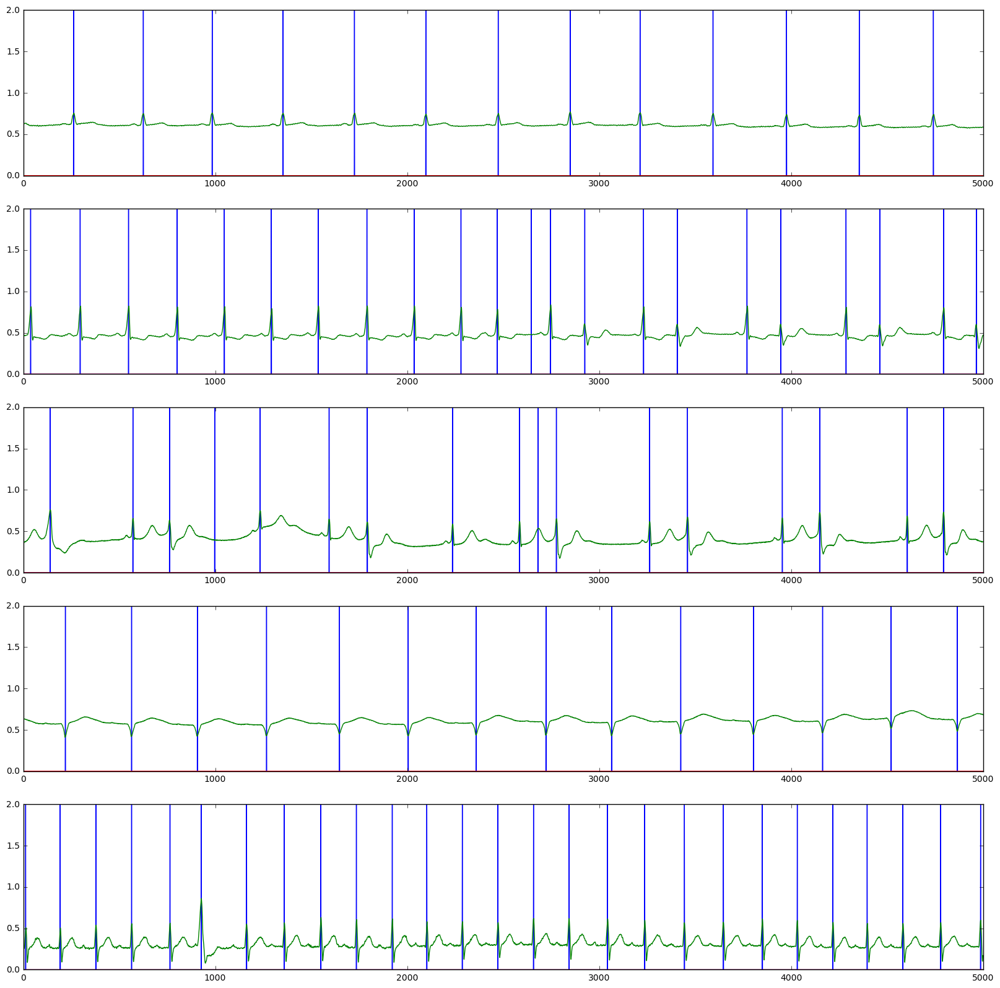

Epoch 96/5000
2/2 [==============================] - 0s


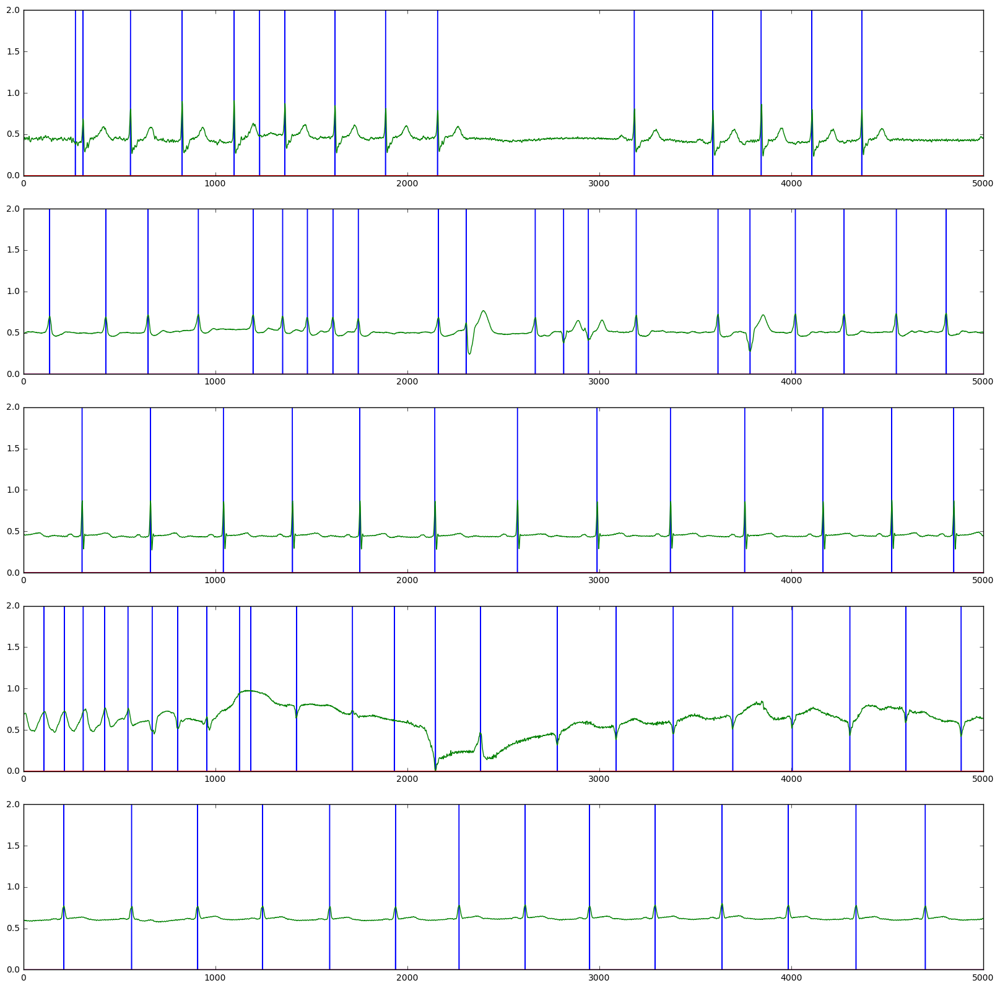

Epoch 97/5000
2/2 [==============================] - 0s


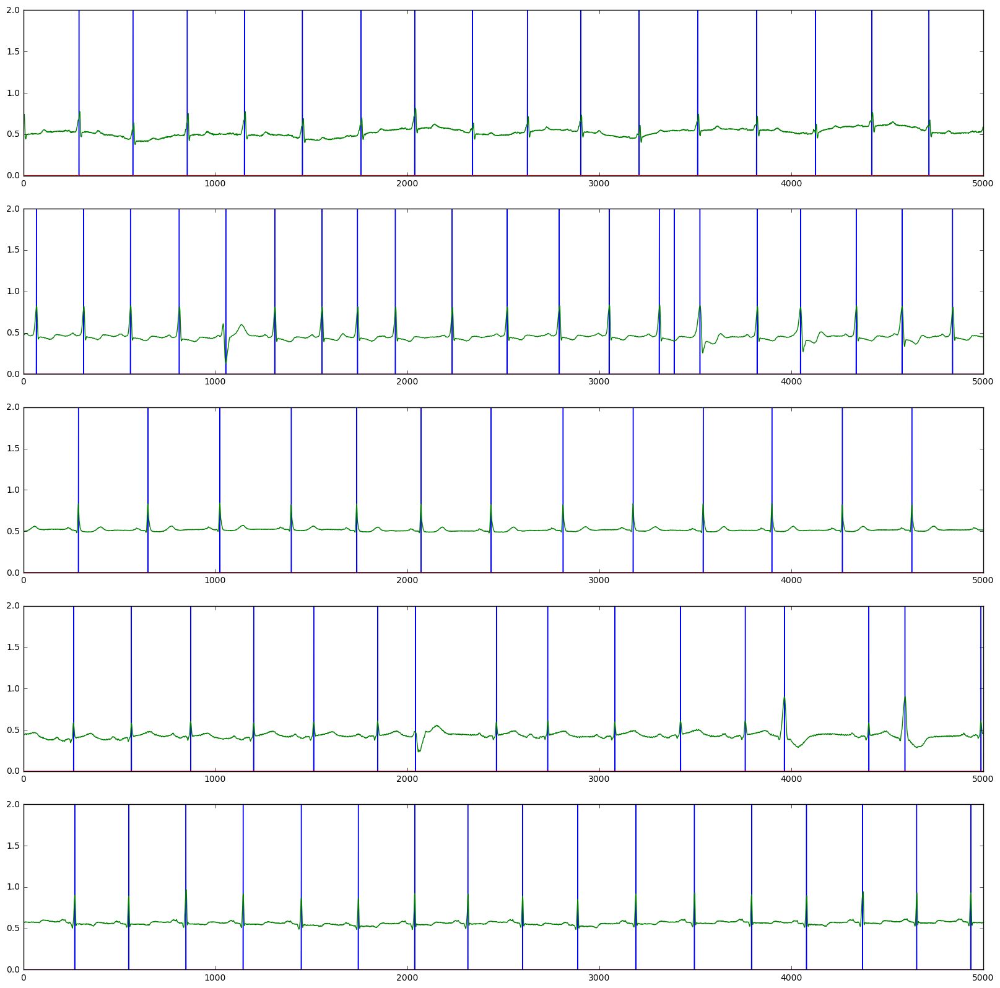

Epoch 98/5000
2/2 [==============================] - 0s


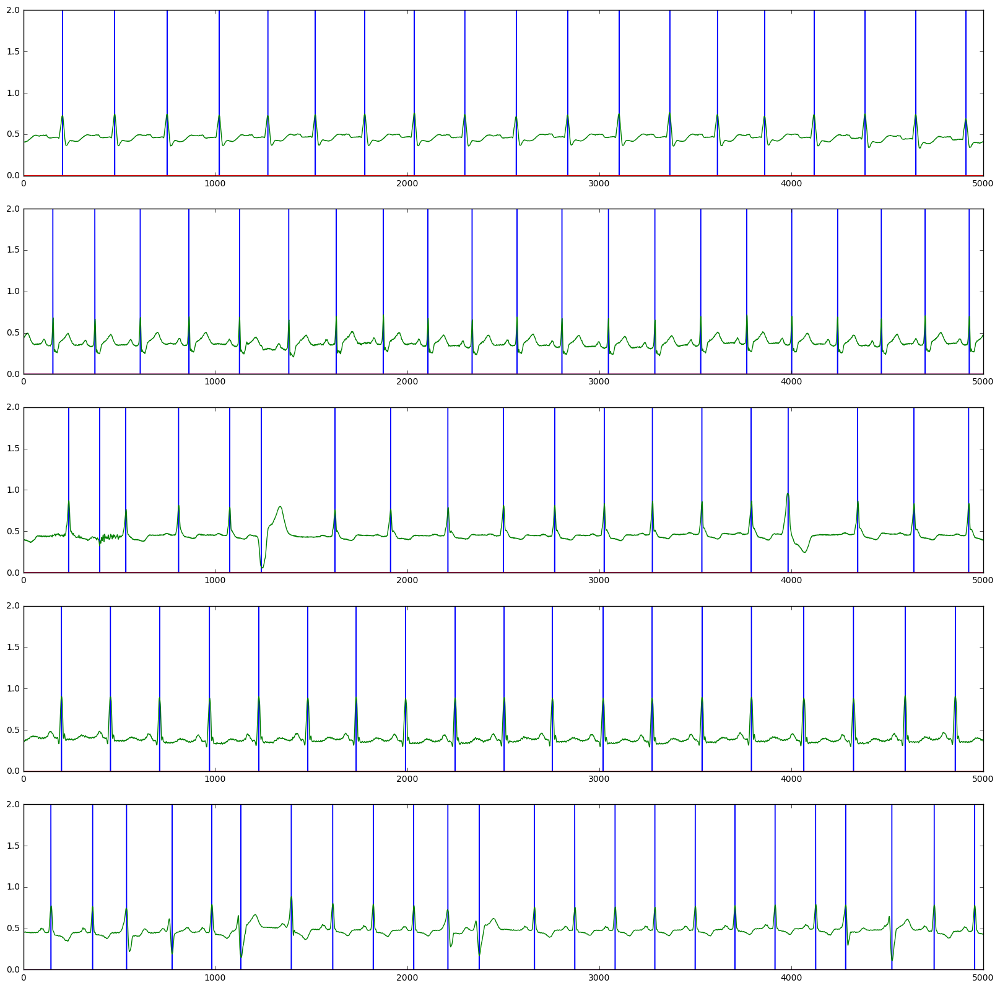

Epoch 99/5000
2/2 [==============================] - 0s


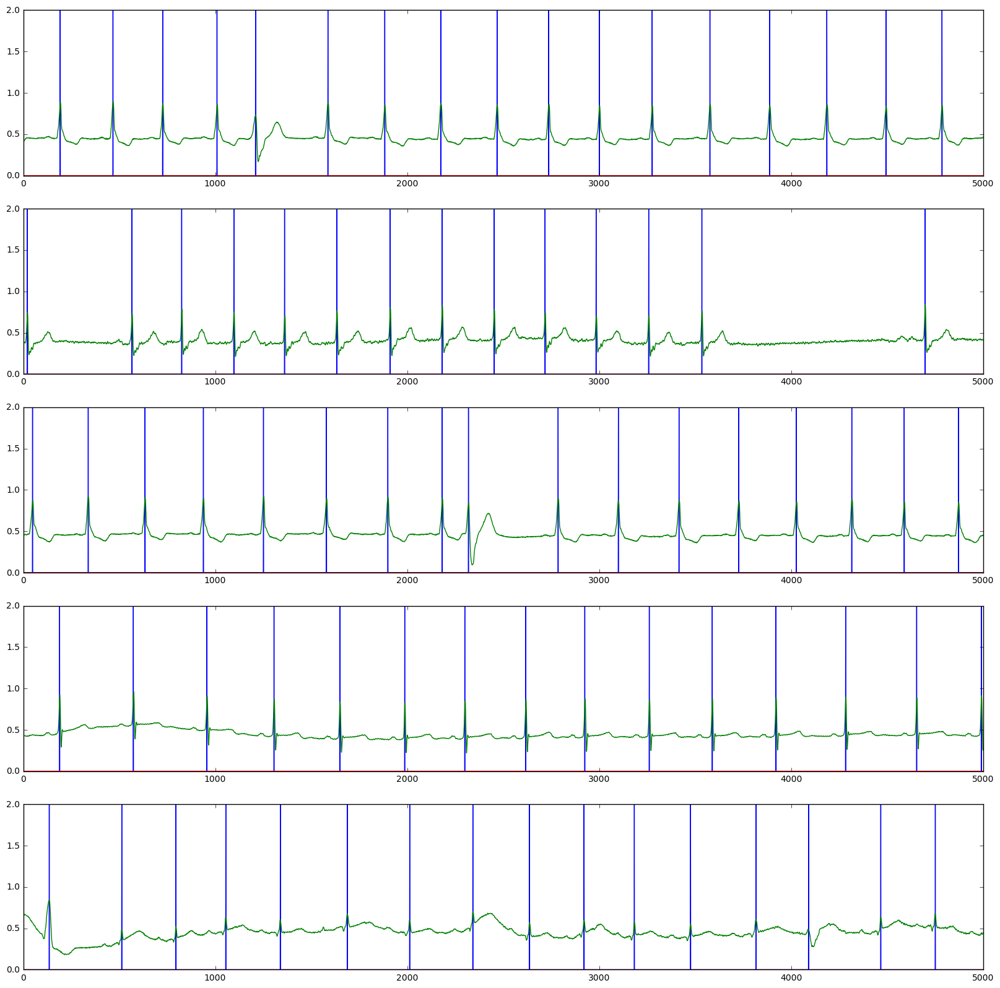

Epoch 100/5000
2/2 [==============================] - 0s


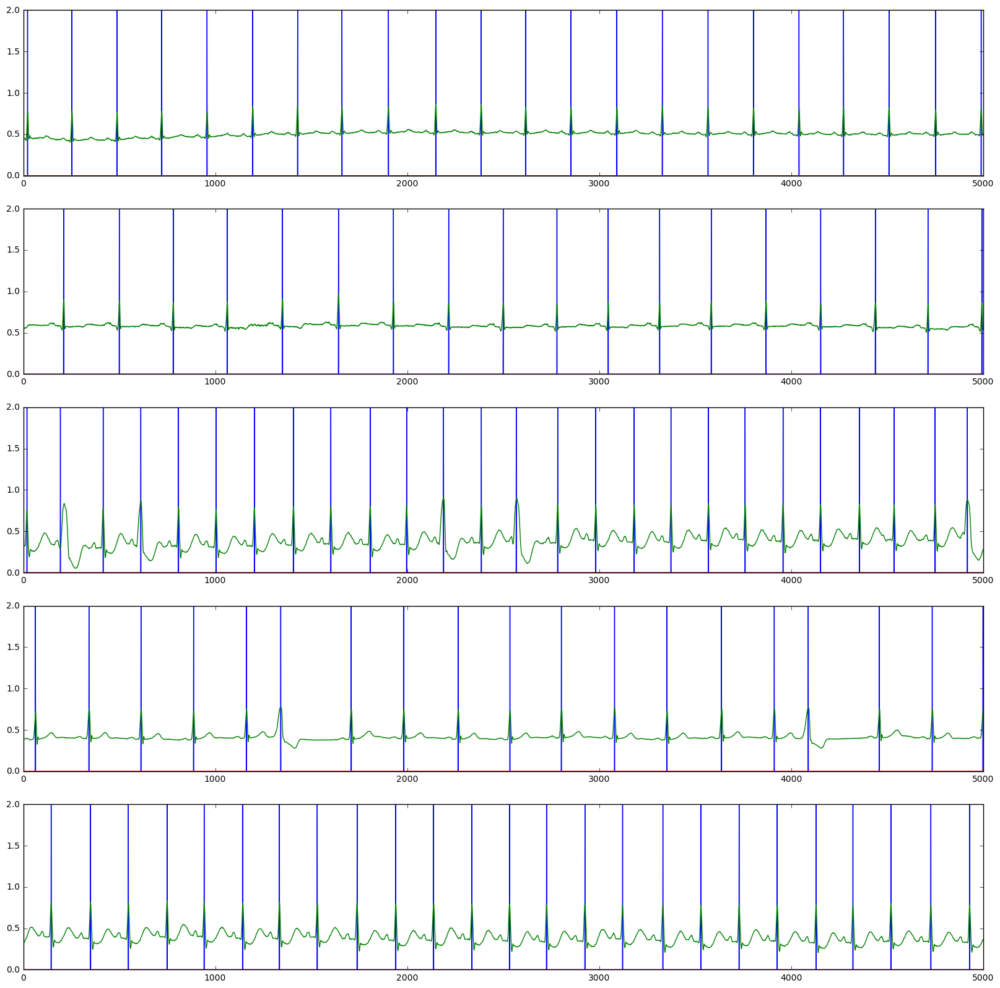

Epoch 101/5000
2/2 [==============================] - 0s


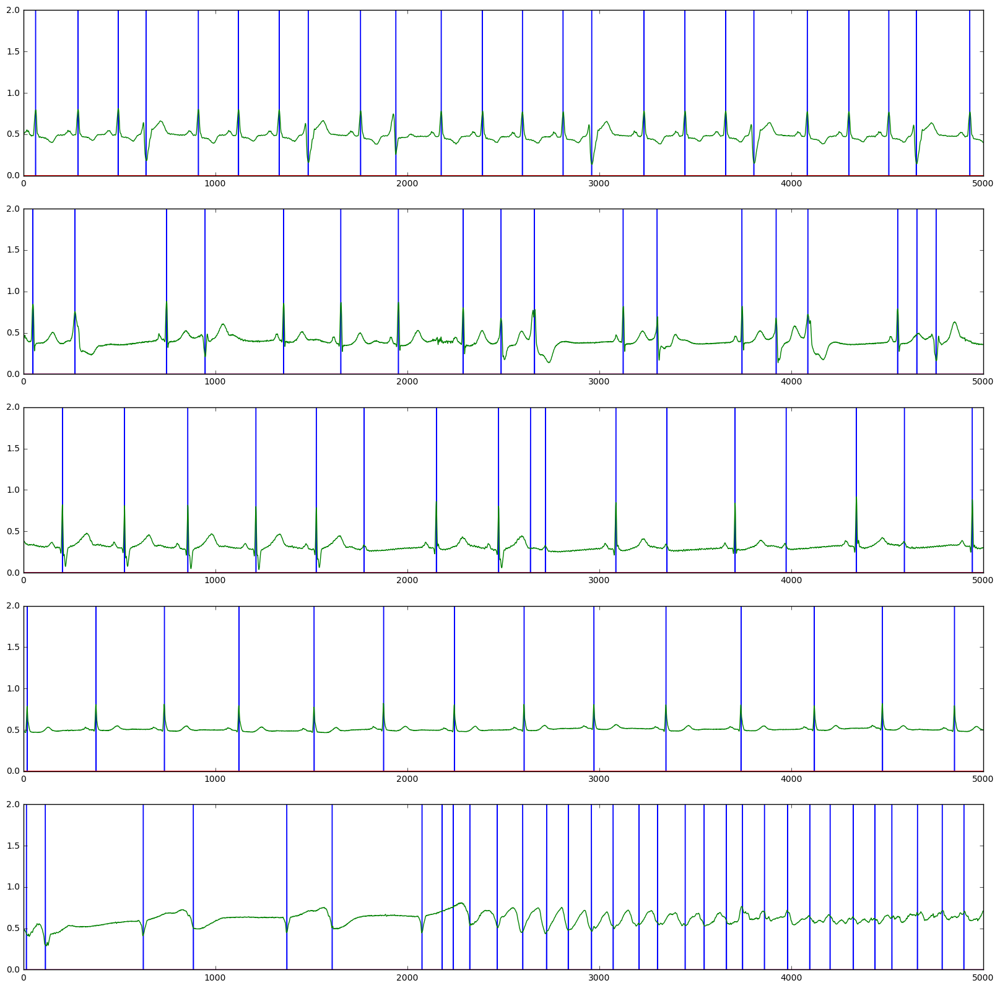

Epoch 102/5000
2/2 [==============================] - 0s


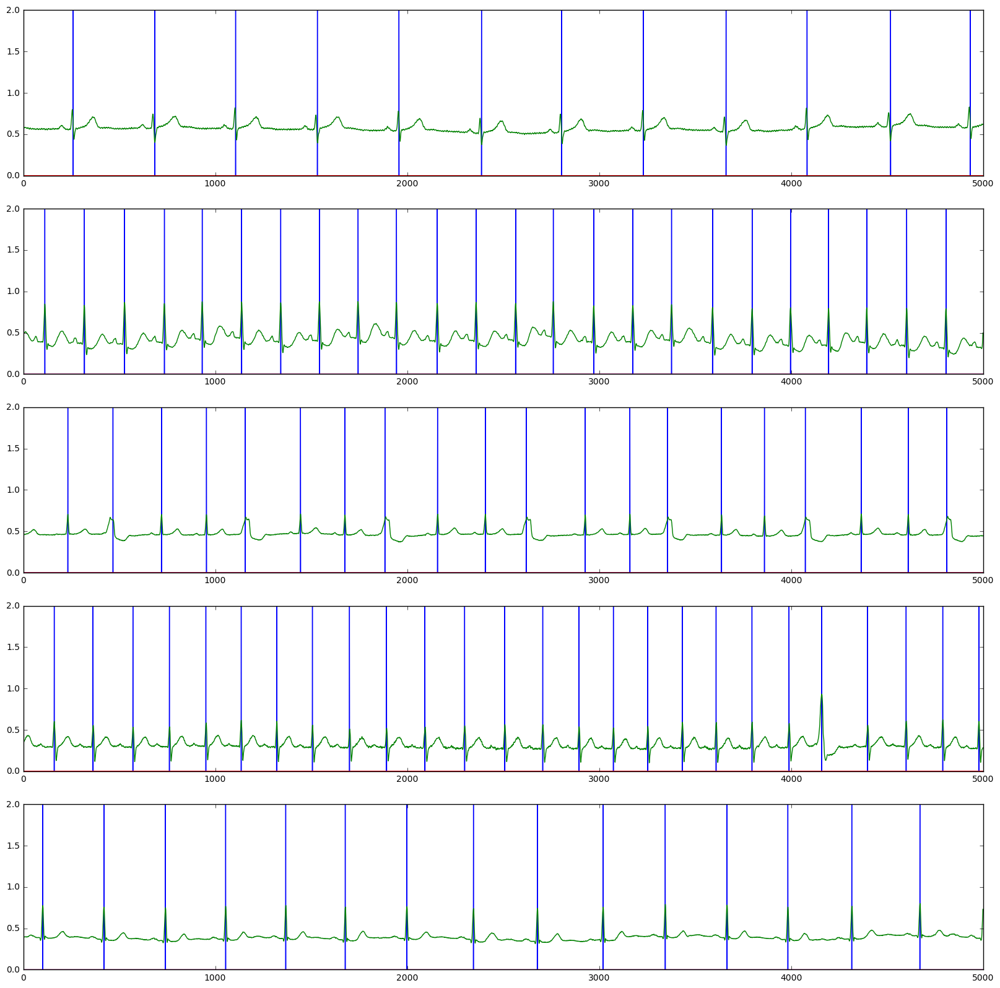

Epoch 103/5000
2/2 [==============================] - 0s


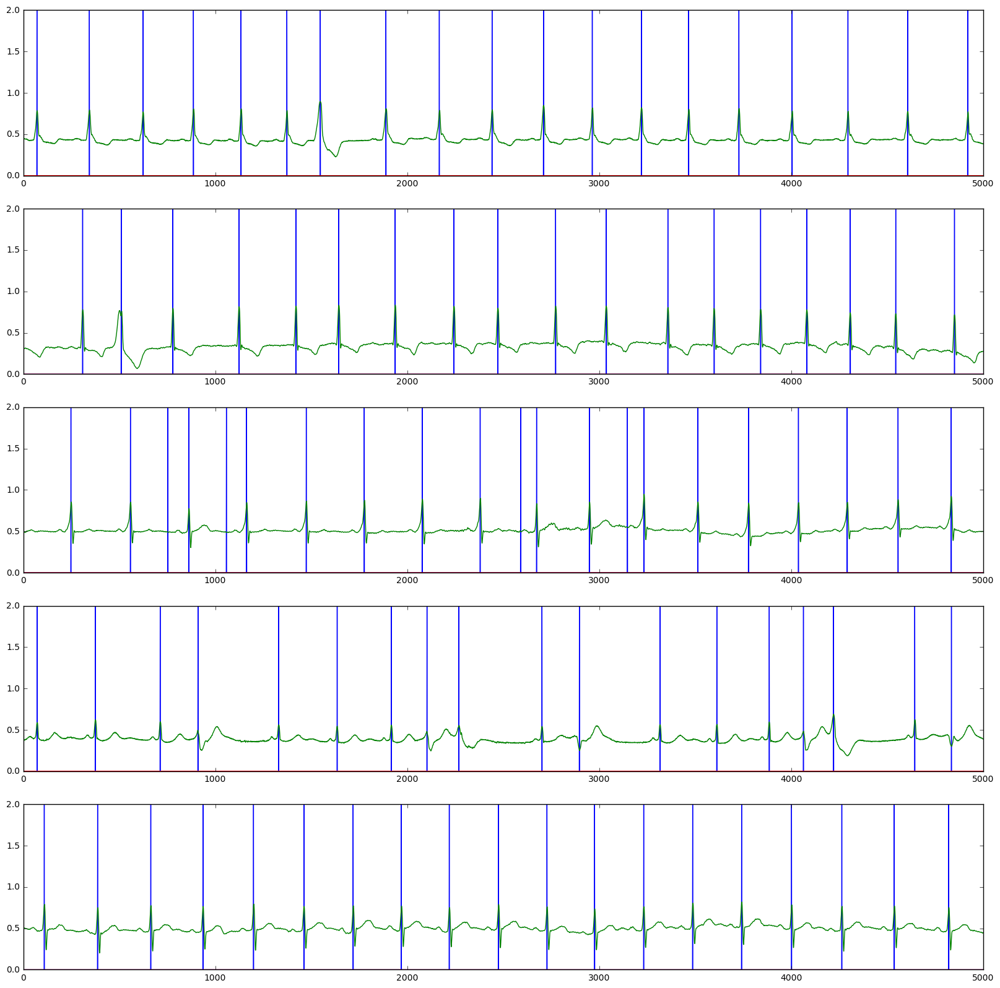

Epoch 104/5000
 145/2000 [=>............................] - ETA: 182s - loss: nan - acc: 0.0000e+00 - se: nan - sp: nan - mmc: nan - rp: nan

KeyboardInterrupt: 

In [22]:
# del model
model = model7

model_load = 'logs/' + mdl_name + '/weights.92-0.21-0.92.hdf5'
model_epoch = 92
model.load_weights(model_load)

samples_used = 0
def gen_samples(XY):
    while True:
        print('CALLED')
        for i in range(XY.shape[0]):
            # samples_used += 
            yield (numpy.asarray([XY[i,0]]), numpy.asarray([XY[i,1]]))
            

def plot_callback():
    exs = numpy.random.randint(len(testXY), size=5).tolist()
    fig, ax = plt.subplots(len(exs), figsize=(20, 20))
    for i, ex_id in enumerate(exs):
        res = [e[0] for e in model.predict_classes(testXY[ex_id]).tolist()[0]]
        ax[i].plot(testXY[ex_id, 1]*2, color='blue')
        ax[i].plot(testXY[ex_id, 0], color='green')
        ax[i].plot(res, color='red')
    plt.show()

mkdir_p('logs/' + mdl_name)
tbCallBack = TensorBoard(log_dir='./logs/{}'.format(mdl_name), histogram_freq=1, write_graph=True, write_images=True)
plotClbk = LambdaCallback(on_epoch_begin=lambda epoch, logs: plot_callback())
ckpt = ModelCheckpoint('logs/' + mdl_name + '/' + 'weights.{epoch:02d}-{loss:.2f}-{acc:.2f}.hdf5', monitor='loss', verbose=1)

history = model.fit_generator(gen_samples(trainXY),
                              steps_per_epoch=2000,
                              epochs=5000,
                              verbose=1,
                              callbacks=[tbCallBack, plotClbk, ckpt],
                              initial_epoch=93)